In [1]:
from rdkit import Chem
import pandas as pd
import numpy as np

from rdkit.Chem import AllChem

from rdkit.Chem import PandasTools

import pickle 

from tqdm import tqdm
import torch

## 1. Load our processed data.

In [3]:
chembl_df = torch.load('../data/chembl/chembl_processed.pt')

In [4]:
chembl_df.head()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic
0,CHEMBL6354,12.205,20,Nc1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5ccccc5...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,2,1,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1
1,CHEMBL6354,12.807,21,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc([NH-])...,1,0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2
2,CHEMBL429017,12.205,16,Nc1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccccc54...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,2,1,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1
3,CHEMBL429017,12.807,17,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc([NH-])c...,1,0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2
4,CHEMBL6361,12.205,20,Nc1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5cccc...,[NH-]c1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5...,2,1,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1


In [5]:
chembl_df.shape

(714906, 10)

## 2. Check the relationship between number of charges in protonated/deprotonated states on:
- recorded charges in columns "prot_charge" and "deprot_charge"
- molecular graphs for protonated and deprotonated

In [11]:
charge_idx = []
for idx, prot_charge, deprot_charge in zip(chembl_df.index, chembl_df['prot_charge'], chembl_df['deprot_charge']):
    
    if prot_charge > deprot_charge:
        continue 
    charge_idx.append(idx)

In [12]:
from rdkit.Chem.rdmolops import GetFormalCharge
mol_idx = []
for idx, prot_mol, deprot_mol in zip(chembl_df.index, chembl_df['prot_mol'], chembl_df['deprot_mol']):
    
    if GetFormalCharge(prot_mol) > GetFormalCharge(deprot_mol):
        continue 
    mol_idx.append(idx)

In [14]:
len(charge_idx), len(mol_idx)

(4412, 474)

In [13]:
len(set(charge_idx) & set(mol_idx))

0

There are 4412+474= 4886 entries for questioning. 

In [15]:
use_idx = [i for i in chembl_df.index if i not in charge_idx+mol_idx]

In [16]:
chembl_df1 = chembl_df.loc[use_idx, :]

In [18]:
chembl_df1.shape

(710020, 10)

## 3. Enumerate on SMARTS pattern for acids/basics

In [19]:
acid_base_smarts = pd.read_csv('../data/pka_smarts/smarts_pattern.tsv', delimiter='\t')

In [20]:
acid_base_smarts

,Substructure,SMARTS,Index,Acid_or_base
0,1,"[SX4:0](=[O:1])(=[O:2])([O:3]-[C,c,N,n:4])-[OX...",6,A
1,2,"[SX4:0](=[O:1])(=[O:2])(-[C,c,N,n:3])-[OX2:4]-...",5,A
2,3,[SX3:0](=[O:1])-[O:2]-[H:3],3,A
3,4,"[c,n,o:0]-[C:1](=[O:2])-[O:3]-[H:4]",4,A
4,5,[C:0](=[O:1])-[O:2]-[H:3],3,A
...,...,...,...,...
138,139,[nX2H0:0]:[nX2H0:1]:[c:2]:[nH1:3]:[c:4]:[c:5]:...,1,B
139,140,[NX2H0;r7:0]-[NX2H0;r7:1]=[C;r7:2]-[NH1;r7:3]-...,1,B
140,141,[NX3:0](-[C:1])(-[C:2])-[C:3]=[S:4],0,B
141,142,[c:0]:[nX2H0:1]:[nX2H0:2]:[nX2H0:3]:[nX3H0:4],1,B


In [25]:
from rdkit.Chem.MolStandardize import rdMolStandardize
un = rdMolStandardize.Uncharger()

from collections import defaultdict

from molvs import standardize_smiles

mol_acid_base = {}
for idx, center, prot_mol, deprot_mol in zip(range(chembl_df1.shape[0]), chembl_df1['center'], chembl_df1['prot_mol'], chembl_df1['deprot_mol']):
    prot_mol = un.uncharge(prot_mol)
    mol = Chem.AddHs(prot_mol)
    for pid, smart, a in zip(acid_base_smarts.index, acid_base_smarts['    SMARTS'], acid_base_smarts['Acid_or_base']):
        if mol.HasSubstructMatch(Chem.MolFromSmarts(smart)):
            matches = sum(mol.GetSubstructMatches(Chem.MolFromSmarts(smart)), ())
            #print(smart, matches)
            if center in matches:
                if deprot_mol.GetAtomWithIdx(center).GetFormalCharge() == -1: 
                    if a == 'A':
                        mol_acid_base[idx] = pid
                        break
                elif deprot_mol.GetAtomWithIdx(center).GetFormalCharge() == 0:
                    if a == 'B':
                        mol_acid_base[idx] = pid
                        break

[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Unch

[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17]

[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Running Uncharger
[13:25:17] Removed positive charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Removed negative charge.
[13:25:17] Running Uncharger
[13:25:17] Removed negative charge.
[13:25:17] Running Unchar

[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Running Uncharger
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Running Uncharger
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed

[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed negative charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positiv

[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:18] Removed positive charge.
[13:25:18] Running Uncharger
[13:25:18] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Removed 

[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed posit

[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Removed negative charge.
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Removed positive charge.
[13:25:19] Runnin

[13:25:19] Running Uncharger
[13:25:19] Removed negative charge.
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:19] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[

[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed positive charge.
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed positive charge.
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[1

[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:2

[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Removed negative charge.
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:20] Running Uncharger
[13:25:2

[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Runn

[13:25:21] Running Uncharger
[13:25:21] Removed positive charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed positive charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed positive charge.
[13:25:21] Running Uncharger
[13:25:21] Removed positive charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed positive charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed

[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Running Uncharger
[13:25:21] Removed negative charge.
[13:25:21] Removed posi

[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed positive charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed positive charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed positive charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed positive charge.
[13:25:22] Running Uncharger
[13:25:22] Removed positive charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Remove

[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Removed negative charge.
[13:25:22] Removed negative charge.
[13:25:22] Removed negative charge.
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Running Uncharger
[13:25:22] Removed positive charge.
[13:25:22

[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative cha

[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Removed positive charge.
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Running Uncharger
[13:25:23] Removed positiv

[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Running Uncharger
[13:25:23] Removed negative charge.
[13:25:23] Running Uncharger
[13:25:23] Removed negative c

[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[

[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Unc

[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed positive charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Uncharger
[13:25:24] Removed negative charge.
[13:25:24] Running Unch

[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncha

[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25]

[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Removed positive charge.
[13:25:25] Running Uncharger
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed negative charge.
[13:25:25] Removed negative charge.
[13:25:25] Running Uncharger
[13:25:25] Removed negativ

[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Removed negative charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Runnin

[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Removed positive charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed negative charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Running Uncharger
[13:25:26] Removed positive charge.
[13:25:26] Removed positive charge.
[13:25:26] Running Uncharger
[13

[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27

[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:2

[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13:25:27] Removed negative charge.
[13:25:27] Removed positive charge.
[13:25:27] Running Uncharger
[13

[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Runnin

[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charg

[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed negative charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed negative charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed positi

[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13:25:28] Removed positive charge.
[13:25:28] Running Uncharger
[13

[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed positive charge.
[13:25:29] Running Uncharger
[13:25:29] Removed positive charge.
[13:25:29] Removed positive charge.
[13:25:29] Running Uncharger
[13:25:29] Removed positive charge.
[13:25:29] Removed positive charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Remove

[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29]

[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncha

[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Running Uncharger
[13:25:29] Removed negative charge.
[13:25:29] Remove

[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30

[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Runn

[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Removed positive charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Removed negative charge.
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30] Running Uncharger
[13:25:30]

[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13

[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncha

[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed

[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed negative charge.
[13:25:31] Removed negative charge.
[13:25:31] Running Uncharger
[13:25:31] Removed positive charge.
[13:25:31] Running Uncharger
[13:25:31

[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Removed positive charge.
[13:25:32] Running Uncharger
[13:25:32] Removed positive charge.
[13:25:32] Removed positive charge.
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Removed negative charge.
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Removed negative charge.
[13:25:32] Running Uncharger
[13:25:32] Removed negative charge.
[13:25:32] Running Uncharger
[

[13:25:32] Running Uncharger
[13:25:32] Removed negative charge.
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Removed negative charge.
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Removed positive charge.
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Uncharger
[13:25:32] Running Unc

[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Runni

[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negat

[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33

[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Removed negative charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Removed positive charge.
[13:25:33] Running Uncharger
[13:25:33] Running Uncharger
[13:25:33] Removed negative charge.
[13:25:33] Removed positive charge.
[13

[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34

[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[1

[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed negative charge.
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed negative charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Running Uncharger
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed negative charge.
[13:25:34] Removed positive charge.
[13:25:34] Running Uncharger
[13:25:34] Removed positive char

[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncha

[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Removed positive charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Removed positive char

[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative cha

[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Removed positive charge.
[13:25:35] Removed positive charge.
[13:25:35] Running Uncharger
[13:25:35] Running Uncharger
[13:25:35] Removed negative charge.
[13:25:35] Running Uncharger
[13:25:35] Runni

[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[

[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36]

[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Removed positive charge.
[13:25:36] Running Uncharger
[13:25:36] Removed negative charge.
[13:25:36] Running Uncharger
[13:25:36] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[1

[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13

[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[

[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed negative charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Removed positive charge.
[13:25:37] Removed positive charge.
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:37] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[1

[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed positive charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed positive charge.
[13:25:38] Running Uncharger
[13:25:38] Removed positive charge.
[13:25:38] Removed positive charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed positive charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[1

[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13

[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:

[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:38] Removed negative charge.
[13:25:38] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13

[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[

[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Remov

[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Removed positive charge.
[13:25:39] Running Uncharger
[13:25:39] Removed negative char

[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Running Uncharger
[13:25:39] Removed negative charge.
[13:25:39] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13

[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40]

[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative cha

[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Removed positive charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Removed negative charge.
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[13:25:40] Running Uncharger
[1

[13:25:41] Running Uncharger
[13:25:41] Removed negative charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41]

[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed negative charge.
[13:25:41] Removed positive charge.
[13

[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed negative charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Removed positive charge.
[13:25:41] Removed positive charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed negative charge.
[13:25:41] Running Uncharger
[13:25:41] Running Uncharger
[13:25:41] Removed negative charge.
[13:25:41

[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed negative charge.
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed negative charge.
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Unchar

[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Removed negative charge.
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncharger
[13:25:42] Removed positive charge.
[13:25:42] Running Uncha

[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed positive charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43

[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed positive charge.
[13:25:43] Running Uncharger
[13:25:43] Removed positive charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43

[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed positive charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Running Uncharger
[13:25:43] Running Uncharger
[13:25:43] Removed negative charge.
[13:25:43] Remov

[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44]

[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Removed positive charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Running Uncharger
[13:25:44] Removed negative charge.
[13:25:44] Removed negative charge.
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44] Running Uncharger
[13:25:44

[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45

[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed positive charge.
[13:25:45] Removed positive charge.
[13:25:45]

[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Removed positive charge.
[13:25:45] Running Uncharger
[13:25:45] Removed negative charge.
[13:25:45] Remove

[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46]

[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Running Unchar

[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed negative charge.
[13:25:46] Removed negative charge.
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13:25:46] Removed positive charge.
[13:25:46] Running Uncharger
[13

[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Removed negative charge.
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed positive charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed positive charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed positive charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncha

[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative charge.
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Running Uncharger
[13:25:47] Removed negative ch

[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Removed negative charge.
[13:25:48]

[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[1

[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Removed positive charge.
[13:25:48] Removed positive charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13:25:48] Removed negative charge.
[13:25:48] Removed negative charge.
[13:25:48] Running Uncharger
[13

[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed negative charge.
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Removed positive charge.
[13:25:49] Removed

[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Removed positive charge.
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed negative charge.
[13:25:49] Running Uncharger
[13:25:49] Removed negative charge.
[13:25:49] Running Uncharger
[13:25:49] Removed negative charge.
[13:25:49] Removed negative charge.
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Running Uncharger
[13:25:49] Removed negative cha

[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13

[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed posi

[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed negative charge.
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Removed positive charge.
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Running Uncharger
[13:25:50] Runnin

[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed positive charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed positive charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Remov

[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed positive charge.
[13:25:51] Running Uncharger
[13:25:51] Running Unch

[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed positive charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Removed positive charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Removed negative charge.
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Running Uncharger
[13:25:51] Runni

[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed positive charge.
[13:25:52]

[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed positive charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13:25:52] Removed negative charge.
[13:25:52] Removed negative charge.
[13:25:52] Running Uncharger
[13

[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed negative charge.
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed negative charge.
[13:25:53] Removed negative charge.
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running

[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed negative charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[

[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed negative charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Removed positive charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Removed negative charge.
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[13:25:53] Running Uncharger
[1

[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Runnin

[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Removed positive charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Removed negative charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed negative charge.
[13:25:54] Removed negative charge.
[13:25:54] Removed positive charge.
[13:25:54] Running Uncharger
[13:25:54] Removed positive charge.
[13:25:54] 

[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Removed positive charge.
[13:25:55] Running Uncharger
[13:25:55] Removed positive charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13

[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger


[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Running Uncharger
[13:25:55] Removed negative charge.
[13:25:55] Running Uncharger
[13:25:55

[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[1

[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[

[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed positive charge.
[13:25:56] Running Uncharger
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Removed negative charge.
[13:25:56] Running Uncharger
[13:25:56] Removed negative charge.
[13:25:56] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57]

[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] 

[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Removed positive charge.
[13:25:57] 

[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Removed positive charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Removed negative charge.
[13:25:57] Removed negative charge.
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[13:25:57] Running Uncharger
[1

[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Remov

[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Removed positive charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[1

[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Removed negative charge.
[13:25:58] Removed negative charge.
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Running Uncharger
[13:25:58] Runnin

[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59]

[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] 

[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed negative charge.
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59]

[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Removed positive charge.
[13:25:59] Running Uncharger
[13:25:59] Running Unch

[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00]

[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed positive charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Removed negative charge.
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[13:26:00] Running Uncharger
[

[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncha

[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01]

[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed positive charge.
[13:26:01] Running Uncharger
[13:26:01] Removed negative charge.
[13:26:01] Removed positive charge.
[13:26:01] Running Uncha

[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed negative charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed negative charge.
[13:26:02] Running Uncharger
[13:26:02

[13:26:02] Running Uncharger
[13:26:02] Removed positive charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed negative charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:02] Removed negative charge.
[13:26:02] Running Uncharger
[13:26:02] Removed negative charge.
[13:26:02] Removed negative charge.
[13:26:02] Running Uncharger
[13:26:02] Running Uncharger
[13:26:0

[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed negative charge.
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Runnin

[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Runnin

[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Removed positive charge.
[13:26:03] Running Uncharger
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03] Removed negative charge.
[13:26:03] Running Uncharger
[13:26:03]

[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[

[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running

[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Removed positive charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Removed negative charge.
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[13:26:04] Running Uncharger
[1

[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed

[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Remove

[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Removed negative charge.
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Removed negative charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed

[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Removed positive charge.
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Uncharger
[13:26:05] Running Unch

[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Removed negative charge.
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed positive charge.
[13:26:06] Removed positive charge.
[13:26:06] Running Uncharger
[13:26:06] Removed positive charge.
[13:26:06] Removed positive charge.
[13:26:06] Running Uncharger
[13:26:06] Removed posit

[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed positive charge.
[13:26:06] Running Uncharger
[13:26:06] Running Uncharger
[13:26:06] Removed negative charge.
[13:26:06] Running Uncharger
[13:26:06] Removed positive charge.
[13:26:06] Running Uncharger
[13:26:06] Removed positive charge.
[1

[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed positive charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[1

[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed positive charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative cha

[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed negative charge.
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Running Uncharger
[13:26:07] Removed positive charge.
[13:26:07] Running Uncharger
[13:26:07] Running Unc

[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Removed negative charge.
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08]

[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed positive charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Removed negative charge.
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Uncharger
[13:26:08] Running Unc

[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[1

[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Removed negative charge.
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Removed negative charge.
[1

[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[13:26:09] Removed positive charge.
[13:26:09] Running Uncharger
[13:26:09] Running Uncharger
[13:26:09] Removed negative charge.
[13:26:09] Running Uncharger
[1

[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed positive ch

[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13

[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed negative charge.
[13:26:10] Removed negative charge.
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed positive charge.
[13:26:10] Running Uncharger
[13:26:10] Removed negat

[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Running Unch

[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Running Uncharger
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Removed negative charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] Removed negative charge.
[13:26:11] Removed positive charge.
[13:26:11] Running Uncharger
[13:26:11] Removed negative charge.
[13:26:11] 

[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[

[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Runnin

[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] 

[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed positive charge.
[13:26:12] Running Uncharger
[13:26:12] Running Uncharger
[13:26:12] Removed negative charge.
[13:26:12] Running Uncharger
[13:26:12] Remov

[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed positive charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:1

[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Removed negative charge.
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Uncharger
[13:26:13] Running Unch

[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed nega

[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Running Uncharger
[13:26:14] Removed negative charge.
[13:26:14] Removed negative charge.
[13:26:14] Running Uncha

[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharger
[13:26:14] Removed positive charge.
[13:26:14] Removed positive charge.
[13:26:14] Running Uncharg

[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15]

[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Removed negative charge.
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13:26:15] Removed positive charge.
[13:26:15] Running Uncharger
[13

[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Running Unchar

[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Unch

[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Removed negative charge.
[13:26:16] Removed negative charge.
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Removed positive charge.
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:16] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17

[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed posit

[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Removed positive charge.
[13:26:17] Removed positive charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Removed negative charge.
[13:26:17] Removed positive charge.
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Removed negative charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed negative charge.
[13:26:17] Running Uncharger
[13:26:17] Running Uncharger
[13:26:17] Removed

[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed positive charge.
[13:26:18] Removed positive charge.
[13:26:18] Running Uncharger
[13:26:18] Removed

[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:18] Running Uncharger
[13:26:18] Running Uncharger
[1

[13:26:18] Running Uncharger
[13:26:18] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19

[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Runni

[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive char

[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed negative charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed negative charge.
[13:26:19] Removed negative charge.
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Removed positive charge.
[13:26:19] Running Uncharger
[13:26:19] Running Uncharger
[13

[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13

[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20]

[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20]

[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Removed positive charge.
[13:26:20] Removed positive charge.
[13:26:20] Running Uncharger
[13:26:20] Running Uncharger
[13:26:20] Removed negative charge.
[13:26:20] Running Uncharger
[13:26:20] Removed

[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative char

[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed positive charge.
[13:26:21] Running Uncharger
[13:26:21] Remov

[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Removed negative charge.
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Running Uncharger
[13:26:21] Runn

[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger


[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[1

[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed negative charge.
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Removed positive charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed negative charge.
[13:26:22] Removed negative charge.
[13:26:22] Running Uncharger
[13:26:22] Removed negative charge.
[13:26:22] Removed negative char

[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Runni

[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed positive charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Unch

[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed positive charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Running Uncharger
[13:26:23] Running Uncharger
[13:26:23] Removed negative charge.
[13:26:23] Removed negative charge.
[13:26:23] Removed negative ch

[13:26:24] Running Uncharger
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24]

[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Removed positive charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24] Removed negative charge.
[13:26:24] Running Uncharger
[13:26:24] Running Uncharger
[13:26:24

[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25]

[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[1

[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed positive charge.
[13:26:25] Running Uncharger
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25] Running Uncharger
[13:26:25] Removed negative charge.
[13:26:25]

[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Runnin

[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Removed positive charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[1

[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Removed negative charge.
[13:26:26] Removed negative charge.
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Running Uncharger
[13:26:26] Runnin

[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Remov

[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Remov

[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[

[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed positive charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Removed negative charge.
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[13:26:27] Running Uncharger
[

[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13

[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13

[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed negative charge.
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Running Uncharger
[13:26:28] Removed positive charge.
[13:26:28]

[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed negative charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed negative charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed negative charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed positive charge.
[13:26:29] Runn

[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed negative charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed positive charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Removed positive charge.
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Uncharger
[13:26:29] Running Unc

[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30

[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed positive charge.
[13

[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Unchar

[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed negative charge.
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Running Uncharger
[13:26:30] Running Uncharger
[13:26:30] Removed negative charge.
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive charge.
[13:26:30] Running Uncharger
[13:26:30] Removed positive char

[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Unch

[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Removed positive charge.
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[1

[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed positive charge.
[13:26:31] Running Uncharger
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13:26:31] Removed negative charge.
[13:26:31] Removed negative charge.
[13:26:31] Running Uncharger
[13

[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Runni

[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Removed negative charge.
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed positive charge.
[13:26:32] Running Uncharger
[13:26:32] Removed negative charge.
[13:26:32] Removed negative charge.
[13:26:32] Removed

[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13

[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[

[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed negative charge.
[13:26:33] Running Uncharger
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Removed positive charge.
[13:26:33] Running Uncharger
[13:26:33] Removed positive charge.
[13:26:33] Removed positive charge.
[13:26:33

[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[

[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running

[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Removed negative charge.
[13:26:34] Running Uncharger
[13:26:34] Removed positive charge.
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34] Running Uncharger
[13:26:34

[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Removed negat

[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35]

[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Removed positive charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Removed negative charge.
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Running Uncharger
[13:26:35] Runni

[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[

[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Removed positive charge.
[13:26:36] Removed positive charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed positive charge.
[13:26:36] Removed positive charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed positive charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed negative charge.
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Running Uncharger
[13:26:36] Running Uncharger
[13:26:36] Removed negative charge.
[13:26:36] Removed negative charge.
[13:26:36] Removed

[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:

[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Removed positive charge.
[13:26:37] Running Uncharger
[13:26:37] Removed positive charge.
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Removed positive charge.
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Unch

[13:26:37] Running Uncharger
[13:26:37] Removed positive charge.
[13:26:37] Running Uncharger
[13:26:37] Removed positive charge.
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Running Uncharger
[13:26:37] Removed negative charge.
[13:26:37] Running Uncharger
[13:26:37] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed negative charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Remove

[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Removed positive charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed negative charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38]

[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed negative charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed negative charge.
[13:26:38] Removed negative charge.
[13:26:38] Removed positive charge.
[13:26:38] Running Uncharger
[13:26:38] Removed positive charge.
[13:26:38] Removed positi

[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39

[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Removed positive charge.
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed positive charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncha

[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] Removed negative charge.
[13:26:39] Removed negative charge.
[13:26:39] Running Uncharger
[13:26:39] 

[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncha

[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Removed positive charge.
[13

[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13

[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed negative charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Removed negative charge.
[13:26:40] Removed positive charge.
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Running Uncharger
[13:26:40] Removed positive charge.
[13:26:40] Running Unchar

[13:26:41] Running Uncharger
[13:26:41] Removed negative charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positi

[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Removed negative charge.
[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Removed negative charge.
[13:26:41] Removed negative charge.
[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Removed negative charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Running Uncharger
[13:26:41] Removed negative charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Running Uncharger
[13:26:41] Removed positive charge.
[13:26:41] Removed positive char

[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13

[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed positive charge.
[13:26:42] Running Uncharger
[13:26:42] Removed positive charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negati

[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:4

[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed positive charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed positive charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Removed negative charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Removed positive charge.
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Uncharger
[13:26:42] Running Unch

[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Removed positive charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed positive charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43

[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed positive charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Removed positive charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncha

[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed negative charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Removed positive charge.
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:43] Running Uncharger
[13:26:4

[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Runnin

[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] Running Uncharger
[13:26:44] Removed negative charge.
[13:26:44] Removed negative charge.
[13:26:44] 

[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative cha

[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed posit

[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Running Uncharger
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[13:26:45] Removed negative charge.
[13:26:45] Removed positive charge.
[13:26:45] Running Uncharger
[1

[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Runn

[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed posit

[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Removed positive charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Removed negative charge.
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[13:26:46] Running Uncharger
[1

[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Unchar

[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Removed positive charge.
[13:26:47] Running Uncharger
[13:26:47] Removed negative charge.
[13:26:47] Remov

[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] 

[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Removed

[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed negative charge.
[13:26:48] Removed negative charge.
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positive charge.
[13:26:48] Running Uncharger
[13:26:48] Removed positi

[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Remove

[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Runnin

[13:26:49] Running Uncharger
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed positive charge.
[13:26:49] Removed positive charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Removed positive charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed positive charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Removed negative charge.
[13:26:49] Removed negative charge.
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running Uncharger
[13:26:49] Running

[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50

[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Remove

[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Running Uncharger
[13:26:50] Removed positive charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncharger
[13:26:50] Removed negative charge.
[13:26:50] Running Uncha

[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51

[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positi

[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Removed positive charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Removed negative charge.
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[13:26:51] Running Uncharger
[

[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negati

[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52]

[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Removed positive charge.
[13:26:52] Running Uncharger
[13:26:52] Removed negative charge.
[13:26:52] Removed negative charge.
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Running Uncharger
[13:26:52] Runnin

[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53

[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed negative charge.
[13:26:53] Runnin

[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Removed positive charge.
[13:26:53] Running Uncharger
[13:26:53] Running Uncharger
[13:26:53] Running

[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54

[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Unchar

[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Running Uncha

[13:26:54] Running Uncharger
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Removed positive charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Uncharger
[13:26:54] Removed negative charge.
[13:26:54] Running Unchar

[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charg

[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running

[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative char

[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Uncharger
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Removed negative charge.
[13:26:55] Running Unchar

[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Removed positive charge.
[13:26:55] Running Uncharger
[13:26:55] Running 

[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Remove

[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[1

[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Removed negative charge.
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Removed negative charge.
[13:26:56] Removed negative charge.
[13:26:56] Removed positive charge.
[13:26:56] Running Uncharger
[13:26:56] Removed negative charge.
[13:26:56] Removed negative charge.
[13:26:56] Removed negative charge.
[13:26:56] Removed negati

[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Removed posi

[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13

[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed positive charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Running Uncharger
[13:26:57] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[1

[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Unch

[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed negative charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Removed positive charge.
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Uncharger
[13:26:58] Running Unch

[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13

[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed positive charge.
[13:26:59] Running Uncharger
[13:26:59] Remov

[13:26:59] Running Uncharger
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:26:59] Running Uncharger
[13:26:59] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00

[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed

[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charg

[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Running Uncharger
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed positive charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13:27:00] Removed negative charge.
[13:27:00] Removed negative charge.
[13:27:00] Running Uncharger
[13

[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed positive charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Removed positive charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative cha

[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed positive charge.
[13:27:01] Running Uncharger
[13:27:01] Removed positive charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Runnin

[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Unch

[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Running Uncharger
[13:27:01] Removed negative charge.
[13:27:

[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Removed negative charge.
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Runnin

[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncharger
[13:27:02] Running Uncharger
[13:27:02] Removed negative charge.
[13:27:02] Running Uncharger
[13:27:02] Removed positive charge.
[13:27:02] Running Uncha

[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03

[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Removed negative charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Removed nega

[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Removed positive charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed positive charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Removed negative charge.
[13:27:03] Removed positive charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Removed negative charge.
[13:27:03] Removed negative charge.
[13:27:03] Removed positive charge.
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13:27:03] Running Uncharger
[13

[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Runni

[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Removed negative charge.
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04] Running Uncharger
[13:27:04

[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Runni

[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[

[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed positive charge.
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[13:27:05] Running Uncharger
[13:27:05] Running Uncharger
[13:27:05] Removed negative charge.
[

[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negat

[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13

[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed positive charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Removed negative charge.
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Uncharger
[13:27:06] Running Unch

[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Runnin

[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Remov

[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed negative charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Running Uncharger
[13:27:07] Removed positive charge.
[13:27:07] Running Uncharger
[13:27:07] Removed negative cha

[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncha

[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Unch

[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Removed positive charge.
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Removed negative charge.
[13:27:08] Running Uncharger
[13:27:08] Removed positive charge.
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Running Uncharger
[13:27:08] Runni

[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09]

[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed negative charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed positive charge.
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Running Uncharger
[13:27:09] Removed posi

[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[

[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10

[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed positive charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[13:27:10] Removed negative charge.
[13:27:10] Running Uncharger
[1

[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative char

[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11]

[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed positive charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed positive charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] Removed positive charge.
[13:27:11] Removed positive charge.
[13:27:11] Running Uncharger
[13:27:11] Removed negative charge.
[13:27:11] Removed negative charge.
[13:27:11] 

[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Remov

[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative ch

[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Running Uncharger
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Removed negative charge.
[13:27:12] Removed negative charge.
[13:27:12] Removed positive charge.
[13:27:12] Running Uncharger
[13:27:12] Running Uncha

[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed positive charge.
[13:27:13] Running Uncharger
[13

[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13]

[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed positive charge.
[13:27:13] Running Uncharger
[13:27:13] Removed positive charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed positive charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13] Removed negative charge.
[13:27:13] Running Uncharger
[13:27:13] Running Uncharger
[13:27:13

[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14]

[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Removed positive charge.
[13:27:14] Removed positive charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Runni

[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Removed negative charge.
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:14] Running Uncharger
[13:27:1

[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Runn

[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Removed negative charge.
[13:27:15] Running Uncharger
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Removed negative charge.
[13:27:15] Removed positive charge.
[13:27:15] Running Uncharger
[13:27:15] Running Uncharger
[13:27:15]

[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed positive charge.
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Removed positive charge.
[13:27:16] Running Uncharger
[13:27:16] Removed positive charge.
[13:27:16]

[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Runni

[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Removed negative charge.
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[13:27:16] Running Uncharger
[

[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Remov

[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17

[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Remove

[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed positive charge.
[13:27:17] Running Uncharger
[13:27:17] Removed negative charge.
[13:27:17] Removed positive charge.
[13:27:18] Running

[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Runni

[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncha

[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Removed positive charge.
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Removed

[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Running Uncharger
[13:27:18] Removed negative charge.
[13:27:18] Running Uncharger
[13:27:18] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19]

[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Remove

[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] 

[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed positive charge.
[13:27:19] Removed positive charge.
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Running Uncharger
[13:27:19] Running Uncharger
[13:27:19] Removed negative charge.
[13:27:19] Removed negative charge.
[13:27:19] Runnin

[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[1

[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20]

[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed positive charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[13:27:20] Running Uncharger
[13:27:20] Running Uncharger
[13:27:20] Removed negative charge.
[1

[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed negative charge.
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed positi

[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed negative charge.
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Removed negative charge.
[13:27:21] Removed negative charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21] Running Uncharger
[13:27:21] Removed positive charge.
[13:27:21]

[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:2

[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed posit

[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed negative charge.
[13:27:22] Removed positive charge.
[13:27:22] Running Uncharger
[13:27:22] Removed negative charge.
[13:27:22] Removed negative charge.
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Running Uncharger
[13:27:22] Runnin

[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13

[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive cha

[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed positive charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Runnin

[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Removed negative charge.
[13:27:23] Running Uncharger
[13:27:23] Running Unchar

[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Remove

[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed positive charge.
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Runnin

[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed positive charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Removed negative charge.
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24] Running Uncharger
[13:27:24

[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Removed positive charge.
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed negative charge.
[13

[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed negative charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Removed positive charge.
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:25] Running Uncharger
[13:27:2

[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[1

[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negat

[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Removed positive charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[13:27:26] Running Uncharger
[13:27:26] Removed negative charge.
[13:27:26] Running Uncharger
[1

[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[1

[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Runni

[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Removed positive charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negative charge.
[13:27:27] Removed negative charge.
[13:27:27] Removed negative charge.
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Running Uncharger
[13:27:27] Removed negat

[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed positive charge.
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Runn

[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Unc

[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Removed negative charge.
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:28] Running Uncharger
[13:27:2

[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[1

[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29

[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Removed positive charge.
[13:27:29] Running Uncharger
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13:27:29] Removed negative charge.
[13:27:29] Running Uncharger
[13

[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Running Uncharger
[13:27:30] Removed neg

[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Removed positive charge.
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Removed negative charge.
[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Running Uncharger
[13:27:30] Removed positive charge.
[13:27:30] Running Uncharger
[13

[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Removed positive charge.
[13:27:31] Removed positive charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positi

[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed negative ch

[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Removed positive charge.
[13:27:31] Running Uncharger
[13:27:31] Removed negative charge.
[13:27:31] Running Uncha

[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32

[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncha

[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed positive charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Removed negative charge.
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Uncharger
[13:27:32] Running Unch

[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Removed positive charge.
[13:27:33] Running Uncharger
[13:27:33] Removed positive charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Removed negat

[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed positive charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:3

[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Removed negative charge.
[13:27:33] Running Uncharger
[13:27:33] Running Uncharger
[13:27:33] Runni

[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed negative charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed negative charge.
[13:27:34] Removed negative charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed negative charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34

[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed negative charge.
[13:27:34] Running Uncharger
[13:27:34] Removed negative charge.
[13:27:34] Removed negative charge.
[13:27:34] Running Unch

[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Removed positive charge.
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Running Uncharger
[13:27:34] Removed 

[13:27:35] Running Uncharger
[13:27:35] Removed negative charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed negative charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncha

[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed negative charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed negative charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed negative charge.
[13:27:35] Running Uncharger
[13:27:35] Running Uncharger
[13:27:35] Removed positive charge.
[13:27:35] Running Uncharger
[13:27:35] Removed positive cha

[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Runni

[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative char

[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Removed positive charge.
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[13:27:36] Removed negative charge.
[13:27:36] Running Uncharger
[13:27:36] Running Uncharger
[1

[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37

[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed negative charge.
[13

[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37

[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed negative charge.
[13:27:37] Removed positive charge.
[13:27:37] Removed positive charge.
[13:27:37] Running Uncharger
[13:27:37] Removed positive charge.
[13

[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncha

[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed positive charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Unchar

[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Removed positive charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed positive charge.
[13:27:38] Removed positive charge.
[13:27:38] Running

[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Removed negative charge.
[13:27:38] Running Uncharger
[13:27:38] Running Uncharger
[13:27:38] Remov

[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[1

[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Removed positive char

[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Running Uncharger
[13:27:39] Removed negative charge.
[13:27:39] Running Uncharger
[13:27:39] Removed positive charge.
[13:27:39] Runnin

[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13

[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed negative charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Removed positive charge.
[13:27:40] Running Uncharger
[13:27:40] Removed negative charge.
[13:27:40] Removed negative charge.
[13:27:40] Removed positive charge.
[13:27:40] Running Unchar

[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[1

[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative ch

[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed negative charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[13:27:41] Removed positive charge.
[13:27:41] Running Uncharger
[13:27:41] Running Uncharger
[1

[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Removed negative charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Remov

[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Removed positive charge.
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger
[13:27:42] Running Uncharger


[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:

[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Removed positive charge.
[13:27:43] Removed positive charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncha

[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Running Uncharger
[13:27:43] Removed negative charge.
[13:27:43] Running Uncharger
[13:27:43] Removed nega

[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Removed negative charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[

[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Removed positive charge.
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44] Running Uncharger
[13:27:44

[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[

[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:4

[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Removed negative charge.
[13:27:45] Removed negative charge.
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[13:27:45] Running Uncharger
[13:27:45] Removed positive charge.
[1

[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Runni

[13:27:46] Running Uncharger
[13:27:46] Removed negative charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Removed positive charge.
[13:27:46] Running Uncharger
[13:27:46] Running Uncha

[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[

[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47]

[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Running Uncharger
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed negative charge.
[13:27:47] Removed positive charge.
[13:27:47] Running Uncharger
[13:27:47] Removed negative cha

[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Runni

[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Removed negative charge.
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Removed negative charge.
[13:27:48] Running Uncharger
[13:27:48] Running Uncharger
[13:27:48] Removed positive charge.
[13:27:48] Running Uncharger
[13:27:48]

[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49]

[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Remove

[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Running Unch

[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed positive charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Running Uncharger
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Removed negative charge.
[13:27:49] Running Unchar

[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Removed positive ch

[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed positive charge.
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Running Uncharger
[13:27:50] Removed negative charge.
[13:27:50] Removed positive charge.
[13:27:50] Runni

[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Running Unchar

[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Runnin

[13:27:51] Running Uncharger
[13:27:51] Removed positive charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Removed negative charge.
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Uncharger
[13:27:51] Running Unc

[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Removed positive charge.
[13:27:52] Removed positive charge.
[13:27:52] Running Uncharger
[13:27:52] Removed positive charge.
[13:27:52] Removed positive charge.
[13:27:52] Running Uncharger
[13:27:52] Removed positive charge.
[13:27:52] Running Uncharger
[13:27:52] Removed positive charge.
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Removed positive charge.
[13:27:52] Running Uncharger
[13:27:52]

[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Running Uncharger
[13:27:52] Removed negative charge.
[13:27:52] Running Uncharger


[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed positive cha

[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed

[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53]

[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed negative charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Running Uncharger
[13:27:53] Removed positive charge.
[13:27:53] Removed positive charge.
[13:27:53] Running Unchar

[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Runnin

[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed nega

[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Running Uncharger
[13:27:54] Removed negative charge.
[13:27:54] Running Uncharger
[13:27:54] Removed positive charge.
[13:27:54] Running Uncharger
[1

[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Removed positive charge.
[1

[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Removed negative charge.
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Removed negative charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncha

[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed positive charge.
[13:27:55] Removed positive charge.
[13:27:55] Running Uncharger
[13:27:55] Removed negative charge.
[13:27:55] Remove

[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Removed negative charge.
[13:27:56]

[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56

[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Removed positive charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Removed negative charge.
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Running Uncharger
[13:27:56] Runni

[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Runni

[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Running Uncharger
[13:27:57] Removed negative charge.
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Removed positive charge.
[13:27:57] Running Uncharger
[13:27:57] Removed positive charge.
[13:27:57] Removed positive charge.
[1

[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Unch

[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Removed negative charge.
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58

[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed negative charge.
[13:27:58] Running Uncharger
[13:27:58] Running Uncharger
[13:27:58] Removed positive charge.
[13:27:58] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[1

[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Removed positive charge.
[13:27:59] Running Unch

[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Removed negative charge.
[13:27:59] Running Uncharger
[13:27:59] Removed positive charge.
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Running Uncharger
[13:27:59] Remove

[13:28:00] Running Uncharger
[13:28:00] Removed positive charge.
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Removed positive charge.
[13:28:00] Running Uncharger
[13:28:00] Removed positive charge.
[13:28:00] Removed positive charge.
[13:28:00] Running Uncharger
[13:28:00] Removed positive charge.
[13:28:00] Removed positive charge.
[13:28:00] Running Uncharger
[13:28:00] Removed positive charge.
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Unch

[13:28:00] Running Uncharger
[13:28:00] Removed negative charge.
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Removed negative charge.
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Removed negative charge.
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Running Uncharger
[13:28:00] Removed negative charge.
[13:28:00] Running Uncharger
[13:28:00] Runn

[13:28:00] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13

[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed positive charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Unc

[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Removed negative charge.
[13:28:01] Removed negative charge.
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[13:28:01] Running Uncharger
[

[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02]

[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negati

[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negati

[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Removed positive charge.
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Running Uncharger
[13:28:02] Removed negative charge.
[13:28:02] Running Uncharger
[1

[13:28:03] Running Uncharger
[13:28:03] Removed positive charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03]

[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Unch

[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative charge.
[13:28:03] Running Uncharger
[13:28:03] Running Uncharger
[13:28:03] Removed negative cha

[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Runn

[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Removed positive charge.
[13:28:04] Running Uncharger
[13:28:04] Removed positive charge.
[13:28:04] Removed positive charge.
[13:28:04] Running Uncharger
[13:28:04] Removed positive charge.
[13:28:04] Removed positive charge.
[13:28:04] Running Uncharger
[13:28:04] Removed positive charge.
[13:28:04] Removed positive charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[1

[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Removed negative charge.
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger
[13:28:04] Running Uncharger


[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:0

[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Removed negative charge.
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[13:28:05] Running Uncharger
[1

[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Unch

[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Unch

[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Running Uncharger
[13:28:06] Removed negative charge.
[13:28:06] Running Uncharger
[13:28:06] Removed positive charge.
[13:28:06] Running Uncharger
[13:28:06

[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Removed negative charge.
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07

[13:28:07] Running Uncharger
[13:28:07] Removed positive charge.
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Removed negative charge.
[13:28:07] Removed positive charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Removed negative charge.
[13:28:07] Removed negative charge.
[13:28:07] Running Uncharger
[13:28:07] Running Uncharger
[13:28:07]

[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger


[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] Removed negative charge.
[13:28:08] Running Uncharger
[13:28:08] 

[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Running Uncharger
[13:28:08] Removed positive charge.
[13:28:08] Removed positive charge.
[13:28:08]

[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negativ

[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncha

[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09]

[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative cha

[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncharger
[13:28:09] Removed negative charge.
[13:28:09] Running Uncharger
[13:28:09] Removed positive charge.
[13:28:09] Running Uncharger
[13:28:09] Running Uncha

[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Remov

[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed positive charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Removed negative charge.
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Uncharger
[13:28:10] Running Unch

[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Runn

[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Removed negative charge.
[13:28:11] Running Uncharger
[13:28:11] Runnin

[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Removed positive charge.
[13:28:11] Running Uncharger
[13:28:11] Removed negative charge.
[13:28:1

[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running Uncharger
[13:28:12] Removed positive charge.
[13:28:12] Running

[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Removed negative charge.
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Uncharger
[13:28:12] Running Unch

[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Removed negative charge.
[13:

[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Unch

[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Removed negative charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Removed positive charge.
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[13:28:13] Running Uncharger
[1

[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[

[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Remove

[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Removed positive charge.
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13

[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Removed positive charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Removed negative charge.
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:14] Running Uncharger
[13:28:1

[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Removed positive charge.
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Removed negati

[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15] Running Uncharger
[13:28:15] Removed negative charge.
[13:28:15]

[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed posit

[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Runni

[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Running Uncharger
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Removed positive charge.
[13:28:16] Running Uncharger
[13:28:16] Removed negative charge.
[13:28:16] Running Unchar

[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Removed negative charge.
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed negative char

[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Removed posit

[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Running Uncharger
[13:28:17] Removed positive charge.
[13:28:17] Running Uncharger
[13:28:17] Running Uncharger
[13:28:17] Removed negative charge.
[13:28:17] Runnin

[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Runn

[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Removed positive charge.
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Removed positive charge.
[13:28:18] Removed positive charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed positive char

[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Removed negative charge.
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:18] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Unch

[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed negative charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive cha

[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Removed positive charge.
[13:28:19] Running Uncharger
[13:28:19] Running Uncharger
[13:28:19]

[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed negative charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed negative charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Unch

[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Removed positive charge.
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Removed positive charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed negative charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Removed negative charge.
[13:28:20] Running Uncharger
[13:28:20] Removed negative charge.
[13:28:20] Removed negative charge.
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[13:28:20] Running Uncharger
[1

[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Unch

[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21

[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Removed negative charge.
[13:28:21] Removed negative charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13:28:21] Removed positive charge.
[13:28:21] Running Uncharger
[13

[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[

[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[

[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed positive charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Running Uncharger
[13:28:22] Running Uncharger
[13:28:22] Removed negative charge.
[13:28:22] Removed negative charge.
[13:28:22]

[13:28:23] Running Uncharger
[13:28:23] Removed negative charge.
[13:28:23] Removed positive charge.
[13:28:23] Running Uncharger
[13:28:23] Removed negative charge.
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Removed negative charge.
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Removed positive charge.
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Removed negative charge.
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Removed positive ch

[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Running Uncharger
[13:28:23] Removed negative charge.
[13:28:23] Running Uncharger
[13:28:

[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncha

[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed positive charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:2

[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Removed negative charge.
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Running Uncharger
[13:28:24] Runn

[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed negative charge.
[13

[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25]

[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed positive charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:

[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Removed positive charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed negative charge.
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Running Uncharger
[13:28:25] Removed posi

[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26

[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Runn

[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed negative charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive charge.
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Running Uncharger
[13:28:26] Removed positive cha

[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[

[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:2

[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed positive charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed positive charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Removed negative charge.
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Running Uncharger
[13:28:27] Runn

[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Runnin

[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed negative charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed positive charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed negative charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:28] Removed negative charge.
[13:28:28] Running Uncharger
[13:28:28] Removed negative charge.
[13:28:28] Running Uncharger
[13:28:28] Running Uncharger
[13:28:2

[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29

[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Runni

[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed positive charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Running Uncharger
[13:28:29] Removed negative charge.
[13:28:29] Removed negative charge.
[13:28:29] Running Uncharger
[13:28:29] Removed

[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:3

[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Removed positive charge.
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Removed negative charge.
[13:28:30] Removed negative charge.
[13:28:30] Running Uncharger
[13:28:30] Running Uncharger
[13:28:30] Removed positive charge.
[13:28:30] Running Unchar

[13:28:31] Running Uncharger
[13:28:31] Removed negative charge.
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed negative charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:

[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Run

[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Removed positive charge.
[13:28:31] Running Uncharger
[13:28:31] Running Uncharger
[13:28:31] Removed positive c

[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32

[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Removed positive charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncharger
[13:28:32] Removed negative charge.
[13:28:32] Running Uncharger
[13:28:32] Running Uncha

[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger


[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Unch

[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Running Uncharger
[13:28:33] Removed positive charge.
[13:28:33] Removed positive charge.
[13:

[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed negative charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed negative charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed nega

[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Running Uncharger
[13:28:34] Removed positive charge.
[13:28:34] Running Uncharger
[13:28:34] Remove

[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13

[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:3

[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed negative charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Removed positive charge.
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:35] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Unch

[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Removed positive charge.
[13:28:36] Removed positive charge.
[13:28:36] Running Uncharger
[13:28:36] Runnin

[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed negative charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Removed negative charge.
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger
[13:28:36] Running Uncharger


[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed negative charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Unc

[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed positive charge.
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Removed negative ch

[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:37] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharger
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Unc

[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:3

[13:28:38] Running Uncharger
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed negative charge.
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharger
[13:28:38] Removed negative charge.
[13:28:38] Removed positive charge.
[13:28:38] Running Uncharg

[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Uncharger
[13:28:39] Removed positive charge.
[13:28:39] Running Unchar

[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Removed negative charge.
[13:28:39] Removed negative charge.
[13:28:39] Running Uncharger
[13:28:39] Removed negative charge.
[13:28:39] Removed negative charge.
[13:28:39] Running Uncharger
[13:28:39] Removed negative charge.
[13:28:39] Running Uncharger
[13:28:39] Removed negative charge.
[13:28:39] Removed negative charge.
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Uncharger
[13:28:39] Running Unch

[13:28:39] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Run

[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Removed negative charge.
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative char

[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Removed positive charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Removed negative charge.
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Running Uncharger
[13:28:40] Runnin

[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger


[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Removed negative charge.
[13:28:41] Removed negative charge.
[13:28:41] Running Uncharger
[13:28:41] Runni

[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Removed positive charge.
[13:28:41] Running Uncharger
[13:28:41] Running

[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Removed negative cha

[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Removed negative charge.
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42] Running Uncharger
[13:28:42

[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Unc

[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Removed negative charge.
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Removed positive charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Removed negative charge.
[13:28:43]

[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Running Uncharger
[13:28:43] Run

[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Removed positive cha

[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger
[13:28:44] Removed positive charge.
[13:28:44] Running Uncharger


[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Removed negative charge.
[13:28:44] Running Uncharger
[13:28:44] Runnin

[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Removed positive charge.
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[

[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Running Uncharger
[13:28:45] Run

[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:4

[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Removed negative charge.
[13:28:46] Removed positive charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Removed negative charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Removed negative charge.
[13:28:46] Removed negative charge.
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Removed 

[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed positive charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[13:28:46] Removed negative charge.
[13:28:46] Running Uncharger
[1

[13:28:47] Running Uncharger
[13:28:47] Removed negative charge.
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Removed negative charge.
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Removed negative charge.
[13:28:47] Removed negative charge.
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Removed negative charge.
[13:28:47] Removed negative charge.
[13:28:47] Removed negative charge.
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Removed positive charge.
[13:28:47] Running Uncharger
[13:28:47] Removed positive charge.
[13:28:47] Removed positive charge.
[13:28:47] Running Unchar

[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Running Uncharger
[13:28:47] Run

[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed

[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[

[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed positive charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed negative charge.
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13:28:48] Removed negative charge.
[13:28:48] Removed negative charge.
[13:28:48] Running Uncharger
[13

[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed positive charge.
[13:28:49] Running Uncharger
[13:28:49] Removed positive charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:4

[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Removed negative charge.
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Running Uncharger
[13:28:49] Runni

[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50

[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Remov

[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed positive charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Remo

[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Running Uncharger
[13:28:50] Removed negative charge.
[13:28:50] Removed negative charge.
[1

[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed positive charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed negative charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed negative charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Unc

[13:28:51] Running Uncharger
[13:28:51] Removed positive charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed positive charge.
[13:28:51] Running Uncharger
[13:28:51] Removed positive charge.
[13:28:51] Running Uncharger
[13:28:51] Removed positive charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed negative charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed negative charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Removed negative charge.
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Uncharger
[13:28:51] Running Unch

[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:

[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negative charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed negat

[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13:28:52] Removed positive charge.
[13:28:52] Running Uncharger
[13

[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed positive charge.
[13:28:53] Running Uncharger
[13:28:53] Removed positive charge.
[13:28:53] Running Uncharger
[13:28:53] Removed positive charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed positive charge.
[13:28:53] Running Uncharger
[13:28:53] Removed positive charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Removed negative charge.
[13:28:53] Running Uncha

[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Running Uncharger
[13:28:53] Removed negative charge.
[13:28:5

[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed negative ch

[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Remov

[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:54] Running Uncharger
[13:28:54] Removed positive charge.
[13:28:5

[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Run

[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed positive charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative charge.
[13:28:55] Running Uncharger
[13:28:55] Removed positive charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative charge.
[13:28:55] Running Uncharger
[13:28:55] Removed positive charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative charge.
[13:28:55] Running Uncharger
[13:28:55] Removed positive charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative charge.
[13:28:55] Running Uncharger
[13:28:55] Removed positive charge.
[13:28:55] Running Uncharger
[13:28:55] Running Uncharger
[13:28:55] Removed negative cha

[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed positive charge.
[13:28:56] Running Uncharger
[13:28:56] Removed positive charge.
[13:28:56] Running Uncharger
[13:28:56] Removed positive charge.
[13:28:56] Running Uncharger
[13:28:56] Removed positive charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[

[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Remove

[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Removed negative charge.
[13:28:56] Removed negative charge.
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56] Running Uncharger
[13:28:56

[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed negative char

[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:5

[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed positive charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57] Removed negative charge.
[13:28:57] Removed positive charge.
[13:28:57] Removed positive charge.
[13:28:57] Running Uncharger
[13:28:57]

[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:

[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Uncharger
[13:28:58] Removed positive charge.
[13:28:58] Removed positive charge.
[13:28:58] Running Unchar

[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Removed negative charge.
[13:28:58] Running Uncharger
[13:28:58] Running Uncharger
[13:28:58] Remove

[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Unch

[13:28:59] Running Uncharger
[13:28:59] Removed positive charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Removed negative charge.
[13:28:59] Removed negative charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Removed positive charge.
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:59] Running Uncharger
[13:28:5

[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Unchar

[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed negative charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Removed positive charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed negative charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed negative charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed negative charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Removed negative charge.
[13:29:00] Running Uncharger
[13:29:00] Running Uncharger
[13:29:00] Running Unch

[13:29:01] Running Uncharger
[13:29:01] Removed positive charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed positive charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed positive charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed positive charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed negat

[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Removed negative charge.
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:01] Running Uncharger
[13:29:

[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Unch

[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[1

[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Removed negative charge.
[13:29:02] Running Uncharger
[13:29:02] Removed positive charge.
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Running Uncharger
[13:29:02] Runni

[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Unch

[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:0

[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed negative charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Running Uncharger
[13:29:03] Removed positive charge.
[13:29:03] Runnin

[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Removed negative charge.
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13

[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Removed negative charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed posi

[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Running Uncharger
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Removed positive charge.
[13:29:04] Running Unchar

[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Removed positive ch

[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Removed positive charge.
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncha

[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Running Uncharger
[13:29:05] Removed positive charge.
[13:29:05] Running Uncharger
[13:29:05] Removed negative charge.
[13:29:05] Running Uncharger
[13:29:05] Remo

[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[1

[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Removed positive charge.
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed positive charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negat

[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Removed negative charge.
[13:29:06] Removed negative charge.
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[13:29:06] Running Uncharger
[

[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Removed positive charge.
[13:29:07]

[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Removed positive charge.
[13:29:07] Running Uncharger
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[13:29:07] Removed negative charge.
[13:29:07] Running Uncharger
[

[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Unch

[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:0

[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed positive charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Removed negative charge.
[13:29:08] Running Uncharger
[13:29:08] Running Uncharger
[13:29:08] Running Unch

[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed negative charge.
[13:29:09] Running Uncharger
[13:29:09] Removed negative charge.
[13:29:09] Removed negative charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Removed positive charge.
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncha

[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed negative charge.
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed positive charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed negative charge.
[13:29:09] Running Uncharger
[13:29:09] Running Uncharger
[13:29:09] Removed negative charge.
[13:29:09] Running Uncharger
[13:29:09

[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10

[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Removed negative charge.
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Runn

[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Removed negative charge.
[13:29:10] Running Uncharger
[13:29:10] Removed positive charge.
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger
[13:29:10] Running Uncharger


[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed positive charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed positive charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed positive charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Unch

[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Removed negative charge.
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Uncharger
[13:29:11] Running Unch

[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Runnin

[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed negative c

[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Removed negative charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Running Uncharger
[13:29:12] Removed positive charge.
[13:29:12] Running Uncharger
[1

[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13]

[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Removed positive charge.
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13

[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negat

[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed positive charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negative charge.
[13:29:13] Removed negative charge.
[13:29:13] Running Uncharger
[13:29:13] Removed negati

[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13

[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[1

[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13

[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Running Uncharger
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed positive charge.
[13:29:14] Running Uncharger
[13:29:14] Removed negative charge.
[13:29:14] Removed negative charge.
[13:29:14] Removed posit

[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Runni

[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Runn

[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Running Uncharger
[13:29:15] Removed negative charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Removed positive charge.
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Removed positive charge.
[13:29:15] Running Uncharger
[13:29:15] Removed positive charge.
[13:29:15] Removed positive charge.
[13

[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Unch

[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Removed negative charge.
[13:29:16] Removed positive charge.
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Removed negative charge.
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Removed negative charge.
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[13:29:16] Running Uncharger
[

[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Unch

[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positi

[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed negative charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:17] Running Uncharger
[13:29:17] Running Uncharger
[13:29:17] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncha

[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed negative charge.
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:1

[13:29:18] Running Uncharger
[13:29:18] Removed negative charge.
[13:29:18] Removed negative charge.
[13:29:18] Removed negative charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed negative charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed negative charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed negative charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[13:29:18] Removed positive charge.
[13:29:18] Running Uncharger
[13:29:18] Running Uncharger
[1

[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negat

[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Unch

[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Running Uncharger
[13:29:19] Removed negative charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:19] Removed positive charge.
[13:29:19] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed positive cha

[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Removed positive charge.
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Removed negative charge.
[13:29:20] Removed positive charge.
[13:29:20] Runnin

[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Removed negative charge.
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Uncharger
[13:29:20] Running Unc

[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Removed negative charge.
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[1

[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Running Uncharger
[13:29:21] Running Uncharger
[13:29:21] Removed negative charge.
[13:29:21] Running Uncharger
[13:29:21] Removed positive charge.
[13:29:21] Remove

[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Remov

[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Removed negative charge.
[13:29:22] Removed negative charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22

[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Removed positive charge.
[13:29:22] Removed positive charge.
[13:29:22] Running Uncharger
[13:29:22] Removed positive charge.
[13:29:22] Removed positive charge.
[13:29:22] Removed positive charge.
[13

[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13

[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23]

[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13

[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed positive charge.
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed positive charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Removed negative charge.
[13:29:23] Running Uncharger
[13:29:23] Running Unchar

[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger


[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Runnin

[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed negative charge.
[13:29:24] Removed negative charge.
[13:29:24] Running Uncharger
[13:29:24] Removed positive charge.
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24] Running Uncharger
[13:29:24

[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed positive charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed positive charge.


[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed positive charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed negative charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed positive charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed negative charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed positive charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[13:29:25] Removed negative charge.
[13:29:25] Running Uncharger
[13:29:25] Running Uncharger
[

[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:

[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Removed negative charge.
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed negative charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed negative cha

[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26] Removed positive charge.
[13:29:26] Running Uncharger
[13:29:26] Removed positive charge.
[13:29:26

[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Removed positive charge.
[13:29:27] Runnin

[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed negative charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Removed positive charge.
[13:29:27] Running Uncharger
[13:29:27] Removed positive char

[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28]

[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13

[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Removed positive charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Removed negative charge.
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[13:29:28] Running Uncharger
[1

[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Removed negat

[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed positive charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29

[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[13:29:29] Running Uncharger
[13:29:29] Running Uncharger
[13:29:29] Removed negative charge.
[

[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed positive charge.
[13:29:30] Running Uncharger
[13:29:30] Removed positive charge.
[13:29:30] Running Uncharger
[13:29:30] Removed posi

[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Removed negative charge.
[13:29:30] Running Uncharger
[13:29:30] Running Uncharger
[13:29:30] Runn

[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Remove

[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Runnin

[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed positive charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed positive charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed positive charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed positive charge.
[13:29:31] Removed positive charge.
[13:29:31] Running Uncharger
[13:29:31] Removed positi

[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Removed negative charge.
[13:29:31] Removed negative charge.
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncharger
[13:29:31] Running Uncha

[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32

[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Removed negative charge.
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Removed negative charge.
[13:29:32] Removed negative charge.
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncha

[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed negative charge.
[13:29:32] Running Uncharger
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13:29:32] Running Uncharger
[13:29:32] Removed positive charge.
[13

[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed positive charge.
[13

[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed negative charge.
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative char

[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Running Uncharger
[13:29:33] Removed negative charge.
[13:29:33] Removed positive charge.
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Removed positive charge.
[13:29:33] Running Uncharger
[13:29:33] Running Uncharger
[13:29:33] Remov

[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:

[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[1

[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[1

[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[1

[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed positive charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed positive charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed positive charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Running Uncharger
[13:29:34] Removed negative charge.
[13:29:34] Removed negative charge.
[13:29:34] Running Uncharger
[13:29:34] Removed negative charg

[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charg

[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[1

[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35

[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed positive charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Running Uncharger
[13:29:35] Removed negative charge.
[13:29:35] Running Uncharger
[13:29:35] Removed negative ch

[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13

[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Removed positive charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Remov

[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Running Uncharger
[13:29:36] Removed negative charge.
[13:29:36] Running Uncharger
[13:29:36] Removed nega

[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed positive charge.
[13:29:37] Running Uncharger
[13:29:37] Removed positive charge.
[13:29:37] Running Uncharger
[13:29:37] Removed positive charge.
[13:29:37] Running Uncharger
[13:29:37] Removed positive charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Unch

[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Runn

[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Running Uncharger
[13:29:37] Running Uncharger
[13:29:37] Removed negative charge.
[13:29:37] Runni

[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger


[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[

[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed negative charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:38] Running Uncharger
[13:29:38] Removed positive charge.
[13:29:38] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[

[13:29:39] Running Uncharger
[13:29:39] Removed negative charge.
[13:29:39] Removed negative charge.
[13:29:39] Running Uncharger
[13:29:39] Removed negative charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Removed positive charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Removed positive charge.
[13:29:39] Running Uncharger
[13:29:39] Removed positive charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[

[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Removed negative charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Removed positive charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Removed negative charge.
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Uncharger
[13:29:39] Running Unc

[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Removed positive charge.
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Removed negative charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13

[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Unch

[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Removed positive charge.
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:40] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed positive charge.
[13:29:41] Running Uncharger
[13:29:41] Removed positive charge.
[13:29:41] Running Uncharger
[13:29:41] Remov

[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed positive charge.
[13:29:41] Running Uncharger
[13:29:41] Removed positive charge.
[13:29:41] Removed positive charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Runni

[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed positive charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Removed negative charge.
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Running Uncharger
[13:29:41] Remov

[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[1

[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Unch

[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Removed negative charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Removed positive charge.
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Running Uncharger
[13:29:42] Runni

[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed negative charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed negative charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[1

[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed negative charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed negative charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Removed positive charge.
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Running Uncharger
[13:29:43] Runni

[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negati

[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Runnin

[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Runnin

[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] 

[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed positive charge.
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Removed positive charge.
[13:29:44] Removed positive charge.
[13:29:44] Removed positive charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative charge.
[13:29:44] Running Uncharger
[13:29:44] Removed negative char

[13:29:45] Running Uncharger
[13:29:45] Removed positive charge.
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Removed negative charge.
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Removed negative charge.
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Removed negative charge.
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Removed positive charge.
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:4

[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Running Uncharger
[13:29:45] Run

[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed positive charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:

[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed positive charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed positive charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed neg

[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Removed negative charge.
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Running Uncharger
[13:29:46] Removed nega

[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed nega

[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger


[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Removed negative charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Removed negative charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed positive charge.
[13:29:47] Removed positive charge.
[13:29:47] Running Uncharger
[13:29:47] Removed negative charge.
[13:29:47] Removed positive charge.
[13:29:47] Removed

[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative char

[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:29:48] Removed positive charge.
[13:

[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed positive charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Running Uncharger
[13:29:48] Running Uncharger
[13:29:48] Removed negative charge.
[13:29:48] Removed negative charg

[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger


[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed negative charge.
[13:29:49] Running Uncharger
[1

[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] Running Uncharger
[13:29:49] Running Uncharger
[13:29:49] Removed positive charge.
[13:29:49] 

[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive ch

[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50] Removed negative charge.
[13:29:50] Running Uncharger
[13:29:50] Removed positive charge.
[13:29:50] Running Uncharger
[13:29:50] Running Uncharger
[13:29:50

[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Removed negative charge.
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Runni

[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Runni

[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed positive charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Removed negative charge.
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Running Uncharger
[13:29:51] Remov

[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] 

[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Unc

[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Removed positive charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Running Uncharger
[13:29:52] Removed negative charge.
[13:29:52] Removed negative charge.
[13:29:52] Running Uncharger
[13:29:52]

[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed negative charge.
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed negative char

[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Removed negative charge.
[13:29:53] Removed negative charge.
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[1

[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed positive charge.
[13:29:53] Removed positive charge.
[13:29:53] Running Uncharger
[13:29:53] Removed pos

[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed negative charge.
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed negative charge.
[13:29:54] Running Uncharger
[13:29:54] Removed negative charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Removed positive charge.
[1

[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Running Uncharger
[13:29:54] Removed positive charge.
[13:29:54] Running Unch

[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Removed negative charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13

[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Running Unch

[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Running Uncharger
[13:29:55] Removed positive charge.
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Removed positive charge.
[13:29:55] Removed positive charge.
[13:29:55] Running Uncharger
[13:29:55] Removed negative charge.
[13:29:55] Removed positive cha

[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[1

[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed negative charge.
[13:29:56] Running Uncharger
[13:29:56] Running Uncharger
[13:29:56] Removed negative charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56] Running Uncharger
[13:29:56] Removed positive charge.
[13:29:56

[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed negative charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Runnin

[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed negative charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Unch

[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed negative charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed positive charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Removed negative charge.
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Running Uncharger
[13:29:57] Runni

[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed negative charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed negative charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed negative charge.
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Unch

[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Removed positive charge.
[13:29:58] Running Uncharger
[13:29:58] Removed positive charge.
[13:29:58] Remov

[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed negative charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed negative charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Runnin

[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed negative charge.
[13:29:59] Running Uncharger
[13:29:59] Removed negative charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positi

[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed negative charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Removed positive charge.
[13:29:59] Running Uncharger
[13:29:59] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[1

[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed negative charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed negative charge.
[13:30:00] Running Uncharger
[13:30:00] Removed negative charge.
[13:30:00] Removed negative charge.
[13:30:00] Running Uncharger
[13:30:00] Removed negative charge.
[13:30:00] Removed negative charge.
[13:30:00] Removed negative charge.
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[1

[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[13:30:00] Removed positive charge.
[13:30:00] Running Uncharger
[13:30:00] Removed positive charge.
[1

[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed negative charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:0

[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed negative charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Removed positive charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[1

[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:01] Removed negative charge.
[13:30:01] Running Uncharger
[13:30:01] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Unch

[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Removed positive charge.
[13

[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Removed negative charge.
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Removed positive charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Removed negative charge.
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02] Running Uncharger
[13:30:02]

[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03

[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed negative charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Removed negative charge.
[13:30:03] Removed positive charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Removed negative charge.
[13:30:03] Running Uncharger
[13:30:03] Removed negative charge.
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Running Uncharger
[13:30:03] Runni

[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Runni

[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed negative charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Remo

[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed negative charge.
[13:30:04] Running Uncharger
[13:30:04] Removed negative charge.
[13:30:04] Removed negative charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Running Uncharger
[13:30:04] Removed negative charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04] Removed positive charge.
[13:30:04] Running Uncharger
[13:30:04

[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed negative charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed negative charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed negative charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed negative charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Removed posit

[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed negative charge.
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[13:30:05] Running Uncharger
[13:30:05] Removed positive charge.
[

[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negat

[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:0

[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Removed positive charge.
[13:30:06] Running Uncharger
[13:30:06] Running Uncharger
[13:30:06] Removed negative charge.
[1

[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed negative charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed posi

[13:30:07] Running Uncharger
[13:30:07] Removed negative charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed negative charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Removed positive charge.
[13:30:07] Running Uncharger
[13:30:07] Running Uncharger
[13:30:07

[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed negative charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Runn

[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed negative charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed posi

[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed negative charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed negative charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Removed positive charge.
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[13:30:08] Running Uncharger
[

[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed negative charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Runni

[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Removed positive charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Removed negative charge.
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[13:30:09] Running Uncharger
[

[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Runnin

[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10

[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Removed positive charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Removed negative charge.
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Uncharger
[13:30:10] Running Unch

[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed negative charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Removed posi

[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed negative charge.
[13:30:11] Running Uncharger
[13:30:11] Removed negative charge.
[13:30:11] Removed negative charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Running Uncharger
[13:30:11] Removed negative charge.
[13:30:11] Running Uncharger
[13:30:11] Removed negative charge.
[13:30:11] Removed negative charge.
[13:30:11] Running Uncharger
[13:30:11] Removed positive charge.
[13:30:11] Running Uncharger
[1

[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed negative charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12

[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed negative charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed negative charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed nega

[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12] Running Uncharger
[13:30:12] Removed positive charge.
[13:30:12

[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed negative charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[

[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed negative charge.
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed negative charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed positive charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed negative charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Removed negative charge.
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Running Uncharger
[13:30:13] Runni

[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed negative charge.
[13:30:14] Removed positive charge.
[13:30:14] Removed positive charge.
[13:30:14] Runnin

[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed negative charge.
[13:30:14] Running Uncharger
[13:30:14] Removed positive charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed posi

[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed negative charge.
[13:30:14] Running Uncharger
[13:30:14] Removed negative charge.
[13:30:14] Removed negative charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Removed negative charge.
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Running Uncharger
[13:30:14] Runn

[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Removed negative charge.


[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Removed negative charge.
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Removed positive charge.
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[13:30:15] Running Uncharger
[

[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed negative charge.
[13:30:16] Running Uncharger
[13:30:16] Removed negative charge.
[13:30:16] Removed negative charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:1

[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed negative charge.
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16

[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed negative charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Removed positive charge.
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Running Uncharger
[13:30:16] Runni

[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed negative charge.
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed negative charge.
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed negative charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[1

[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed negative charge.
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Removed positive charge.
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Running Uncharger
[13:30:17] Removed nega

[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18

[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed negative charge.
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Runni

[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed negative charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed negative charge.
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positive charge.
[13:30:18] Running Uncharger
[13:30:18] Removed positi

[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive cha

[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Removed positive charge.
[13:30:19] Removed positive charge.
[13:30:19] Running Uncharger
[13:30:19] Remove

[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13

[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[1

[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Removed negative charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:

[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed negative charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20] Running Uncharger
[13:30:20

[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed positive charge.
[13:30:20] Removed positive charge.
[13:30:20] Running Uncharger
[13:30:20] Removed 

[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Runnin

[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21]

[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed negative charge.
[13:30:21] Removed negative charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] Running Uncharger
[13:30:21] Removed positive charge.
[13:30:21] Removed positive charge.
[13:30:21] 

[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive char

[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13

[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed negative charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22] Removed positive charge.
[13:30:22] Removed positive charge.
[13:30:22] Running Uncharger
[13:30:22]

[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running

[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23]

[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Running Uncharger
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed positive charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23] Removed negative charge.
[13:30:23] Removed negative charge.
[13:30:23] Running Uncharger
[13:30:23]

[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Running Uncha

[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Removed negative charge.
[13:30:24] Removed positive charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed negative charge.
[13:30:24] Removed positive charge.
[13:30:24] Removed positive charge.
[13:30:24] Running Uncharger
[13:30:24] Removed positive charge.
[13:30:24] Removed positive char

[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed positive charge.
[13:30:25] Removed positive charge.
[13:30:25] Removed positive charge.
[13:30:25] Running Uncharger
[13:30:25] Removed positive charge.
[13:30:25] Removed positive charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25]

[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed positive charge.
[13:30:25] Running Uncharger
[13:30:25] Removed positive charge.
[13:30:25] Removed positive charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed positive cha

[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed positive charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[13:30:25] Running Uncharger
[13:30:25] Removed negative charge.
[13:30:25] Running Uncharger
[1

[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Runn

[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Unchar

[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Removed negative charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Removed positive charge.
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26] Running Uncharger
[13:30:26]

[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Remov

[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Removed positive charge.
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Running Uncharger
[13:30:27] Removed negative charge.
[13:30:27]

[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28] Removed negative charge.
[13:30:28]

[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[

[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28] Removed negative charge.
[13:30:28] Removed positive charge.
[13:30:28] Running Uncharger
[13:30:28]

[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13

[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Removed positive charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Running Uncharger
[13:30:29] Removed negative charge.
[13:30:29] Removed negat

[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Runnin

[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed positive charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[1

[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Removed negative charge.
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Running Uncharger
[13:30:30] Removed negat

[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Runni

[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed negat

[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed negative charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed positive charge.
[13:30:31] Running Uncharger
[13:30:31] Running Uncharger
[13:30:31] Removed neg

[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[

[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed negative cha

[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Removed positive charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Removed negative charge.
[13:30:32] Removed negative charge.
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Running Uncharger
[13:30:32] Removed positive charge.
[13:30:32] Running Unchar

[13:30:33] Running Uncharger
[13:30:33] Removed negative charge.
[13:30:33] Removed negative charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed negative charge.
[13:30:33] Running Uncharger
[13:30:33] Removed negative charge.
[13:30:33] Removed negative charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13

[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Removed positive charge.
[13:30:33] Running Uncharger
[13:30:33] Running Uncharger
[13:30:33] Running Uncha

[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[1

[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[13:30:34] Running Uncharger
[1

[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:30:34] Removed positive charge.
[13:30:34] Running Uncharger
[13:30:34] Removed negative charge.
[13:30:34] Removed negative charge.
[13:3

[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Removed negative charge.
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Removed negative charge.
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Removed negative charge.
[13:30:35] Removed positive charge.
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13

[13:30:35] Running Uncharger
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative char

[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed positive charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Removed negative charge.
[13:30:35] Removed negative charge.
[13:30:35] Running Uncharger
[13:30:35] Running Uncha

[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[

[13:30:36] Running Uncharger
[13:30:36] Removed positive charge.
[13:30:36] Running Uncharger
[13:30:36] Removed positive charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Runnin

[13:30:36] Running Uncharger
[13:30:36] Removed positive charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed positive charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Running Uncharger
[13:30:36] Removed negative charge.
[13:30:36] Running Uncharger
[13:30:36] Removed positive charge.
[13:30:36] Removed positive charge.
[13:30:36] Running Uncharger
[13:30:36] Removed positive char

[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13

[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running

[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Removed positive charge.
[13:30:37] Running Uncharger
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:37] Removed negative charge.
[13:30:37] Running Uncharger
[13:30:3

[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Removed negative charge.
[13:30:38] Running Uncharger
[13:30:38] Removed negative charge.
[13:30:38] Removed negative charge.
[13:30:38] 

[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38] Running Uncharger
[13:30:38] Running Uncharger
[13:30:38] Removed positive charge.
[13:30:38

[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running

[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[

[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Removed positive charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Removed negative charge.
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Running Uncharger
[13:30:39] Runn

[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed positive charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed positive charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Removed negative charge.
[13:30:40] Running Uncharger
[13

[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Removed positive charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed positive charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Removed positive charge.
[13:30:40] Running Uncharger
[13:30:40] Removed negative charge.
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Remov

[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:40] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:

[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Removed positive charge.
[13:30:41] Running Uncharger
[13:30:41] Removed positive charge.
[13:30:41] Running Uncharger
[13:30:41] Removed positive charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Runnin

[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Running Uncharger
[13:30:41] Removed negative charge.
[13:30:41] Runni

[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Unch

[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:4

[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Removed positive charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Removed negative charge.
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:42] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[

[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43

[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed negative charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Removed positive charge.
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Uncharger
[13:30:43] Running Unch

[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed positive charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed negative charge.
[13:30:44] Running Uncharger
[13:30:44] Removed negative charge.
[13:30:44] Removed negative charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed negative charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:4

[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed negative charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed positive charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Removed positive charge.
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Unc

[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:44] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Runn

[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Unc

[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed negative charge.
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Removed positive charge.
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Running Uncharger
[13:30:45] Runni

[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed positive charge.
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger


[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Removed negative charge.
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Running Uncharger
[13:30:46] Removed positive charge.
[13:30:46] Running Uncharger
[13:30:46] Removed positive charge.
[13:30:46] Running Uncharger
[13:30:46] Remov

[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed negative charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[1

[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed negative charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Removed positive charge.
[13:30:47] Running Uncharger
[13:30:47] Running Uncharger
[13:30:47] Removed negative charge.
[13:30:47] Removed negative charge.
[13:30:47] Removed negative charge.
[13:30:47] Running Uncharger
[13:30:47] Removed negative charge.
[13:30:47] Removed negative charge.
[13:30:47] Running Uncharger
[13:30:47] Removed negative charge.
[13:30:47] Runnin

[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed positive charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:4

[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Removed negative charge.
[13:30:48] Removed negative charge.
[13:30:48] Removed positive charge.
[13:30:48] Removed positive charge.
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Removed negative charge.
[13:30:48] Removed positive charge.
[13:30:48] Removed positive charge.
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Removed positive charge.
[13:30:48] Removed positive charge.
[13:30:48] Running Uncharger
[13:30:48] Removed positive charge.
[13:30:48] Removed positive charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13

[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Removed negative charge.
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Running Uncharger
[13:30:48] Runni

[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed positive charge.
[13:30:49] Running Uncharger
[13:30:49] Removed positive charge.
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed positive charge.
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed negative charge.
[13:30:49] Removed positive charge.
[13:30:49] Running Uncha

[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49

[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Running Uncharger
[13:30:49] Removed negative charge.
[13:30:49] Runni

[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed positive charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed positive charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed positive charge.
[13:30:50

[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Removed

[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed positive charge.
[13:30:50] Running Uncharger
[13:30:50] Removed positive charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed negative charge.
[13:30:50] Removed negative charge.
[13:30:50] Running Uncharger
[13:30:50] Removed positive charge.
[13:30:50] Running Uncharger
[1

[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Unc

[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Removed negative charge.
[13

[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Removed positive charge.
[13:30:51] Running Uncharger
[13:30:51] Running Uncharger
[13:30:51] Removed negative charge.
[13:30:51] Running Uncharger
[13:30:51] Running Unchar

[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger


[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Removed negative char

[13:30:52] Running Uncharger
[13:30:52] Removed positive charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Running Uncharger
[13:30:52] Removed negative charge.
[13:30:52] Running Uncharger
[13:30:52] Running Unch

[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53

[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[

[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Running Uncharger
[13:30:53] Removed negative charge.
[13:30:53] Removed positive charge.
[13:30:53] Running Uncharger
[13:30:53] Removed posit

[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed positive charge.
[13:30:54

[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Removed positive charge.
[13:30:54] Running Uncharger
[13:30:54] Removed positive charge.
[13:30:54] Removed positive charge.
[13:30:54] Running Uncharger
[13:30:54] Removed positive charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Removed positive charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Running Uncharger
[13:30:54] Removed negative charge.
[13:30:54] Removed negati

[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running

[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncha

[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Removed positive charge.
[13:30:55] Running Uncharger
[13:30:55] Removed negative charge.
[13:30:55] Running Uncharger
[13:30:55] 

[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed positive charge.
[13:30:56] Running Uncharger
[13:30:56] Removed positive charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed positive charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Runni

[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed positive charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56]

[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Running Uncharger
[13:30:56] Removed negative charge.
[13:30:56]

[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13

[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57]

[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57]

[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57

[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Running Uncharger
[13:30:57] Removed positive charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57] Removed negative charge.
[13:30:57] Removed negative charge.
[13:30:57] Running Uncharger
[13:30:57]

[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed negative cha

[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed negative charge.
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed negative charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] 

[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Running Uncharger
[13:30:58] Removed positive charge.
[13:30:58] Runn

[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[

[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Removed positive charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Removed positive cha

[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[13:30:59] Running Uncharger
[13:30:59] Removed negative charge.
[13:30:59] Running Uncharger
[

[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Unchar

[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed positive charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13

[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed positive charge.
[13:31:00] Removed positive charge.
[13:31:00] Running Uncharger
[13:31:00] Removed positive charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Running Uncharger
[13:31:00] Removed negative charge.
[13:31:00] Removed negative cha

[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:

[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:

[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01] Removed negative charge.
[13:31:01] Removed negative charge.
[13:31:01] Removed negative charge.
[13:31:01] Running Uncharger
[13:31:01]

[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Removed negative charge.
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Removed negative charge.
[13:31:02] Removed positive charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Removed positive charge.
[13:31:02] Running Uncharger
[13:31:02] Removed positive charge.
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] 

[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Running Uncharger
[13:31:02] Removed negative charge.
[13:31:0

[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] 

[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Unchar

[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative char

[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Removed positive charge.
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Remove

[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Removed negative charge.
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:03] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Remo

[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[

[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Removed positive charge.
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Running Uncharger
[13:31:04] Removed negative charge.
[13:31:04] Running Uncharger
[13:31:04

[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Unc

[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Removed positive charge.
[13:31:05] Running Uncharger
[13:31:05] Running Uncharger
[13:31:05] Runn

[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[

[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed negative charge.
[13:31:06] Running Uncharger
[1

[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Running Uncharger
[13:31:06] Removed positive charge.
[13:31:06] Runnin

[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative cha

[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed positive charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharg

[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed positive charge.
[13:31:07] Running Uncharger
[13:31:07] Removed positive charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Removed negative charge.
[13:31:07] Running Uncharger
[13:31:07] Runnin

[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[

[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13

[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed negative charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Removed positive charge.
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:08] Running Uncharger
[13:31:0

[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed negative charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:0

[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed positive charge.
[13:31:09] Running Uncharger
[13:31:09] Removed negative charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed negative charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed negative charge.
[13:31:09] Running Uncharger
[13:31:09] Removed negative charge.
[13:31:09] Removed negative charge.
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Running Uncharger
[13:31:09] Removed nega

[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Unch

[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed negative charge.
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed negative charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed positive charge.
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed negative charge.
[13:31:10] Removed negative charge.
[13:31:10] Removed 

[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive charge.
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Running Uncharger
[13:31:10] Removed positive ch

[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Runn

[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Removed negative charge.
[13:31:11] Removed negative charge.
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed positive charge.
[13:31:11] Running Uncharger
[13:31:11] Removed positive charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Unch

[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed positive charge.
[13:31:11] Running Uncharger
[13:31:11] Removed positive charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Removed negative charge.
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[13:31:11] Running Uncharger
[

[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncha

[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Runni

[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Removed negative charge.
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed positive charge.
[13:31:12] Running Uncharger
[13:31:12] Removed negative charge.
[13:31:12] Removed negative charge.
[13:31:12] Removed positive charge.
[13:31:12] 

[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Unchar

[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative char

[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:

[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:

[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Removed negative charge.
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Running Uncharger
[13:31:13] Removed positive charge.
[13

[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:

[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] 

[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charg

[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Removed positive charge.
[13:31:14] Removed positive charge.
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Removed negative charge.
[13:31:14] Removed negative charge.
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Running Uncharger
[13:31:14] Runni

[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed positive charge.
[13:31:15] Removed positive charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed positive charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed negative charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed negative charge.
[13:31:15] Removed negative charg

[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Unch

[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15] Removed positive charge.
[13:31:15] Running Uncharger
[13:31:15] Running Uncharger
[13:31:15] Removed negative charge.
[13:31:15] Running Uncharger
[13:31:15]

[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed positive charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed positive charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed positive charge.
[13:31:16] Runn

[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed positive charge.
[13:31:16] Running Uncharger
[13:31:16] Removed positive charge.
[13:31:16] Running Uncharger
[1

[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] Removed negative charge.
[13:31:16] Running Uncharger
[13:31:16] 

[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Runni

[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Removed positive charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Removed negative charge.
[13:31:17] Running Uncharger
[13:31:17] Running Uncharger
[13:31:17] Running Unch

[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18

[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Unchar

[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed negative charg

[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Removed positive charge.
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Uncharger
[13:31:18] Running Unc

[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13

[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed positive charge.
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Removed positive charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[1

[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Removed negative charge.
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Running Uncharger
[13:31:19] Remov

[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20]

[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:

[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Runnin

[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed positive charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Running Uncharger
[13:31:20] Removed negative charge.
[13:31:20] Removed negative charge.
[13:31:20] Removed negati

[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncha

[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Runnin

[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Removed negative charge.
[13:31:21] Removed negative charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Removed positive charge.
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[13:31:21] Running Uncharger
[1

[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22

[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Runnin

[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Removed positive charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed negative charge.
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Running Uncharger
[13:31:22] Removed posit

[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncha

[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13

[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Remov

[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed negative charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Removed positive charge.
[13:31:23] Running Uncharger
[13:31:23] Running Uncharger
[13:31:23] 

[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Runnin

[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Removed negative charge.
[13:31:24

[13:31:24] Running Uncharger
[13:31:24] Removed negative charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Removed positive charge.
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:24] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive cha

[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Removed 

[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Removed negative charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negat

[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:25] Removed negative charge.
[13:31:25] Removed positive charge.
[13:31:25] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Remove

[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncha

[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Runnin

[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Running Uncharger
[13:31:26] Removed negative charge.
[13:31:26] Removed negative charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] Running Uncharger
[13:31:26] Removed positive charge.
[13:31:26] Removed positive charge.
[13:31:26] R

[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13

[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[13:31:27] Removed positive charge.
[13:31:27] Running Uncharger
[1

[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13:31:27] Running Uncharger
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13:31:27] Removed negative charge.
[13

[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] 

[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28

[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Removed positive charge.
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Removed positive charge.
[13:31:28]

[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed positive charge.
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Running Uncharger
[13:31:28] Removed negative charge.
[13:31:28

[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Removed negative charge.
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Removed negative charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Removed

[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Run

[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:29] Removed positive charge.
[13:31:29] Running Uncharger
[13:31:2

[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] R

[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Runnin

[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running

[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed positive charge.
[13:31:3

[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed positive charge.
[13:31:30] Running Uncharger
[13:31:30] Removed negative charge.
[13:31:30] Removed positive charge.
[13:31:30] Removed positive charge.
[13:31:30] 

[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[1

[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed positive charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed positive cha

[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31]

[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed positive charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] 

[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Removed negative charge.
[13:31:31] Running Uncharger
[13:31:31] Removed positive charge.
[13:31:31] Running Uncharger
[13:31:31] Removed positive charge.
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Running Uncharger
[13:31:31] Runni

[13:31:32] Running Uncharger
[13:31:32] Removed positive charge.
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Removed positive charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Removed negative charg

[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Removed negative charge.
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Running Uncharger
[13:31:32] Removed positive charge.
[13:31:32] Running Uncharger
[13:31:32] Removed positive charge.
[13:31:32] Running Uncharger
[13:31:32] Removed positive charge.
[13:31:32] Running Uncharger
[13:31:32] Runn

[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Running Unchar

[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed positive charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[

[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Removed negative charge.
[13:31:33] Removed negative charge.
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[13:31:33] Running Uncharger
[

[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Runnin

[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed positive charge.
[13:31:34] Running Uncharger
[13:31:34] Removed positive charge.
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Running Uncharger
[13:31:34] Removed negative charge.
[13:31:34] Running Uncharger
[13:31:34] Removed nega

[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Removed negat

[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Removed negative charge.
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Unch

[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Removed positive charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Removed negative charge.
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Uncharger
[13:31:35] Running Unch

[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negati

[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed nega

[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Removed positive charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Remove

[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Running Uncharger
[13:31:36] Removed negative charge.
[13:31:36] Removed negative charge.
[13:31:36] Running Uncharger
[13:31:36] Runnin

[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed positive charge.
[13:31:37] Running Uncharger
[13:31:37] Removed positive charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37

[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37

[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed positive charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed positive charge.
[13:31:37] Running Uncharger
[13:31:37] Removed positive charge.
[13:31:37] Running Uncharger
[13:31:37] Running Uncharger
[13:31:37] Removed negative cha

[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38]

[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Removed negative charge.
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Unch

[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Removed positive charge.
[13:31:38] Removed positive charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed negative charge.
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Running Uncharger
[13:31:38] Removed positive charge.
[13:31:38] Running Uncha

[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Removed positive charge.
[13:31:39] Running Uncharger
[13:31:39

[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed positive charge.
[13:31:39] Running Uncharger
[13:31:39] Removed positive charge.
[13:31:39] Removed positive charge.
[13:31:39] Running Uncharger
[13:31:39] Removed positive charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Removed negative charge.
[13:31:39] Running Uncharger
[13:31:39] Running Uncharger
[13:31:39] Remov

[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed positive charge.
[13:31:40] Running Uncharger
[13:31:40] Removed positive charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[

[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed neg

[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Removed negative charge.
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger
[13:31:40] Running Uncharger


[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncha

[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Running Uncharger
[13:31:41] Removed negative charge.
[13:31:41] Removed negative charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive charge.
[13:31:41] Running Uncharger
[13:31:41] Removed positive cha

[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncha

[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Runni

[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed negative charge.
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Removed positive charge.
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Running Uncharger
[13:31:42] Removed posi

[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed negative charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed positive charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed negative charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed positive charge.
[13:31:43] Running Uncharger
[13:31:43] Removed positive charge.
[13:31:43] Removed positive charge.
[13:31:43] Running Uncharger
[13:31:43] Removed positive charge.
[13:31:43] Removed positive charge.
[13:31:43] Removed positive charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed negative charge.
[13:31:43] Running Uncharger
[13:31:43] Removed negative cha

[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed negative charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Removed negative charge.
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger
[13:31:43] Running Uncharger


[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[

[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Removed negative charge.
[13:31:44] Removed negative charge.
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Unch

[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Removed positive charge.
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:44] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Runn

[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[13:31:45] Removed positive charge.
[13:31:45] Running Uncharger
[1

[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Running Uncharger
[13:31:45] Removed negative charge.
[13:31:45] Runn

[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed nega

[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed negative charge.
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Running Uncharger
[13:31:46] Removed pos

[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed positive charge.
[13:31:47] Removed positive charge.
[13:31:47] Running Uncharger
[13:31:47] Removed positive charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed negative charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Runn

[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed negative charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed negative charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed positive charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed pos

[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed negative charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Removed negative charge.
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger
[13:31:47] Running Uncharger


[13:31:48] Running Uncharger
[13:31:48] Removed negative charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[

[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed negative charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed negative charge.
[13:31:48] Running Uncharger
[13:31:48] Removed negative charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Removed positive charge.
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:48] Running Uncharger
[13:31:4

[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:4

[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[

[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed positive charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative charge.
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Running Uncharger
[13:31:49] Removed negative ch

[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed negative charge.
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed negative charge.
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed positive charge.
[13:31:50] Running Unc

[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed positive charge.
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed positive charge.
[13:31:50] Running Uncharger
[13:31:50] Running Uncharger
[13:31:50] Removed positive c

[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Removed negative charge.
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed positive charge.
[13:31:51] Running Uncharger
[13:31:51] Removed positive charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51

[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed positive charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Unc

[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed negative charge.
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Running Uncharger
[13:31:51] Removed positive charge.
[

[13:31:52] Running Uncharger
[13:31:52] Removed negative charge.
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Removed negative charge.
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger


[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Removed positive charge.
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Removed negative charge.
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Removed negative charge.
[13:31:52] Running Uncharger
[13:31:52] Removed positive charge.
[13:31:52] Running Uncharger
[13:31:52] Removed positive charge.
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Running Uncharger
[13:31:52] Removed positive charge.
[

[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed positive charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed positive charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[

[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed positive charge.
[13:31:53] Running Uncharger
[13:31:53] Removed positive charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Unch

[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Running Uncharger
[13:31:53] Removed negative charge.
[13:31:53] Removed negative charge.
[13:31:5

[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Removed negative charge.
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncha

[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed positive charge.
[13:31:54] Running Uncharger
[13:31:54] Removed positive charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Removed negative charge.
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:54] Running Uncharger
[13:31:5

[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Running Uncharger
[

[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Removed positive charge.
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Removed positive charge.
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Removed positive charge.
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Unch

[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Removed negative charge.
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed negative charge.
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Running Uncharger
[13:31:55] Removed positive charge.
[13:31:55] Runnin

[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:5

[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Removed negative charge.
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Removed negative charge.
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Removed positive charge.
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Running Uncharger
[13:31:56] Removed negative charge.
[13:31:5

[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger


[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed positive charge.
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Removed positive charge.
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Removed negative charge.
[13:31:57] Removed positive charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Unch

[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed positive charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Removed negative charge.
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Uncharger
[13:31:57] Running Unc

[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed positive charge.
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Removed positive charge.
[13:31:58] Running Uncharger
[13:31:58] Removed positive charge.
[13:31:58] Running Uncharger
[13:31:58] Removed positive charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed nega

[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed positive charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Removed negative charge.
[13:31:58] Running Uncharger
[13:31:58] Removed negative charge.
[13:31:58] Removed negative charge.
[13:31:58] Removed negative charge.
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Uncharger
[13:31:58] Running Unch

[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59]

[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Unc

[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Removed positive charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Removed negative charge.
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59] Running Uncharger
[13:31:59

[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed positive charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Removed negative charge.
[13:32:00] Removed negative charge.
[1

[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed positive charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Removed negative charge.
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:00] Running Uncharger
[13:32:0

[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[1

[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01

[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed positive charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Running Uncharger
[13:32:01] Removed negative charge.
[13:32:01] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Runn

[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Removed negative charge.
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Removed positive charge.
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger


[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Removed positive charge.
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Removed negative charge.
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger
[13:32:02] Running Uncharger


[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative ch

[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Removed positive charge.
[13:32:03] Running Uncharger
[13:32:03] Removed positive ch

[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Removed negative charge.
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:03] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Removed positive charge.
[1

[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Remov

[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed positive charge.
[13:32:04] Running Uncharger
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Removed negative charge.
[13:32:04] Running Uncharger
[13:32:04] Runni

[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed positive charge.
[13:32:05] Running Uncharger
[13:32:05] Removed positive charge.
[13:32:05] Removed positive charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[

[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed positive charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Removed negative charge.
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[13:32:05] Running Uncharger
[

[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Removed negative charge.
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:

[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Removed negative charge.
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Removed positive charge.
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Removed positive charge.
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Removed negative charge.
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Runn

[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Running Uncharger
[13:32:06] Run

[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed positive charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Unc

[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Running Uncharger
[13:32:07] Removed negative charge.
[13:32:07] Running Uncharger
[

[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:0

[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[

[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Running Uncharger
[13:32:08] Removed negative charge.
[13:32:08] Running Uncharger
[13:32:08] Removed positive charge.
[13:32:08] Running Uncharger
[13:32:08] Running Unch

[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09

[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Removed negative charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Running Uncharger
[13:32:09] Removed positive charge.
[13:32:09] Running Uncharger
[13:32:09] Running Unch

[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Runn

[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed positive charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Runn

[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed positive charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed positive charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Removed negative charge.
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:10] Running Uncharger
[13:32:1

[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Removed positive charge.
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Unc

[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Removed positive charge.
[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Removed negative charge.
[13:32:11] Removed negative charge.
[13:32:11] Running Uncharger
[13:32:11] Removed positive charge.
[13:32:11] Running Uncharger
[13:32:11] Removed positive charge.
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Running Uncharger
[13:32:11] Runni

[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed positive charge.
[13:32:12] Running Uncharger
[13:32:12] Removed positive charge.
[13:32:12] Running Uncharger
[13:32:12] Removed positive charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12

[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Remov

[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed positive charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed positive charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Removed negative charge.
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:12] Running Uncharger
[13:32:1

[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[

[13:32:13] Running Uncharger
[13:32:13] Removed positive charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed positive charge.
[13:32:13] Running Uncharger
[13:32:13] Removed positive charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Removed negative charge.
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Running Uncharger
[13:32:13] Runni

[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed negative charge.
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed negative charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Removed negative charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed negative ch

[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed negative charge.
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger


[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed negative charge.
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Running Uncharger
[13:32:14] Removed positive charge.
[13:32:14] Running Uncharger
[13:32:14] Runn

[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Removed negative charge.
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:

[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Removed positive charge.
[13:32:15] Running Uncharger
[13:32:15] Removed positive charge.
[13:32:15] Running Uncharger
[13:32:15] Removed positive charge.
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Removed positive charge.
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Running Uncharger
[13:32:15] Remo

[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:1

[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:1

[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16] Removed negative charge.
[13:32:16] Removed negative charge.
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Removed positive charge.
[13:32:16] Removed positive charge.
[13:32:16] Removed positive charge.
[13:32:16] Running Uncharger
[13:32:16] Running Uncharger
[13:32:16]

[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Removed negative charge.
[13:32:17] Running Uncharger
[13:32:17] Removed negative charge.
[13:32:17] Removed negative charge.
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Unc

[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Removed positive charge.
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Removed positive charge.
[13:32:17] Running Uncharger
[13:32:17] Removed positive charge.
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Removed negative charge.
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Removed negative charge.
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:17] Running Uncharger
[13:32:1

[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed positive charge.
[13:32:18] Running Uncharger
[13:32:18] Removed positive charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Remo

[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed positive charge.
[13:32:18] Running Uncharger
[13:32:18] Removed positive charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:1

[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Removed negative charge.
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Removed negative charge.
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Running Uncharger
[13:32:18] Removed negat

[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed positive charge.
[13:32:1

[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Removed positive charge.
[13:32:19] Running Uncharger
[13:32:19] Removed positive charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Removed negative charge.
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Running Uncharger
[13:32:19] Runn

[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Removed negative charge.
[13:32:20] Remov

[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Remov

[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Removed positive charge.
[13:32:20] Removed positive charge.
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Running Uncharger
[13:32:20] Removed negative charge.
[

[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed positive charge.
[13:32:21] Running Uncharger
[13:32:21] Removed positive charge.
[13:32:21] Running Uncharger
[13:32:21] Removed positive charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Removed positive charge.
[13:32:21] Running Uncharger
[13:32:21

[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Removed positive charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Removed negative charge.
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Running Uncharger
[13:32:21] Runni

[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:2

[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[

[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Removed positive charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Removed negative charge.
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[13:32:22] Running Uncharger
[

[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Removed negative charge.
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:

[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Removed negative charge.
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Removed negative charge.
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Running Uncharger
[13:32:23] Removed negative charge.
[13:32:23] Running Uncharger
[13:32:23] Removed neg

[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Removed negative charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:2

[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Removed negative charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Removed negative charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[

[13:32:24] Running Uncharger
[13:32:24] Removed positive charge.
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:24] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Runn

[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Runni

[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Removed positive charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Removed negative charge.
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Running Uncharger
[13:32:25] Runn

[13:32:26] Running Uncharger
[13:32:26] Removed positive charge.
[13:32:26] Removed positive charge.
[13:32:26] Running Uncharger
[13:32:26] Removed positive charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed positive charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Removed negative charge.
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26

[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed positive charge.
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Removed positive charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Removed negative charge.
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:2

[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:26] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed positive charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[

[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed positive charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:2

[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed positive charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Removed negative charge.
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger
[13:32:27] Running Uncharger


[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[

[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Removed positive charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28] Removed negative charge.
[13:32:28] Running Uncharger
[13:32:28

[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:2

[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[13:32:29] Running Uncharger
[13:32:29] Removed positive charge.
[1

[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Removed negative charge.
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Removed negative charge.
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29] Running Uncharger
[13:32:29

[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Removed positive charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Removed positive charge.
[13:32:30] Running Unch

[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Removed negative charge.
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Running Uncharger
[13:32:30] Runn

[13:32:31] Running Uncharger
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Unch

[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31

[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Removed positive charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative charge.
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Running Uncharger
[13:32:31] Removed negative ch

[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed negative charge.
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Unch

[13:32:32] Running Uncharger
[13:32:32] Removed negative charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Removed positive charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed negative charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed negative charge.
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Running Uncharger
[13:32:32] Removed positive ch

[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:3

[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:3

[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Removed positive charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Removed negative charge.
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33] Running Uncharger
[13:32:33

[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Removed positive charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34

[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Removed negative charge.
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[13:32:34] Running Uncharger
[

[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Unc

[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Remo

[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Removed positive charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[13:32:35] Removed negative charge.
[13:32:35] Removed negative charge.
[13:32:35] Running Uncharger
[1

[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed positive charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Runn

[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Removed negative charge.
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Running Uncharger
[13:32:36] Runni

[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[

[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[1

[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Removed positive charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Removed negative charge.
[13:32:37] Running Uncharger
[13:32:37] Running Uncharger
[

[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Removed positive charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger


[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Removed negative charge.
[13:32:38] Removed negative charge.
[13:32:38] Removed negative charge.
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38] Running Uncharger
[13:32:38

[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Removed posi

[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[1

[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed positive charge.
[13:32:39] Running Uncharger
[13:32:39] Running Uncharger
[13:32:39] Removed negative charge.
[

[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:4

[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Removed positive charge.
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Running Uncharger
[13:32:40] Removed negative charge.
[13:32:40] Running Uncharger
[13:32:40]

[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed positive charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed positive charge.
[13:32:41] Running Unch

[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Runn

[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed positive charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Removed negative charge.
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:41] Running Uncharger
[13:32:4

[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Removed negative charge.
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[

[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Removed positive charge.
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Removed positive charge.
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Removed negative charge.
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[13:32:42] Running Uncharger
[

[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Unc

[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed positive charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed positive charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[

[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Removed negative charge.
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:43] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:4

[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Unc

[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Removed positive charge.
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Removed negative charge.
[13:32:44] Removed positive charge.
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Running Uncharger
[13:32:44] Removed negative charge.
[13:32:44] Running Uncha

[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:4

[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed positive charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Unc

[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed positive charge.
[13:32:45] Running Uncharger
[13:32:45] Removed negative charge.
[13:32:45] Removed positive charge.
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Running Uncharger
[13:32:45] Removed positive charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed positive charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46

[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Removed positive charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Unc

[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Removed negative charge.
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[13:32:46] Running Uncharger
[

[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed positive charge.
[13:32:47] Running Uncharger
[13:32:47] Removed positive charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[

[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed positive charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Removed negative charge.
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Running Uncharger
[13:32:47] Runn

[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Unch

[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed positive charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed positive charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed positive charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Remo

[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed positive charge.
[13:32:48] Running Uncharger
[13:32:48] Running Uncharger
[13:32:48] Removed negative charge.
[13:32:48] Running Uncharger
[13:32:4

[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Removed positive charge.
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[

[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Running Uncharger
[13:32:49] Removed positive charge.
[13:32:49] Running Uncharger
[13:32:49] Running Unc

[13:32:50] Running Uncharger
[13:32:50] Removed positive charge.
[13:32:50] Running Uncharger
[13:32:50] Removed positive charge.
[13:32:50] Running Uncharger
[13:32:50] Removed positive charge.
[13:32:50] Removed positive charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Unch

[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger


[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Removed negative charge.
[13:32:50] Running Uncharger
[13:32:50] Remo

[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Removed negative charge.
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Removed negative charge.
[13:32:51] Running Uncharger
[13:32:51] Removed negative charge.
[13:32:51] Removed negative charge.
[13:32:51] Runn

[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Removed negative charge.
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Running Uncharger
[13:32:51] Removed positive charge.
[13:32:51] Running Uncharger
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Running Uncharger
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Running Uncharger
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Running Uncharger
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13:32:51] Removed positive charge.
[13

[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[

[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:5

[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed positive charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Removed negative charge.
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Running Uncharger
[13:32:52] Runn

[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed positive charge.
[13:32:53] Running Uncharger
[13:32:53] Removed positive charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Unch

[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed positive charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Removed negative charge.
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Running Uncharger
[13:32:53] Runn

[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:

[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed positive charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Unc

[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Uncharger
[13:32:54] Removed positive charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed positive charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed positive charge.
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Running Uncharger
[13:32:54] Removed negative charge.
[13:32:54] Running Uncharger
[

[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed negative charge.
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed negative charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed negative charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13

[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed negative charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Unch

[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed negative charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Running Uncharger
[13:32:55] Removed positive charge.
[13:32:55] Removed positive charge.
[13:32:55] Running Uncharger
[13:32:55] Removed positive cha

[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56]

[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed positive charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Removed negative charge.
[13:32:56] Running Uncharger
[13:32:56] Removed negative charge.
[13:32:56] Removed negative charge.
[13:32:56]

[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncha

[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Runni

[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57] Running Uncharger
[13:32:57] Removed negative charge.
[13:32:57] Running Uncharger
[13:32:57] Removed positive charge.
[13:32:57

[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Removed negative charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Removed negative charge.
[13:32:58] Runnin

[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed negative charge.
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed negative charge.
[13:32:58] Removed negative charge.
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[13:32:58] Removed positive charge.
[13:32:58] Running Uncharger
[1

[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:

[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed negative charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed positive charge.
[13:32:59] Runni

[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Removed positive charge.
[13:32:59] Running Uncharger
[13:32:59] Removed positive charge.
[13:32:59] Removed positive charge.
[13:32:59] Running Uncharger
[13:32:59] Removed positive charge.
[13:32:59] Removed positive charge.
[13:32:59] Running Uncharger
[13:32:59] Removed positive charge.
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[13:32:59] Running Uncharger
[

[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Removed negative charge.
[13:33:00] Removed negative charge.
[13:33:00] Running Uncharger
[13:33:00] Removed negative charge.
[13:33:00] Removed negative charge.
[13:33:0

[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Removed negative charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Removed negative charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Removed positive charge.
[13:33:00] Removed positive charge.
[13:33:00] Running Uncharger
[13:33:00] Running Uncharger
[13:33:00] Removed

[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Runnin

[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed negative charge.
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed negative charge.
[13:33:01] Removed positive charge.
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Removed negative charge.
[13:33:01] Removed negative charge.
[13:33:01] Removed positive charge.
[13:3

[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed negative charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed neg

[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Running Uncharger
[13:33:01] Removed positive charge.
[13:33:01] Running Uncharger
[13:33:01] Runni

[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Run

[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Running Uncharger
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Removed positive charge.
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13:33:02] Removed negative charge.
[13:33:02] Running Uncharger
[13:33:02] Running Uncharger
[13

[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Remove

[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Run

[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed negative charge.
[13:33:03] Removed negative charge.
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed positive charge.
[13:33:03] Running Uncharger
[13:33:03] Removed posit

[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:

[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[13:33:04] Removed negative charge.
[13:33:04] Removed negative charge.
[13:33:04] Running Uncharger
[

[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Run

[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Removed positive charge.
[13:33:05] Running Uncharger
[13:33:05] Remove

[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[13:33:05] Removed negative charge.
[13:33:05] Running Uncharger
[13:33:05] Running Uncharger
[1

[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[

[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Removed positive charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Removed positive charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:

[13:33:06] Running Uncharger
[13:33:06] Removed negative charge.
[13:33:06] Removed negative charge.
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Removed positive charge.
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:06] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed positive charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed positive charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed positive charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Unch

[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger


[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed positive charge.
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Removed positive charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Running Uncharger
[13:33:07] Removed negative charge.
[13:33:07] Running Uncharger
[13:33:07] Running Unch

[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Running Uncharger
[13:33:08] Removed positive charge.
[13:33:08] Runnin

[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Removed negative charge.
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Removed negative charge.
[13:33:08] Removed negative charge.
[13:33:08] Running Uncharger
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Removed negative charge.
[13:33:08] Running Uncharger
[13:33:08] Removed negative charge.
[13:33:08] Removed negative cha

[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[

[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed negative charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[

[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Removed positive charge.
[13:33:09] Removed positive charge.
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[13:33:09] Running Uncharger
[

[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed negative charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed negative charge.
[

[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[13:33:10] Running Uncharger
[13:33:10] Removed negative charge.
[13:33:10] Running Uncharger
[13:33:10] Removed negative charge.
[13:33:10] Removed negative charge.
[13:33:10] Running Uncharger
[13:33:10] Removed positive charge.
[13:33:10] Running Uncharger
[1

[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed negative charge.
[13:33:11] Running Uncharger
[13:33:11] Removed negative charge.
[13:33:11] Removed negative charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed negative charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed posi

[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13

[13:33:11] Running Uncharger
[13:33:11] Removed negative charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed negative charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Removed positive charge.
[13:33:11] Removed positive charge.
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:11] Running Uncharger
[13:33:1

[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed negative charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed negative charge.
[13:33:12] Running Uncharger
[13:33:12] Removed negative charge.
[13:33:12] Removed negative charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[

[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed negative charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed negative charge.
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Running Uncharger
[13:33:12] Removed positive charge.
[13:33:12] Removed positive charge.
[13:33:12

[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:1

[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13

[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Removed positive charge.
[13:33:13] Removed positive charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Removed negative charge.
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[13:33:13] Running Uncharger
[

[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Removed pos

[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed negative charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed positive charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Removed negative charge.
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[13:33:14] Running Uncharger
[

[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative ch

[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncha

[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed negative charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Removed positive charge.
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:15] Running Uncharger
[13:33:1

[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed negative charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed negative charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Unch

[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Removed negative charge.
[13:33:16] Running Uncharger
[13:33:16] Removed negative charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed positive charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:16] Removed negative charge.
[13:33:16] Running Uncharger
[13:33:16] Running Uncharger
[13:33:1

[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed negative charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed negative charge.
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Runn

[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Removed positive charge.
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[

[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed positive charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Removed negative charge.
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[13:33:17] Running Uncharger
[

[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18] Removed positive charge.
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18] Removed positive charge.
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18

[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Removed negative charge.
[13:33:18] Removed negative charge.
[13:33:18] Removed negative charge.
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Running Uncharger
[13:33:18] Removed positive charge.
[13:33:18

[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Unch

[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:1

[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Running Uncharger
[13:33:19] Removed positive charge.
[13:33:19] Running Uncharger
[13:33:19] Removed negative charge.
[1

[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Runni

[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Runnin

[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Removed positive charge.
[13:33:20] Removed positive charge.
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Removed negative charge.
[13:33:20] Removed negative charge.
[13:33:20] Removed negative charge.
[13:33:20] Running Uncharger
[13:33:20] Running Uncharger
[13:33:20] Removed negative char

[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Runnin

[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed negative charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:2

[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed positive charge.
[13:33:21] Running Uncharger
[13:33:21] Running Uncharger
[13:33:21] Removed pos

[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13:33:22] Removed negative charge.
[13:33:22] Running Uncharger
[13

[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Running Uncharger
[13:33:22] Removed positive charge.
[13:33:22] Running Uncharger
[

[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed positive charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23]

[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed neg

[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed positive charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed positive charge.
[13:33:23] Running Uncharger
[13:33:23] Removed positive charge.
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed positive charge.
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[13:33:23] Running Uncharger
[13:33:23] Removed negative charge.
[13:33:23] Running Uncharger
[1

[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:

[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Removed positive charge.
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Removed negative charge.
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Removed negative charge.
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Removed negative charge.
[13:33:24] Running Uncharger
[13:33:24] Running Uncharger
[13:33:24] Removed negative charge.
[13:33:24] Running Uncha

[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Removed positive charge.
[13:33:25] Running Uncharger
[13:33:25] Removed positive charge.
[13:33:25] Running Uncharger
[13:33:25] Removed positive charge.
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Runn

[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Run

[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Removed negative charge.
[13:33:25] Running Uncharger
[13:33:25]

[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Remove

[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Removed negative charge.
[13:33:26] Removed positive charge.
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Uncharger
[13:33:26] Running Unch

[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed positive charge.
[13:33:27] Running Uncharger
[13:33:27] Removed positive charge.
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed positive charge.
[13:33:27] Running Uncharger
[13:33:27] Removed positive charge.
[13:33:27] Running Uncharger
[13:33:27] Removed positive charge.
[13:33:27] Running Uncharger
[13:33:27] Running Unchar

[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] 

[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Removed negative charge.
[13:33:27] Removed negative charge.
[13:33:27] Running Uncharger
[13:33:27] Remo

[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative char

[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed positive charge.
[13:33:28] Running Uncharger
[13:33:28] Removed nega

[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[13:33:28] Running Uncharger
[13:33:28] Removed negative charge.
[13:33:28] Running Uncharger
[1

[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncha

[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13

[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed negative charge.
[13:33:29] Removed negative charge.
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Running Uncharger
[13:33:29] Removed positive charge.
[13:33:29] Running Uncharger
[13:33:29] Removed negative charge.
[13:33:29] Removed positive charge.
[13:33:29] Runnin

[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Runni

[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.


[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative cha

[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Running Uncharger
[13:33:30] Removed positive charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running Uncharger
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Removed negative charge.
[13:33:30] Running

[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[

[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Unch

[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed negative charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Removed positive charge.
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Removed positive charge.
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Running Uncharger
[13:33:31] Removed positive charge.
[13:33:31] Running Uncharger
[13:33:31]

[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive char

[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Running Uncha

[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Running Uncharger
[13:33:32] Removed negative charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[13:33:32] Removed positive charge.
[13:33:32] Running Uncharger
[

[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Runn

[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Running Uncharger
[13:33:33] Removed negative charge.
[13:33:33] Running Uncharger
[13:33:33]

[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:3

[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed positive charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed positive charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed positive charge.
[13:33:34] Running Uncharger
[

[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed positive charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Removed negative charge.
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13:33:34] Running Uncharger
[13

[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Run

[13:33:35] Running Uncharger
[13:33:35] Removed positive charge.
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:

[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Removed negative charge.
[13:33:35] Running Uncharger
[13:33:35] Remove

[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36]

[13:33:36] Running Uncharger
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger


[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Removed positive charge.
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36] Removed negative charge.
[13:33:36] Removed negative charge.
[13:33:36] Running Uncharger
[13:33:36]

[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncha

[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed negative charge.
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:3

[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.
[13:33:37] Running Uncharger
[13:33:37] Removed positive charge.


[13:33:38] Running Uncharger
[13:33:38] Removed positive charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Removed negative charge.
[13:33:38] Running Uncharger
[13:33:38] Removed positive charge.
[13:33:38] Removed positive charge.
[13:33:38] Running Uncharger
[13:33:38] Removed positive charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Removed negative charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[

[13:33:38] Running Uncharger
[13:33:38] Removed negative charge.
[13:33:38] Removed negative charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Removed negative charge.
[13:33:38] Running Uncharger
[13:33:38] Removed negative charge.
[13:33:38] Removed negative charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Removed positive charge.
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[13:33:38] Running Uncharger
[

[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Removed positive charge.
[13:33:39] Running Uncharger
[13:33:39]

[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Run

[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Running Uncharger
[13:33:39] Removed negative charge.
[13:33:

[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:4

[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Running Uncharger
[13:33:40] Removed negative charge.
[13:33:40] Removed negative charge.
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:40] Removed negative charge.
[13:33:40] Removed positive charge.
[13:33:40] Running Uncharger
[13:33:4

[13:33:41] Running Uncharger
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] 

[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Removed negative charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Running Uncharger
[13:33:41] Removed negative charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] 

[13:33:41] Running Uncharger
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] Removed positive charge.
[13:33:41] Running Uncharger
[13:33:41] 

[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Unch

[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running

[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Removed positive charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Running Uncharger
[13:33:42] Removed negative charge.
[13:33:42] Removed negative charge.
[13:33:42] Running Uncharger
[13:33:42] Running Uncharger
[13:33:42

[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Run

[13:33:43] Running Uncharger
[13:33:43] Removed positive charge.
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed positive charge.
[13:33:43] Running Uncharger
[13:33:43] Removed positive charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed positive charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed positive charge.
[13:

[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed negative charge.
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Running Uncharger
[13:33:43] Removed positive charge.
[13:33:43] Running Uncharger
[13:33:43] Removed negative charge.
[13:33:43] Removed positive charge.
[1

[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Removed negative charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Running Uncharger
[13:33:44] Removed negative charge.
[13:33:44] Remove

[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Running Uncharger
[13:33:44] Removed positive charge.
[13:33:44] Running Uncharger
[13:33:4

[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:4

[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed negative charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45

[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed negative charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Running Uncharger
[13:33:45] Removed positive charge.
[13:33:45] Runn

[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[

[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Running Uncharger
[13:33:46] Removed positive charge.
[13:33:46] Runni

[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncha

[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed negative charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed pos

[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed negative charge.
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Running Uncharger
[13:33:47] Removed positive charge.
[13:33:47] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed negative charge.
[13:33:48] Running Uncharger
[13:33:48] Running Unc

[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:4

[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed negative charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Removed positive charge.
[13:33:48] Removed positive charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Removed negative charge.
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[13:33:48] Running Uncharger
[1

[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed negative charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed negative charge.
[13:33:49] Running Uncharger
[13:33:49] Removed negative charge.
[13:33:49] Removed negative ch

[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed negative charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed negative charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Runn

[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Removed positive charge.
[13:33:49] Removed positive charge.
[13:33:49] Running Uncharger
[13:33:49] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed negative charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:5

[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed negative charge.
[13:33:50

[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed negative charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed negative charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Removed positive charge.
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:50] Running Uncharger
[13:33:5

[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed positive charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed negative charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed positive charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Unc

[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed negative charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed positive charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed negative charge.
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Running Uncharger
[13:33:51] Removed positive charge.
[13:33:51] Running Uncharger
[13:33:51] Removed positive charge.
[13:33:5

[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[

[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[

[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Removed negative charge.
[13:33:52] Removed negative charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Removed positive charge.
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Running Uncharger
[13:33:52] Removed positive charge.
[13:33:52] Running Uncharger
[13:33:52] Remove

[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:5

[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[13:33:53] Removed negative charge.
[13:33:53] Removed negative charge.
[13:33:53] Running Uncharger
[

[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Remov

[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed negative charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:5

[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed negative charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed negative charge.
[13:33:54] Running Uncharger
[13:33:54] Removed negative charge.
[13:33:54] Removed negative charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Removed positive charge.
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Running Uncharger
[13:33:54] Runni

[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Unch

[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[13:33:55] Running Uncharger
[13:33:55] Removed negative charge.
[13:33:55] Running Uncharger
[13:33:55] Removed negative charge.
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Running Uncharger
[13:33:55] Removed positive charge.
[

[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed positive charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncha

[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed positive charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Unc

[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Removed negative charge.
[13:33:56] Removed negative charge.
[13:33:56] Removed negative charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Removed positive charge.
[13:33:56] Running Uncharger
[13:33:56] Removed positive charge.
[13:33:56] Removed positive charge.
[13:33:56] Running Uncharger
[13:33:56] Removed positive charge.
[13:33:56] Removed positive charge.
[13:33:56] Running Uncharger
[13:33:56] Running Uncharger
[13:33:56] Running Uncha

[13:33:57] Running Uncharger
[13:33:57] Removed negative charge.
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Removed negative charge.
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Removed negative charge.
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Remo

[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Removed positive charge.
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Running Uncharger
[13:33:57] Removed positive charge.
[13:33:57] Running Uncharger
[13:33:57] Removed positive cha

[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed negative charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Removed positive charge.
[13:33:58] Removed positive cha

[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed negative charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:5

[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed negative charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Removed positive charge.
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[13:33:58] Running Uncharger
[

[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed negative charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed negative charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:5

[13:33:59] Running Uncharger
[13:33:59] Removed negative charge.
[13:33:59] Running Uncharger
[13:33:59] Removed negative charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed negative charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Running Uncharger
[13:33:59] Removed positive charge.
[13:33:59] Running Uncharger
[1

[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Runn

[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Unc

[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Removed positive charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Running Uncharger
[13:34:00] Removed negative charge.
[13:34:00] Removed negative cha

[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:0

[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Running Uncharger
[13:34:01] Removed negative charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13:34:01] Running Uncharger
[13:34:01] Removed positive charge.
[13

[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[13:34:02] Removed negative charge.
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[13:34:02] Removed negative charge.
[13:34:02] Removed negative charge.
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[13:34:02] Removed negative charge.
[13:34:02] Running Uncharger
[13:34:02] Removed negative charge.
[1

[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed positive charge.
[13:34:02] Running Uncharger
[13:34:02] Removed posit

[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Running Uncharger
[13:34:02] Run

[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger


[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Removed positive charge.
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Removed negative charge.
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:03] Running Uncharger
[13:34:0

[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Run

[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[

[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Running Uncharger
[13:34:04] Removed positive charge.
[13:34:04] Running Uncharger
[13:34:04] Removed negative charge.
[13:34:04] Removed negative charge.
[13:34:04] Running Uncharger
[13:34:04] Removed negative charge.
[13:34:04] Removed negative charge.
[13:34:04] Running Uncharger
[13:34:04] Removed negative charge.
[13:34:04

[13:34:05] Running Uncharger
[13:34:05] Removed negative charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed negative charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed negative charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed negative charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed negative charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Unch

[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Removed positive charge.
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[13:34:05] Running Uncharger
[1

[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed negative charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed negative charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed negative charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed negative charge.
[13:34:06] Running Unch

[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed positive cha

[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Removed negative charge.
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:06] Running Uncharger
[13:34:

[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Unchar

[13:34:07] Running Uncharger
[13:34:07] Removed negative charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed negative charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed negative charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Unch

[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed negative charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed positive charge.
[13:34:07] Running Uncharger
[13:34:07] Running Uncharger
[13:34:07] Removed negative charge.
[13:34:07] Running Uncharger
[13:34:07] Runn

[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[1

[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13

[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed positive charge.
[13:34:08] Running Uncharger
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Removed negative charge.
[13:34:08] Running Uncharger
[13:34:08] Removed negative charge.
[13:34:08] Removed negative charge.
[13:34:08] Removed negati

[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Removed positive charge.
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncha

[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Removed negative charge.
[13:34:09] Removed negative charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Removed positive charge.
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Running Uncharger
[13:34:09] Runnin

[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Removed positive charge.
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Removed positive charge.
[1

[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Removed positive charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10

[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Removed negative charge.
[13:34:10] Removed negative charge.
[13:34:10] Removed negative charge.
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:10] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Unch

[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed positive charge.
[13:34:11] Removed positive charge.
[13:34:11] Removed positive charge.
[13:34:11] Running Uncharger
[13:34:11] Removed positive charge.
[13:34:11] Removed positive charge.
[13:34:11] Running Uncharger
[13:34:11] Removed positive charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charg

[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Runnin

[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed negative charge.
[13:34:11] Running Uncharger
[13:34:11] Removed negative charge.
[13:34:11] Removed

[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12

[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed negative charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Removed positive charge.
[13:34:12] Running Uncharger
[13:34:12] Removed positive charge.
[13:34:12] Removed positive charge.
[13:34:12] Running Uncharger
[13:34:12] Removed positive charge.
[13:34:12] Running Uncharger
[13:34:12] Removed positive charge.
[13:34:12] Removed positive charge.
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Running Uncharger
[13:34:12] Remov

[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Removed positive charge.
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Removed positive charge.
[13:34:13] Removed positive charge.
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charg

[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Removed

[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed negative charge.
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13:34:13] Removed positive charge.
[13:34:13] Running Uncharger
[13

[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[1

[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Run

[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Removed negative charge.
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Uncharger
[13:34:14] Running Unch

[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Run

[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[13:34:15] Removed negative charge.
[13:34:15] Running Uncharger
[13:34:15] Removed negative charge.
[1

[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Running Uncharger
[13:34:15] Run

[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16]

[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed negative charge.
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Running Uncharger
[13:34:16] Removed positive charge.
[13:34:16] Running Uncharger
[

[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:1

[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:

[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Removed positive charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Removed negative charge.
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Running Uncharger
[13:34:17] Runni

[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Removed positive charge.
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18]

[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[

[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed positive charge.
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Running Uncharger
[13:34:18] Removed negative charge.
[13:34:18] Running Uncharger
[13:34:18] Runni

[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13

[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13:34:19] Removed positive charge.
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13:34:19] Removed positive charge.
[13:34:19] Removed positive charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Running Uncharger
[13:34:19] Removed negative charge.
[13:34:19] Running Uncharger
[13:34:19] Removed positive charge.
[13

[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20

[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Removed positive cha

[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed positive charge.
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Running Uncharger
[13:34:20] Removed negative charge.
[13:34:20] Running Uncharger
[13:34:20

[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Removed negative charge.
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Running Uncharger
[13:34:21] Removed negative charge.
[13:34:21] Removed negative charge.
[13

[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Running Uncharger
[13:34:21] Removed positive charge.
[13:34:21] Running Uncha

[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Removed negative charge.
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Removed negative char

[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Runni

[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Removed positive charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[13:34:22] Running Uncharger
[13:34:22] Removed negative charge.
[13:34:22] Running Uncharger
[1

[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[

[13:34:23] Running Uncharger
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Removed positive charge.
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Removed positive charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Removed negative charge.
[13:34:23] Removed negative charge.
[13:34:23] Running Uncharger
[13:34:23] Removed negative charge.
[13:34:23] Removed

[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[1

[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Removed positive charge.
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Runni

[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed positive charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Removed negative charge.
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Running Uncharger
[13:34:24] Removed positive char

[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed positive charge.
[13:34:25] Running Uncharger
[13:34:25] Removed positive charge.
[13:34:25] Removed positive charge.
[13:34:25] Running Uncharger
[13:34:25] Removed positive charge.
[13:34:25] Removed positive charge.
[13:34:25] Removed positive charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negat

[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Removed negative charge.
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[13:34:25] Running Uncharger
[

[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Unch

[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Runni

[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed positive charge.
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Removed positive charge.
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Removed positive charge.
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Removed negative charge.
[13:34:26] Running Uncharger
[13:34:26] Removed negative charge.
[13:34:26] Removed negative charge.
[13:34:26] Removed negative charge.
[13:34:26] Running Unchar

[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed positive cha

[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:2

[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:27] Removed positive charge.
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:27] Removed positive charge.
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:27] Removed positive charge.
[13:34:27] Running Uncharger
[13:34:27] Removed positive charge.
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] Removed negative charge.
[13:34:27] Running Uncharger
[13:34:27] Removed negative charge.
[13:34:27] 

[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed positive charge.
[13:34:28] Running Uncharger
[13:34:28] Removed positive charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Runni

[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed positive charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Removed negative charge.
[13:34:28] Removed negative charge.
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Running Uncharger
[13:34:28] Removed positive charge.
[13:34:28] Removed positive charge.
[13:34:28] Removed positive charge.
[1

[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13

[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Runnin

[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed negative charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Removed positive charge.
[13:34:29] Running Uncharger
[13:34:29] Removed positive charge.
[1

[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative ch

[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Removed positive charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Removed positive charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Running Uncharger
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Removed negative charge.
[13:34:30] Running Uncharger
[13:34:30] Removed positive charge.
[13:34:30] Running Uncharger
[13:

[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Removed negative charge.
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31]

[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Removed negative charge.
[13:34:31] Removed positive charge.
[13:34:31] Running Uncharger
[13:34:31] Removed positive charge.
[13:34:31] Runnin

[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Running Uncharger
[13:34:31] Run

[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32

[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Runn

[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Removed positive charge.
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed negative charge.
[13:34:32] Running Uncharger
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Removed positive charge.
[13:34:32] Running Uncharger
[13:34:32] Removed positive charge.
[13:34:32] Removed positive charge.
[13:34:32] Removed positive charge.
[13:34:33] Running Uncharger
[13:34:33] Removed positive charge.
[13:34:33] Removed positive charge.
[13:34:33] Removed positive charge.
[13:34:33] Removed positive charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed positive charge.
[13:34:33] Running Uncharger
[13:34:33] Removed positive charge.
[13:34:33] 

[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed positive charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Runn

[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Running Uncharger
[13:34:33] Removed negative charge.
[13:34:3

[13:34:33] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Remove

[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Remo

[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Removed negative charge.
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed negative charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Running Uncharger
[13:34:34] Removed positive charge.
[13:34:34]

[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger


[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed negative cha

[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Removed positive charge.
[13:34:35] Running Uncharger
[13:34:35] Removed negative charge.
[13:34:35] Removed negative charge.
[13:34:35] Running Uncharger
[13:

[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Removed negative charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Removed negative charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Removed negative charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Removed negative charge.
[13:34:36] Running Uncharger
[13:34:36] Removed positive charge.
[13

[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Run

[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Removed negative charge.
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:36] Running Uncharger
[13:34:

[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed positive charge.
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Removed positive charge.
[13:34:37] Runnin

[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Removed negative charge.
[13:34:37] Running Uncharger
[13:34:37] Remove

[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger


[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Unchar

[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Removed positive charge.
[13:34:38] Running Uncharger
[13:34:38] Removed positive charge.
[13:34:38] Running Unc

[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[1

[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Removed negative charge.
[13:34:39] Removed positive charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Removed negative charge.
[13:34:39] Removed negative charge.
[13:34:39] Running Uncharger
[13:34:39] Running Uncharger
[13

[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Unch

[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed positive charge.
[13:34:40] Running Uncharger
[13:34:40] Removed positive charge.
[13:34:40] Running Uncharger
[13:34:40] Removed positive charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40

[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Removed negative charge.
[13:34:40] Removed negative charge.
[13:34:40] Removed negative charge.
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncharger
[13:34:40] Running Uncha

[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:

[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Removed positive charge.
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Remove

[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Running Uncharger
[13:34:41] Removed negative charge.
[13:34:41] Runn

[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Rem

[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[13:34:42] Running Uncharger
[

[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed negative charge.
[13:34:42] Running Uncharger
[13:34:42] Removed

[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[

[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed positive charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:

[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Running Uncharger
[13:34:43] Removed negative charge.
[13:34:43] Running Uncharger
[13:34:43] Removed positive charge.
[13:34:43] Running Uncharger
[13:34:43] Removed positive charge.
[13:34:4

[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Unc

[13:34:44] Running Uncharger
[13:34:44] Removed positive charge.
[13:34:44] Running Uncharger
[13:34:44] Removed positive charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Removed positive charge.
[13:34:44] Running Uncharger
[13:34:44] Removed positive charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44] Removed negative charge.
[13:34:44] Removed negative charge.
[13:34:44] Running Uncharger
[13:34:44]

[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Runn

[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13

[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed positive charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45] Removed negative charge.
[13:34:45] Running Uncharger
[13:34:45] Removed negative charge.
[13:34:45]

[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13

[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncha

[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed negative charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Removed positive charge.
[13:34:46] Running Uncharger
[13:34:46] Runnin

[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Unc

[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Removed negative charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Removed positive charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Removed negative charge.
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Running Uncharger
[13:34:47] Removed positive charge.
[13:34:47] Running Unchar

[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13

[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Removed positive charge.
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Removed positi

[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative charge.
[13:34:48] Running Uncharger
[13:34:48] Removed negative char

[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Removed positive charge.
[13:34:49] Removed positive charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Removed positive charge.
[13:34:49]

[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Running Unchar

[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Removed negative charge.
[13:34:49] Removed negative charge.
[13:34:49] Removed negative charge.
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:49] Running Uncharger
[13:34:4

[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Run

[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[

[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed negative charge.
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Running Uncharger
[13:34:50] Removed positive charge.
[13:34:50] Running Uncharger
[1

[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51

[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Runnin

[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Removed positive charge.
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Running Uncharger
[13:34:51] Removed negative charge.
[13:34:51] Running Uncharger
[13

[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13

[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[1

[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed negative charge.
[13:34:52] Removed negative charge.
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:52] Running Uncharger
[13:34:52] Removed positive charge.
[13:34:52] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed negative charge.
[13:34:53] Removed negative charge.
[13:34:53] Removed negative charge.
[13:34:53] Removed negative charge.
[13:34:53] Running Uncharger
[13

[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed negative charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Removed positive charge.
[13:34:53] Removed posi

[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed negative charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed negative charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Unch

[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Running Uncharger
[13:34:53] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncha

[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed positive charge.
[13:34:54] Removed positive charge.
[13:34:54] Runnin

[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Removed negative charge.
[13:34:54] Removed negative charge.
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Running Uncharger
[13:34:54] Removed negat

[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Runnin

[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed negative charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Removed positive charge.
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:55] Running Uncharger
[13:34:5

[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed posi

[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncharger
[13:34:56] Removed negative charge.
[13:34:56] Running Uncha

[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Removed positive charge.
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[13:34:56] Running Uncharger
[

[13:34:57] Running Uncharger
[13:34:57] Removed negative charge.
[13:34:57] Running Uncharger
[13:34:57] Removed negative charge.
[13:34:57] Removed negative charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed negative charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Remov

[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed negative charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed negative charge.
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57] Running Uncharger
[13:34:57] Removed positive charge.
[13:34:57

[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:5

[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[

[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[13:34:58] Removed positive charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed negative charge.
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Running Uncharger
[13:34:58] Removed positive charge.
[

[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Runn

[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Removed positive charge.
[13:34:59] Removed positive charge.
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncharger
[13:34:59] Running Uncha

[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Removed posi

[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive ch

[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Removed negative charge.
[13:35:00] Removed negative charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Removed positive charge.
[13:35:00] Removed positive charge.
[13:35:00] Running Uncharger
[13:35:00] Runni

[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed negative charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed negative charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01

[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed positive charge.
[13:35:01] Removed positive charge.
[13:35:01] Running Uncharger
[13:35:01] Removed negative charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01] Removed negative charge.
[13:35:01] Running Uncharger
[13:35:01] Running Uncharger
[13:35:01

[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Remov

[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Runni

[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Running Uncharger
[13:35:02] Removed negative charge.
[13:35:02] Running Uncharger
[13:35:02] Removed positive charge.
[13:35:02] Running Unch

[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed negative charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed negative charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:0

[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed negative charge.
[13:35:03] Running Uncharger
[13:35:03] Removed negative charge.
[13:35:03] Removed negative charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Running Uncharger
[13:35:03] Removed positive charge.
[13:35:03] Runni

[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed negative charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:0

[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[

[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Running Uncharger
[13:35:04] Removed positive charge.
[13:35:04] Running Uncharger
[13:35:04] Running Unch

[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Runni

[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:0

[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Removed positive charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Removed negative charge.
[13:35:05] Removed negative charge.
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Running Uncharger
[13:35:05] Runnin

[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Runn

[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Removed negative charge.
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed positive charge.
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Running Uncharger
[13:35:06] Removed negative charge.
[13:35:06] Running Uncharger
[13

[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negati

[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Running Uncha

[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed negative charge.
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Removed positive charge.
[13:35:07] Removed positive charge.
[13:35:07] Running Uncharger
[13:35:07] Removed negati

[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Removed negative charge.
[13:35:07] Running Uncharger
[13:35:07] Running Uncharger
[13:35:07] Running Unc

[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Removed positive charge.
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Removed positive charge.
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13:35:08] Running Uncharger
[13:35:08] Removed positive charge.
[13

[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Removed negative charge.
[13:35:08] Removed negative charge.
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Uncharger
[13:35:08] Running Unch

[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:

[13:35:09] Running Uncharger
[13:35:09] Removed positive charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed positive charge.
[13:35:09] Removed positive charge.
[13:35:09] Running Uncharger
[13:35:09] Removed positive charge.
[13:35:09] Removed positive charge.
[13:35:09] Running Uncharger
[13:35:09] Removed positive charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncha

[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Removed negative charge.
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Uncharger
[13:35:09] Running Unc

[13:35:10] Running Uncharger
[13:35:10] Removed positive charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Runnin

[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed positive charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Removed positive charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Removed negative charge.
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[13:35:10] Running Uncharger
[1

[13:35:11] Running Uncharger
[13:35:11] Removed negative charge.
[13:35:11] Running Uncharger
[13:35:11] Removed negative charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed negative charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[1

[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] 

[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Removed positive charge.
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Uncharger
[13:35:11] Running Unch

[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[

[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Removed positive charge.
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Running Uncharger
[13:35:12] Removed negative charge.
[13:35:12] Running Uncharger
[13:35:12

[13:35:13] Running Uncharger
[13:35:13] Removed positive charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed negative charge.
[13:35:13] Running Uncharger
[13:35:13] Removed negative charge.
[13:35:13] Removed negative charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed negative charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed positive charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed negative charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed positive charge.
[13:35:13] Runni

[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Removed negative charge.
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:

[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:13] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Run

[13:35:14] Running Uncharger
[13:35:14] Removed negative charge.
[13:35:14] Running Uncharger
[13:35:14] Removed negative charge.
[13:35:14] Removed negative charge.
[13:35:14] Running Uncharger
[13:35:14] Removed negative charge.
[13:35:14] Removed negative charge.
[13:35:14] Removed negative charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[

[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14] Running Uncharger
[13:35:14] Removed positive charge.
[13:35:14]

[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed positive charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed negative charge.
[13:35:15] Running Uncharger
[13:35:15] Runni

[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed negative charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed negative charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed negative charge.
[13:35:15] Running Uncharger
[13:35:15] Running Uncharger
[13:35:15] Removed negative charge.
[13:35:15] Runn

[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed positive charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Runn

[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed positive charge.
[13:35:16] Running Uncharger
[13:35:16] Removed positive charge.
[13:35:16] Running Uncharger
[13:35:16] Removed positive charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[

[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Removed negative charge.
[13:35:16] Running Uncharger
[13:35:16] Running Uncharger
[13:35:16]

[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[1

[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Removed positive charge.
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Removed negative charge.
[13:35:17] Running Uncharger
[13:35:17] Removed negative charge.
[13:35:17] Removed positive charge.
[13:35:17] Running Uncharger
[13:35:17] Removed positive char

[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Remove

[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed negative charge.
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18

[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[13:35:18] Removed positive charge.
[13:35:18] Running Uncharger
[

[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Removed positive charge.
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Removed positive charge.
[13:35:19] Removed positive charge.
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Removed negative charge.
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13

[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Unc

[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Removed positive charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Running Uncharger
[13:35:19] Removed negative charge.
[13:35:19] Running Uncharger
[13:35:19] Running Unch

[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Unch

[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed negative charge.
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed negative charge.
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20] Running Uncharger
[13:35:20] Removed positive charge.
[13:35:20

[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Run

[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Runnin

[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Removed negative charge.
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:21] Running Uncharger
[13:35:

[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed positive charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Removed positive charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22

[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed positive charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed positive charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Running Uncharger
[13:35:22] Removed positive charge.
[13:35:22] Running Uncharger
[13:35:22] Removed negative charge.
[13

[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Removed positive charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Removed negative charge.
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23]

[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Running Uncharger
[13:35:23] Removed positive charge.
[13:35:23] Runnin

[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Removed negative charge.
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Uncharger
[13:35:23] Running Unc

[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Removed negative charge.
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Removed negative charge.
[13:35:24] Running Uncharger
[13:35:24] Removed positive charge.
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Removed negative charge.
[13:35:24] Running Uncharger
[13:35:24] Removed negative charge.
[13:35:24] Removed negative charge.
[13:35:24] Running Uncharger
[13

[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Running Uncharger
[13:35:24] Run

[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Unch

[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Unc

[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed negative charge.
[13:35:25] Running Uncharger
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Removed positive charge.
[13:35:25] Running Uncharger
[13:35:25] Runni

[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Removed negative charge.
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:

[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Removed negative charge.
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Removed negative charge.
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Removed negative charge.
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Removed negative charge.
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Running Uncharger
[13:35:26] Remo

[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative cha

[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[

[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Removed negative charge.
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Removed positive charge.
[13:35:27] Running Uncharger
[13:35:27] Running Uncharger
[13:35:27] Running Unc

[13:35:28] Running Uncharger
[13:35:28] Removed negative charge.
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Removed positive charge.
[13:35:28] Running Uncharger
[13:35:28] Removed positive charge.
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Removed negative charge.
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Removed negative charge.
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:2

[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Running Uncharger
[13:35:28] Run

[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Runn

[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Removed negative charge.
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed negative charge.
[13:35:29] Running Uncha

[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Removed positive charge.
[13:35:29] Running Uncharger
[13:35:29] Remo

[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30

[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed positive charge.
[13:35:30] Running Uncharger
[13:35:30] Running Uncharger
[13:35:30] Removed negative cha

[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Running Uncharger
[

[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Running Uncharger
[13:35:31] Runn

[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed positive charge.
[13:35:31] Running Uncharger
[13:35:31] Removed negative charge.
[13:35:31

[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:3

[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:3

[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed negative charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[13:35:32] Running Uncharger
[13:35:32] Removed positive charge.
[13:35:32] Running Uncharger
[

[13:35:33] Running Uncharger
[13:35:33] Removed negative charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed negative charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed negative charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed negative charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed negative charge.
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Unch

[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:33] Running Uncharger
[13:35:33] Removed positive charge.
[13:35:33] Running Uncharger
[13:35:3

[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] 

[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Runni

[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Removed positive charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Removed negative charge.
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:34] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Runn

[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13:35:35] Running Uncharger
[13:35:35] Removed positive charge.
[13

[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Removed negative charge.
[13:35:35] Removed negative charge.
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Running Uncharger
[13:35:35] Runn

[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Unc

[13:35:36] Running Uncharger
[13:35:36] Removed negative charge.
[13:35:36] Removed positive charge.
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Removed negative charge.
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Removed negat

[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Removed positive charge.
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:36] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37

[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13

[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:3

[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed negative charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Removed positive charge.
[13:35:37] Running Uncharger
[13:35:37] Running Uncharger
[13:35:37

[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Removed positive charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed positive charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed positive charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed positive charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13

[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Removed positive charge.
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Running Uncharger
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed negative charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Removed negative charge.
[13:35:38] Removed negative charge.
[13:35:38] Running Uncharger
[13:35:38] Removed negative charge.
[13:35:38] Remove

[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Remo

[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed negative charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Unch

[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Uncharger
[13:35:39] Removed positive charge.
[13:35:39] Running Uncharger
[13:35:39] Running Unch

[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncha

[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed negative charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed negative charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed negative charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed negative charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed positive charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Removed negative charge.
[13:35:40] Running Uncharger
[13:35:40] Running Uncharger
[13:35:40] Remov

[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed negative charge.
[13:35:41] Running Uncharger
[13:35:41] Removed negative charge.
[13:35:41] Running Uncharger
[13:35:41] Removed negative charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Unc

[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Removed positive charge.
[13:35:41] Removed posit

[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed negative charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed negative charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Running Uncharger
[13:35:41] Removed positive charge.
[

[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed negative charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed negative charge.
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42]

[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed negative charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed negative charge.
[13:35:42] Running Uncharger
[13:35:42] Running Uncharger
[13:35:42] Removed positive ch

[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Runni

[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Unch

[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed negative charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[13:35:43] Running Uncharger
[13:35:43] Running Uncharger
[13:35:43] Removed positive charge.
[

[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed negative charge.
[13:35:44] Running Unch

[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed positive charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed negative charge.
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Running Uncharger
[13:35:44] Removed negative char

[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45

[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Unch

[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed negative charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Removed positive charge.
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[13:35:45] Running Uncharger
[1

[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Removed positive charge.
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[1

[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Removed negative charge.
[13:35:46] Removed negative charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13:35:46] Running Uncharger
[13:35:46] Removed positive charge.
[13

[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Runnin

[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncha

[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed negative char

[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Removed negative charge.
[13:35:47] Removed negative charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Removed positive charge.
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Uncharger
[13:35:47] Running Unch

[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed positive charge.
[13:35:48] Running Uncharger
[13:35:48] Removed negative charge.
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed negative charge.
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed negative charge.
[13:35:48] Running Uncharger
[13:35:48] Removed negative charge.
[13:35:48] Removed negative charge.
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[

[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed positive charge.
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed positive charge.
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Running Uncharger
[13:35:48] Removed positive charge.
[13:35:48] Running Uncharger
[13:35:48] Removed positive charge.
[13:35:48] Running Uncharger
[13:35:48] Remo

[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Unc

[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:4

[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Removed positive charge.
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Running Uncharger
[13:35:49] Removed neg

[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:

[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative charge.
[13:35:50] Running Uncharger
[13:35:50] Removed negative cha

[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed negative charge.
[13:35:51] Running Uncharger
[13:35:51] Removed negative charge.
[13:35:51] Remov

[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:5

[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed negative charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed negative charge.
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Running Uncharger
[13:35:51] Removed positive charge.
[13:35:51] Running Unc

[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[

[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Remove

[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13:35:52] Removed positive charge.
[13:35:52] Running Uncharger
[13

[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[

[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed negative charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed negative charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed negative charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed negative charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Removed negative charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:5

[13:35:53] Running Uncharger
[13:35:53] Removed positive charge.
[13:35:53] Removed positive charge.
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger
[13:35:53] Running Uncharger


[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13

[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed negative charge.
[13:35:54] Running Uncharger
[13:35:54] Removed negative charge.
[13:35:54] Removed negative charge.
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Running Uncharger
[13:35:54] Removed negative charge.
[13:35:54] Running Uncharger
[13:35:54] Removed negative charge.
[13:35:54] Removed negative charge.
[13:35:54] Running Uncharger
[13:35:54] Removed positive charge.
[13:35:54] Removed positive charge.
[13:35:54] Removed positive charge.
[13:35:54] Running Uncharger
[1

[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55

[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Unch

[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Removed positive charge.
[13:35:55] Running Uncharger
[13:35:55] Removed positive charge.
[13:35:55] Running Uncharger
[13:35:55] Removed positive charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Removed negative charge.
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:55] Running Uncharger
[13:35:5

[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[1

[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Run

[13:35:56] Running Uncharger
[13:35:56] Removed positive charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed positive charge.
[13:35:56] Running Uncharger
[13:35:56] Removed negative charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed positive charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:56] Removed positive charge.
[13:35:56] Running Uncharger
[13:35:56] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Runni

[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13

[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Removed negative charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13:35:57] Removed positive charge.
[13:35:57] Running Uncharger
[13

[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Remo

[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed positive charge.
[13:35:58] Running Uncharger
[13:35:58] Removed positive charge.
[13:35:58] Running Uncharger
[13:35:58] Removed positive charge.
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58] Running Uncharger
[13:35:58] Running Uncharger
[13:35:58] Removed negative charge.
[13:35:58

[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59

[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Running Uncharger
[13:35:59] Removed nega

[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed negative charge.
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed negative charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed negative charge.
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharger
[13:35:59] Removed negative charge.
[13:35:59] Removed positive charge.
[13:35:59] Running Uncharg

[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed positive charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running

[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative charge.
[13:36:00] Running Uncharger
[13:36:00] Removed negative charge.
[13:36:00] Removed negative cha

[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Removed negative charge.
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Removed negative charge.
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Removed negative charge.
[13:36:01] Runni

[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Removed pos

[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Removed positive charge.
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[13:36:01] Running Uncharger
[

[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:

[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Removed negative charge.
[13:36:02] Removed negative charge.
[13:36:02] Running Uncharger
[13:36:02] Removed positive charge.
[13:36:02] Running Uncharger
[13:36:02] Removed positive charge.
[13:36:02] Running Uncharger
[13:36:02] Removed positive charge.
[13:36:02] Running Uncharger
[13:36:02] Removed positive charge.
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13:36:02] Running Uncharger
[13

[13:36:03] Running Uncharger
[13:36:03] Removed positive charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncha

[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed positive charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed negative charge.
[13:36:03] Running Uncharger
[13:36:03] Running Unchar

[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Removed positive charge.
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:03] Running Uncharger
[13:36:

[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negati

[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positive charge.
[13:36:04] Removed positiv

[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Removed negative charge.
[13:36:04] Removed positive charge.
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:04] Running Uncharger
[13:36:0

[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[

[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed positive charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed negative charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed negative charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Removed negative charge.
[13:36:05] Running Uncharger
[13:36:05] Running Uncharger
[13:36:05] Remo

[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed positive charge.
[13:36:06] Running Uncharger
[13

[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Run

[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13:36:06] Running Uncharger
[13:36:06] Removed negative charge.
[13

[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13

[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed positive charge.
[13:36:07] Running Uncharger
[13:36:07] Removed positive charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Removed positive charge.
[13:36:07] Running Uncharger
[13:36:07] Removed negative charge.
[13:36:07] Removed negative charge.
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Running Uncharger
[13:36:07] Remov

[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08]

[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[1

[13:36:08] Running Uncharger
[13:36:08] Removed negative charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Removed positive charge.
[13:36:08] Running Uncharger
[13:36:08] Removed positive charge.
[13

[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed negative charge.
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed negative charge.
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed negative charge.
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Unc

[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Removed positive charge.
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Removed positive charge.
[13:36:09] Running Uncharger
[13:36:09] Removed positive charge.
[13:36:09] Removed positive charge.
[13:36:09]

[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed negative charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed negative charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger


[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Removed positive charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed negative charge.
[13:36:10] Running Uncharger
[13:36:10] Removed negative charge.
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Runni

[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Running Uncharger
[13:36:10] Removed negative charge.
[13:36:10] Running Uncharger
[13:36:

[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Removed negative charge.
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Removed negative charge.
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[13:36:11] Running Uncharger
[

[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Uncharger
[13:36:11] Removed positive charge.
[13:36:11] Running Unchar

[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:

[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Removed negative charge.
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12]

[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed negative charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Removed positive charge.
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:12] Running Uncharger
[13:36:1

[13:36:13] Running Uncharger
[13:36:13] Removed negative charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed negative charge.
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed negative charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed negative charge.
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed negative charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running Uncharger
[13:36:13] Removed positive charge.
[13:36:13] Running

[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Running Uncharger
[13:36:13] Run

[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[1

[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed negative charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed negative charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed negative charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed negative charge.
[13:36:14] Running Unch

[13:36:14] Running Uncharger
[13:36:14] Removed negative charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Removed positive charge.
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Running Uncharger
[13:36:14] Runni

[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Runnin

[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:1

[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed negative charge.
[13:36:15] Removed negative charge.
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15] Running Uncharger
[13:36:15] Removed positive charge.
[13:36:15] Running Uncharger
[13:36:15]

[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Run

[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Remove

[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Running Uncharger
[13:36:16] Removed negative charge.
[13:36:16] Running Uncharger
[13:36:16] Removed negative char

[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Removed positive charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Removed negative charge.
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[1

[13:36:17] Running Uncharger
[13:36:17] Removed positive charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed positive charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Removed negative charge.
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17] Running Uncharger
[13:36:17

[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Run

[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charge.
[13:36:18] Running Uncharger
[13:36:18] Removed positive charge.
[13:36:18] Removed positive charg

[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:18] Removed negative charge.
[13:36:18] Running Uncharger
[13:36:18] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed negative charge.
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed negative charge.
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed negative charge.
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed negative charge.
[13:36:19] Running Uncharger
[1

[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19] Removed positive charge.
[13:36:19] Removed positive charge.
[13:36:19] Running Uncharger
[13:36:19

[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Running Uncharger
[13:36:19] Run

[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Removed positive charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Removed positive charge.
[13:

[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Removed positive charge.
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Runn

[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Uncharger
[13:36:20] Removed negative charge.
[13:36:20] Running Unchar

[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Unchar

[13:36:21] Running Uncharger
[13:36:21] Removed positive charge.
[13:36:21] Running Uncharger
[13:36:21] Removed positive charge.
[13:36:21] Removed positive charge.
[13:36:21] Running Uncharger
[13:36:21] Removed positive charge.
[13:36:21] Running Uncharger
[13:36:21] Removed positive charge.
[13:36:21] Removed positive charge.
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Removed negative charge.
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21] Running Uncharger
[13:36:21

[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed positive charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22

[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Unchar

[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:22] Removed negative charge.
[13:36:22] Running Uncharger
[13:36:22] Running Uncharger
[13:36:2

[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Remo

[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Running Uncharger
[13:36:23] Removed negative charge.
[13:36:23] Running Unc

[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed negative charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed negative charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed negative charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Unc

[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed negative charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:

[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Removed positive charge.
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Running Uncharger
[13:36:24] Runni

[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Removed negative charge.
[13:36:25] Running Uncharger
[13:36:25] Removed negative charge.
[13:36:25] Removed negative charge.
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Unc

[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Removed negative charge.
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:

[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Removed negative charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Running Uncharger
[13:36:25] Removed negative charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Running Uncharger
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] Removed positive charge.
[13:36:25] 

[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive char

[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] Running Uncharger
[13:36:26] Removed positive charge.
[13:36:26] Removed positive charge.
[13:36:26] 

[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Removed negative charge.
[13:36:27] Removed negative charge.
[13:36:27] Runnin

[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger


[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed negative charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Removed positive charge.
[13:36:27] Removed positive charge.
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27] Running Uncharger
[13:36:27]

[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] 

[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Unchar

[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed positive charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28] Removed negative charge.
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Running Uncharger
[13:36:28] Removed negative charge.
[13:36:28

[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Removed positive charg

[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Unch

[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Removed positive charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Removed negative charge.
[13:36:29] Removed negative charge.
[13:36:29] Running Uncharger
[13:36:29] Running Uncharger
[13:36:29] Removed posit

[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Removed negative charge.
[13:36:30] Removed negative charge.
[13:36:30] Runnin

[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Remov

[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed positive charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Running Uncharger
[13:36:30] Removed negative charge.
[13:36:30] Running Uncharger
[13:36:30

[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[

[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Removed positive charge.
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Removed negative charge.
[13:36:31] Removed negative charge.
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Running Uncharger
[13:36:31] Removed positive charge.
[13

[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncha

[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:3

[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed positive charge.
[13:36:32] Running Uncharger
[13:36:32] Running Uncharger
[13:36:32] Removed negative charge.
[13:36:32] Running Uncharger
[

[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[1

[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed positive charge.
[13:36:33] Running Uncharger
[13:36:33] Running Uncharger
[13:36:33] Removed negative charge.
[1

[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[

[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Runni

[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Removed positive charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncharger
[13:36:34] Running Uncharger
[13:36:34] Removed negative charge.
[13:36:34] Running Uncha

[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed positive charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:3

[13:36:35] Running Uncharger
[13:36:35] Removed positive charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed positive charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed positive charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed negative charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35] Removed positive charge.
[13:36:35] Running Uncharger
[13:36:35] Running Uncharger
[13:36:35

[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed negative charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36]

[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed negative charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Unch

[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed negative charge.
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed negative charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Uncharger
[13:36:36] Removed positive charge.
[13:36:36] Running Unchar

[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed 

[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:

[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Removed positive charge.
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37]

[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed positive charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Removed negative charge.
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:37] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Runn

[13:36:38] Running Uncharger
[13:36:38] Removed negative charge.
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Removed positive charge.
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Removed negative charge.
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Removed negative charge.
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Runn

[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Running Uncharger
[13:36:38] Run

[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed positive charge.
[13:36:39] Running Uncharger
[13:36:39] Removed positive charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed positive charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:3

[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed positive charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Removed negative charge.
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Unch

[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:39] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Run

[13:36:40] Running Uncharger
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:

[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Removed positive charge.
[13:36:40] Removed positive charge.
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Runn

[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Removed negative charge.
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Uncharger
[13:36:40] Running Unchar

[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Run

[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Removed positive charge.
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Removed negative charge.
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger
[13:36:41] Running Uncharger


[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:4

[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Removed negative charge.
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative char

[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Running Uncharger
[13:36:42] Removed negative charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Running Uncharger
[13:36:42] Removed positive charge.
[13:36:42] Runni

[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Remove

[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed positive charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed positive charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed positive charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed negative charge.
[13:36:43] Running Uncharger
[13:36:43] Removed positive charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Removed positive charge.
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[13:36:43] Running Uncharger
[

[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Removed negative charge.
[13:36:44] Removed positive charge.
[13

[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Running Uncharger
[13:36:44] Removed positive charge.
[13:36:44] Removed positive cha

[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Running Uncharger
[13:36:44] Removed negative charge.
[13:36:44] Running Uncharger
[13:36:44] Runn

[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncha

[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negat

[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed positive charge.
[13:36:45] Running Uncharger
[13:36:45] Removed

[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Removed negative charge.
[13:36:45] Running Uncharger
[13:36:45] Removed negative charge.
[13:36:45] Running Unchar

[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed positive charge.
[13:

[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed positive char

[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46]

[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Removed negative charge.
[13:36:46] Runnin

[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed negative charge.
[13:36:46] Running Uncharger
[13:36:46] Running Uncharger
[13:36:46] Removed positive charge.
[13:36:46] Running Uncha

[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed pos

[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Removed negative charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Removed negative charge.
[13:36:47] Runnin

[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed positive charge.
[13:36:47] Running Uncharger
[13:36:47] Removed 

[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Running Uncharger
[13:36:47] Removed negative charge.
[13:36:47] Runni

[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Removed positive charge.
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[1

[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Removed positive charge.
[13:36:48] Removed positive charge.
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Running Uncharger
[13:36:48] Runni

[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Removed positive charge.
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Removed positive charge.
[13:36:49] Removed positive charge.
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive char

[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed positive charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Unc

[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Running Uncharger
[13:36:49] Removed negative charge.
[

[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Remove

[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Removed negative charge.
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Running Uncharger
[13:36:50] Runn

[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:

[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Remov

[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed negative charge.
[13:36:51] Removed positive charge.
[13:36:51] Running Uncharger
[13:36:51] Removed positive charge.
[13:36:51]

[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Runn

[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running

[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[

[13:36:52] Running Uncharger
[13:36:52] Removed positive charge.
[13:36:52] Removed positive charge.
[13:36:52] Running Uncharger
[13:36:52] Removed negative charge.
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Uncharger
[13:36:52] Running Unc

[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Removed positive charge.
[13:36:53] Removed positive charge.
[13:36:53] Running Uncharger
[13:36:53] Removed positive charge.
[13:36:53] Removed positive charge.
[13:36:53] Running Uncharger
[13:36:53] Removed positive charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative char

[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed positive charge.
[13:36:53] Running Unc

[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[13:36:53] Removed negative charge.
[13:36:53] Running Uncharger
[13:36:53] Running Uncharger
[1

[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[1

[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[

[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed positive charge.
[13:36:54] Running Uncharger
[13:36:54] Removed positive charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Removed negative charge.
[13:36:54] Removed negative charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[13:36:54] Removed positive charge.
[13:36:54] Running Uncharger
[13:36:54] Running Uncharger
[

[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Removed negative charge.
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Removed negative charge.
[13:36:55] Running Uncharger
[13:36:55] Removed negative charge.
[13:36:55] Removed negative charge.
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Runn

[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Running Uncharger
[13:36:55] Removed negative charge.
[13:36:55] Running Uncharger
[13:36:55] Removed negative charge.
[13:36:55] Running Uncharger


[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger


[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative ch

[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Removed negative charge.
[13:36:56] Removed negative charge.
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Removed positive charge.
[13:36:56] Running Uncharger
[13:36:56] Running Uncharger
[13:36:56] Running Uncha

[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running

[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positi

[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Running Uncharger
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Removed negative charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:36:57] Removed positive charge.
[13:36:57] Running Uncharger
[13:

[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed negative charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed negative charge.
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Removed positive charge.
[13

[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[1

[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed negative charge.
[13:36:58] Removed positive charge.
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58] Removed positive charge.
[13:36:58] Running Uncharger
[13:36:58]

[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negati

[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Remov

[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed positive charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Running Uncharger
[13:36:59] Removed negative charge.
[13:36:59] Running Uncharger
[13

[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[

[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed negative charge.
[13:37:00] Running Uncharger
[13:37:00

[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Removed positive charge.
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:00] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed positive charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed positive charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed positive charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[

[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Removed negative charge.
[13:37:01] Running Uncharger
[13:37:01] Removed negati

[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Running Uncharger
[13:37:01] Run

[13:37:01] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[1

[13:37:02] Running Uncharger
[13:37:02] Removed positive charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed positive charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed positive charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed positive charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Remo

[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13:37:02] Running Uncharger
[13:37:02] Removed negative charge.
[13

[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Unch

[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Removed positive charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed positive charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed positive charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed positive charge.
[13:37:03] Running Unch

[13:37:03] Running Uncharger
[13:37:03] Removed positive charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Removed negative charge.
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:03] Running Uncharger
[13:37:0

[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed positive charge.
[13:37:04] Running Uncharger
[13:37:04] Removed positive charge.
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04]

[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Removed negative charge.
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:04] Running Uncharger
[13:37:0

[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Remove

[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed positive charge.
[13:37:0

[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed negative charge.
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Running Uncharger
[13:37:05] Removed neg

[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Runn

[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Removed negative charge.
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger
[13:37:06] Running Uncharger


[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Removed positive charge.
[13:37:07] Removed positive charge.
[13:37:07] Running Uncharger
[13:37:07] Removed positive charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed nega

[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed positive charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Runn

[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Removed negative charge.
[13:37:07] Removed positive charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07] Removed negative charge.
[13:37:07] Running Uncharger
[13:37:07] Running Uncharger
[13:37:07

[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Runn

[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Running Uncharger
[13:37:08] Removed negative charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive charge.
[13:37:08] Running Uncharger
[13:37:08] Removed positive char

[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Rem

[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Removed positive charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed positive charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed positive charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09

[13:37:09] Running Uncharger
[13:37:09] Removed positive charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Running Uncharger
[13:37:09] Removed negative charge.
[13:37:09] Runn

[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed negative charge.
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13:37:10] Running Uncharger
[13:37:10] Removed positive charge.
[13

[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Running Uncharger
[13:37:10] Removed negative charge.
[13:37:10] Running Uncharger
[13:37:10] Runnin

[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Run

[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Runn

[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed negative charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed negative charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Running Uncharger
[13:37:11] Removed negative charge.
[13:37:11] Running Uncharger
[13:37:11] Removed positive charge.
[13:37:11] Running Uncharger
[13:37:11] Remov

[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Removed positive charge.
[13:37:12] Running Uncha

[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positive charge.
[13:37:12] Removed positive charge.
[13:37:12] Removed positive charge.
[13:37:12] Running Uncharger
[13:37:12] Removed positi

[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Removed negative charge.
[13:37:12] Running Uncharger
[13:37:12] Removed negative charge.
[13:37:12] Removed positive charg

[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed negative charge.
[13:37:13] Running Uncharger
[13:37:13] Remove

[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:1

[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13] Running Uncharger
[13:37:13] Running Uncharger
[13:37:13] Removed positive charge.
[13:37:13]

[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Removed negative charge.
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Removed negative charge.
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Removed negative charge.
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Unc

[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Removed positive charge.
[13:37:14] Running Uncharger
[13:37:14] Removed positive charge.
[13:37:14] Removed positive charge.
[13:37:14] Running Unchar

[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Removed negative charge.
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Runnin

[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed positive charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Unch

[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Running Uncharger
[13:37:15] Removed negative charge.
[13:37:15] Running Uncharger
[13:37:15] Running Unch

[13:37:16] Running Uncharger
[13:37:16] Removed positive charge.
[13:37:16] Running Uncharger
[13:37:16] Removed positive charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed positive charge.
[13:37:16] Running Uncharger
[13:37:16] Removed positive charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed positive charge.
[13:37:1

[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Running Uncharger
[13:37:16] Removed negative charge.
[13:37:16] Running Uncharger
[13:37:16

[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Remov

[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncha

[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Runni

[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Removed positive charge.
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Running Uncharger
[13:37:17] Removed negative charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Running Uncharger
[13:37:17] Removed positive charge.
[13:37:17] Removed positive cha

[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed positive charge.
[13:37:18] Running Uncharger
[13:37:18] Removed positive charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negat

[13:37:18] Running Uncharger
[13:37:18] Removed positive charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:1

[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Removed negative charge.
[13:37:18] Removed negative charge.
[13:37:18] Running Uncharger
[13:37:18] Running Uncharger
[1

[13:37:19] Running Uncharger
[13:37:19] Removed negative charge.
[13:37:19] Running Uncharger
[13:37:19] Removed positive charge.
[13:37:19] Running Uncharger
[13:37:19] Removed positive charge.
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Removed negative charge.
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Removed negative charge.
[13:37:19] Running Uncharger
[13:37:19] Removed positive charge.
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[

[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Removed negative charge.
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Removed negative charge.
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger
[13:37:19] Running Uncharger


[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[1

[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Running Uncharger
[13:37:20] Removed negative charge.
[13:37:20] Running Uncharger
[13:37:20] Runn

[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:20] Removed positive charge.
[13:37:20] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Running Unchar

[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed negative charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed negative charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed negative charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed negative charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed negative charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:2

[13:37:21] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Removed positive charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Running Uncharger
[13:37:21] Removed positive charge.
[13:37:21] Removed positive charge.
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[13:37:21] Running Uncharger
[

[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Unc

[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed negative charge.
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] 

[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Removed positive charge.
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Running Uncharger
[13:37:22] Removed negative charge.
[13:37:22] Removed negative charge.
[13:37:22

[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Removed positive charge.
[13:37:23] Running Uncharger
[13:37:23] Runnin

[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Removed negative charge.
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:

[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:23] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Removed negative charge.
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:

[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Run

[13:37:24] Running Uncharger
[13:37:24] Removed negative charge.
[13:37:24] Running Uncharger
[13:37:24] Removed positive charge.
[13:37:24] Running Uncharger
[13:37:24] Removed positive charge.
[13:37:24] Running Uncharger
[13:37:24] Removed positive charge.
[13:37:24] Running Uncharger
[13:37:24] Removed positive charge.
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Removed negative charge.
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Removed negative charge.
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Removed positive charge.
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Running Uncharger
[13:37:24] Removed negative charge.
[13:37:24

[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncha

[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Running Uncharger
[13:37:25] Removed positive charge.
[13:37:25] Running Uncharger
[13:37:25] Removed negative charge.
[13:37:25] Running Uncharger
[13:37:25] Running Unch

[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Run

[13:37:26] Running Uncharger
[13:37:26] Removed positive charge.
[13:37:26] Running Uncharger
[13:37:26] Removed positive charge.
[13:37:26] Removed positive charge.
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed positive charge.
[13:37:26] Running Uncharger
[13:37:26] Removed positive charge.
[13:37:26] Removed positive charge.
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running

[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Removed negative charge.
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Running Uncharger
[13:37:26] Removed positive charge.
[13:37:26] Runn

[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27

[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:

[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Removed positive charge.
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Removed negative charge.
[13:37:27] Running Uncharger
[13:37:27] Runnin

[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Removed positive charge.
[13:37:28] Running Uncharger
[13:37:28] Remov

[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed negative charge.
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed negative charge.
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Running Uncharger
[13:37:28] Removed negative charge.
[13:37:28] Running Uncharger
[13:37:28] Running Unc

[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Unchar

[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Unch

[13:37:29] Running Uncharger
[13:37:29] Removed positive charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Uncharger
[13:37:29] Running Uncharger
[13:37:29] Removed negative charge.
[13:37:29] Running Unc

[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Removed negative charge.
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Removed negati

[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Remov

[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed negative charge.
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Running Uncharger
[13:37:30] Removed positive charge.
[13:37:30] Running Uncharger
[13:37:30] Removed nega

[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Runnin

[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31

[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Removed positive charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[13:37:31] Removed negative charge.
[13:37:31] Running Uncharger
[1

[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Running

[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Runni

[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed positive charge.
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Running Uncharger
[13:37:32] Removed negative charge.
[13:37:32] Runni

[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed negative charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed negative charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Runni

[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed negative charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed negative charge.
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Running Uncharger
[13:37:33] Removed positive charge.
[13:37:33] Running Uncharger
[13:37:33

[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Removed negative charge.
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Runnin

[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Removed positive charge.
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Removed positive charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34]

[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Removed negative charge.
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Uncharger
[13:37:34] Running Unc

[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Runni

[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed positive charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Unc

[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Removed negative charge.
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[13:37:35] Running Uncharger
[

[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Run

[13:37:36] Running Uncharger
[13:37:36] Removed positive charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed negative charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed positive charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed negative charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed positive charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed negative charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed negative charge.
[13:37:36] Running Uncharger
[13:37:36] Running Uncharger
[13:37:36] Removed positive charge.
[13:37:36] Running Uncharger
[13:37:36] Removed positive charge.
[13:37:36

[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37]

[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37

[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Running Uncharger
[13:37:37] Removed negative charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37] Removed positive charge.
[13:37:37] Running Uncharger
[13:37:37]

[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[1

[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Runn

[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed negative charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed negative charge.
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Running Uncharger
[13:37:38] Running Uncharger
[13:37:38] Removed positive charge.
[13:37:38] Runn

[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[

[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharg

[13:37:39] Running Uncharger
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Removed positive charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed negative charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed negative charge.
[13:37:39] Running Uncharger
[13:37:39] Removed negative charge.
[13:37:39] Removed negative charge.
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Running Uncharger
[13:37:39] Removed negative charge.
[13:37:39] Running Uncharger
[13:37:39] Removed negative charge.
[13:37:39] Removed negative charge.
[13:37:39] Running Uncharger
[13:37:39] Removed negative cha

[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Removed negative charge.
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Removed negative charge.
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Removed negative charge.
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Unc

[13:37:40] Running Uncharger
[13:37:40] Removed negative charge.
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Removed positive charge.
[13:37:40] Running Uncharger
[13:37:40] Removed positive charge.
[13:37:40] Removed positive charge.
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Running Uncharger
[13:37:40] Runn

[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[1

[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed positive charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Unc

[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Removed negative charge.
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Running Uncharger
[13:37:41] Remov

[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Removed negative charge.
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:

[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Removed positive charge.
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Removed negative charge.
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Uncharger
[13:37:42] Running Unch

[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed positive charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Removed positive charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed positive charge.
[13:37:43] Running Uncharger
[1

[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Removed negative charge.
[13:37:43] Removed negative charge.
[13:37:43] Running Uncharger
[13:37:43] Remo

[13:37:43] Running Uncharger
[13:37:43] Removed positive charge.
[13:37:43] Running Uncharger
[13:37:43] Running Uncharger
[13:37:43] Removed positive charge.
[13:37:43] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive cha

[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[

[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Removed positive charge.
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Running Uncharger
[13:37:44] Remo

[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:4

[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed negative charge.
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Running Uncharger
[13:37:45] Removed positive charge.
[13:37:45] Running Uncharger
[13:37:45

[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Runnin

[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Runnin

[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed negative charge.
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Removed positive charge.
[13:37:46] Running Uncharger
[13:37:46]

[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Removed positive charge.
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Removed positive charge.
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Removed positive charge.
[13:37:47] Running Unchar

[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47

[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed negative charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Uncharger
[13:37:47] Removed positive charge.
[13:37:47] Running Unch

[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Running Uncharger
[13:37:48] Run

[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Uncharger
[13:37:48] Removed negative charge.
[13:37:48] Running Unchar

[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Runni

[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49] Removed positive charge.
[13:37:49]

[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed positive charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Removed negative charge.
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[13:37:49] Running Uncharger
[

[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Unch

[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed positive charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed positive charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed positive charge.
[13:37:50] Running Uncharger
[13:37:50] Removed positive charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Removed posi

[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Removed negative charge.
[13:37:50] Running Uncharger
[13:37:50] Running Uncharger
[13:37:50] Running Unch

[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Runnin

[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Removed positive charge.
[13:37:51] Running Uncharger
[13:37:51] Removed positive charge.
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Removed negative charge.
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:51] Running Uncharger
[13:37:5

[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Run

[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed negative charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed negative charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed negative charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed negative charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed negative charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed positive charge.
[13:37:52] Running Uncharger
[13:37:52] Removed positive charge.
[13:37:52] Running Uncharger
[13:37:52] Running Unch

[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed positive charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed positive charge.
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Running Uncharger
[13:37:52] Removed positive charge.
[13:37:52] Running Unc

[13:37:53] Running Uncharger
[13:37:53] Removed negative charge.
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed negative charge.
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Removed negative charge.
[13:37:53] Running Uncharger
[13:37:53] Removed negative charge.
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Removed positive charge.
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncha

[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Running Uncharger
[13:37:53] Run

[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Runnin

[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Removed negative charge.
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger


[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Running Uncharger
[13:37:54] Run

[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Removed negative charge.
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:

[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Removed positive charge.
[13:37:55] Running Uncharger
[13:37:55] Removed positive charge.
[13:37:55] Running Uncharger
[13:37:55] Removed positive charge.
[13:37:55] Running Uncharger
[13:37:55] Removed positive charge.
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Removed positive charge.
[13:37:55] Running Uncharger
[13:37:55] Running Uncharger
[13:37:55] Removed negative charge.
[13:37:55] Running Uncharger
[

[13:37:56] Running Uncharger
[13:37:56] Removed negative charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed negative charge.
[13:37:56] Running Uncharger
[13:37:56] Removed negative charge.
[13:37:56] Removed negative charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed negative charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[

[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed negative charge.
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Removed positive charge.
[13:37:56] Removed positive charge.
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[13:37:56] Running Uncharger
[1

[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57]

[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Removed positive charge.
[13:37:57] Running Uncharger
[13:37:57] Running Uncharger
[13:37:57]

[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Uncharger
[13:37:57] Removed negative charge.
[13:37:57] Running Unchar

[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Uncharger
[13:37:58] Removed negative charge.
[13:37:58] Running Unchar

[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Running Uncharger
[13:37:58] Run

[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Removed negative charge.
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59

[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Removed positive charge.
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Unc

[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Running Uncharger
[13:37:59] Run

[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Removed positive charge.
[13:38:00] Running Uncharger
[13:38:00] Removed positive charge.
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Removed positive charge.
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Removed positive charge.
[13:38:00] Running Uncharger
[13:38:00] Removed positive charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Remove

[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[13:38:00] Removed negative charge.
[13:38:00] Running Uncharger
[

[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running

[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Unc

[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Removed positive charge.
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:01] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Runn

[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Removed negative charge.
[13:38:02] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02]

[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Uncharger
[13:38:02] Removed positive charge.
[13:38:02] Running Unchar

[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Runni

[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[1

[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed negative charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:03] Running Uncharger
[13:38:03] Removed positive charge.
[13:38:04] Running Uncharger
[13

[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative char

[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed negative charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[13:38:04] Removed positive charge.
[13:38:04] Running Uncharger
[13:38:04] Running Uncharger
[

[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[1

[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed positive charge.
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05] Running Uncharger
[13:38:05] Removed negative charge.
[13:38:05]

[13:38:05] Running Uncharger
[13:38:05] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Run

[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative charge.
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Removed negative ch

[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Running Uncharger
[13:38:06] Run

[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[1

[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed positive charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed negative charge.
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Running Uncharger
[13:38:07] Removed posi

[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Unc

[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncha

[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed positive charge.
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Running Uncharger
[13:38:08] Removed negative charge.
[13:38:08] Removed posit

[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed negative charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed negative charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed neg

[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09] Running Uncharger
[13:38:09] Removed positive charge.
[13:38:09

[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13

[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed negative charge.
[13:38:10] Removed positive charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Removed negative charg

[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Removed negative charge.
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Uncharger
[13:38:10] Running Unc

[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11

[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Removed positive charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negative charge.
[13:38:11] Removed negative charge.
[13:38:11] Running Uncharger
[13:38:11] Removed negati

[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed positive charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger


[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed positive charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Remo

[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Removed negative charge.
[13:38:12] Running Uncharger
[13:38:12] Running Uncharger
[13:38:12] Remo

[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Removed negative charge.
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Removed negative charge.
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger


[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] Running Uncharger
[13:38:13] Removed positive charge.
[13:38:13] Removed positive charge.
[13:38:13] 

[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:

[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running

[13:38:14] Running Uncharger
[13:38:14] Removed positive charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative charge.
[13:38:14] Running Uncharger
[13:38:14] Running Uncharger
[13:38:14] Removed negative cha

[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Runn

[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Running Uncharger
[13:38:15] Removed negative charge.
[13:38:15] Running Uncharger
[13:38:15] Running Unc

[13:38:16] Running Uncharger
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:1

[13:38:16] Running Uncharger
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncharger
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Removed positive charge.
[13:38:16] Running Uncharger
[13:38:16] Removed negative charge.
[13:38:16] Running Uncha

[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17

[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17]

[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed positive charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17]

[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] Running Uncharger
[13:38:17] Removed negative charge.
[13:38:17] Removed negative charge.
[13:38:17] R

[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13

[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Removed positive charge.
[13:38:18] Running Uncharger
[13:38:18] Removed positive charge.
[13:38:18] Running Uncharger
[13:38:18] Removed positive charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Removed negative charge.
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:18] Running Uncharger
[13:38:1

[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Runnin

[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed positive charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative char

[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Removed negative charge.
[13:38:19] Running Uncharger
[13:38:19] Running Uncharger
[13:38:19] Running Unch

[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Running Uncharger
[13:38:20] Removed positive charge.
[13:38:20] Running Uncharger
[13:38:20

[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] Removed negative charge.
[13:38:20] Running Uncharger
[13:38:20] 

[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed negative charge.
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed positive charge.
[13:38:21] 

[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed positive charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Runnin

[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Removed negative charge.
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:21] Running Uncharger
[13:38:

[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncha

[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Unchar

[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Removed positive charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Running Uncharger
[13:38:22] Removed negative charge.
[13:38:22

[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed positive charge.
[13:38:23] Running Uncharger
[13:38:23] Removed positive charge.
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Removed positive charge.
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed positive charge.
[13:38:23] Running Uncharger
[13:38:23] Removed positive charge.
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[1

[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23

[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[13:38:23] Removed negative charge.
[13:38:23] Running Uncharger
[13:38:23] Running Uncharger
[1

[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed negative charge.
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed negative charge.
[13:38:24]

[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Removed positive charge.
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Removed positive charge.
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Removed negative charge.
[13:38:24]

[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:24] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Runn

[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed positive charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed posi

[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Removed negative charge.
[13:38:25] Removed negative charge.
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Running Uncharger
[13:38:25] Runni

[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Run

[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed positive charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Runni

[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Remove

[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:26] Removed negative charge.
[13:38:26] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Remove

[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Runni

[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Running Uncharger
[13:38:27] Removed negative charge.
[

[13:38:28] Running Uncharger
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Removed positive charge.
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative char

[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Runn

[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Removed negative charge.
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Running Uncharger
[13:38:28] Runn

[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Removed negative charge.
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29]

[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Running Uncharger
[13:38:29] Removed negative charge.
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Running Uncharger
[13:38:29] Removed positive charge.
[13:38:29] Remove

[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Removed negative charge.
[13:38:30]

[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Unch

[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Removed positive charge.
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:30] Removed negative charge.
[13:38:30] Running Uncharger
[13:38:3

[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Runni

[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed positive charge.
[13:38:31] Running Uncharger
[13:38:31] Removed positive charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger


[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Removed negative charge.
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[13:38:31] Running Uncharger
[1

[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:3

[13:38:32] Running Uncharger
[13:38:32] Removed negative charge.
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Removed negative charge.
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Removed negative charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Removed positive charge.
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Running Uncharger
[13:38:32] Runni

[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed nega

[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Removed negative charge.
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Runnin

[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed negative charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Removed positive charge.
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:33] Running Uncharger
[13:38:3

[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Removed positive charge.
[13:38:34] Running Uncharger
[13:38:34] Removed positive charge.
[13:38:34]

[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negat

[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Removed negative charge.
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[13:38:34] Running Uncharger
[

[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Remove

[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Removed positive charge.
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger
[13:38:35] Running Uncharger


[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed positive charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger


[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Remove

[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Removed negative charge.
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Uncharger
[13:38:36] Running Unc

[13:38:37] Running Uncharger
[13:38:37] Removed positive charge.
[13:38:37] Running Uncharger
[13:38:37] Removed positive charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Unc

[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Running Uncharger
[13:38:37] Removed negative charge.
[13:38:37] Running Unch

[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Remove

[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Removed positive charge.
[13:38:38] Running Uncharger
[13:38:38] Running Uncharger
[13:38:38] Remove

[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncha

[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger


[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed positive charge.
[13:38:39] Running Uncharger
[13:38:39] Removed positive charge.
[13:38:39] Running Uncharger
[13:38:39] Removed positive charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Removed negative charge.
[13:38:39] Removed negative charge.
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Running Uncharger
[13:38:39] Remove

[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Removed negative charge.
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40

[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Running Uncharger
[13:38:40] Run

[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Run

[13:38:41] Running Uncharger
[13:38:41] Removed positive charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed negative charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed positive charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed positive charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed negative charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed positive charge.
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Running Uncharger
[13:38:41] Removed positive ch

[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:4

[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Removed positive charge.
[1

[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Running Uncharger
[13:38:42] Removed negative charge.
[13:38:42] Running Uncharger
[13:38:42] Running Unch

[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed positive charge.
[13:38:43] Running Uncharger
[13:38:43] Removed positive charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Removed negative charge.
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncha

[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Running Uncharger
[13:38:43] Run

[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:4

[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed negative charge.
[13:38:44] Runnin

[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive charge.
[13:38:44] Running Uncharger
[13:38:44] Removed positive char

[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed posi

[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Unch

[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[13:38:45] Removed negative charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Removed positive charge.
[13:38:45] Running Uncharger
[13:38:45] Running Uncharger
[1

[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Unchar

[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Removed positive charge.
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Running Uncharger
[13:38:46] Remo

[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Removed negative ch

[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Running Uncharger
[13:38:47] Removed negative charge.
[

[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Removed negative charge.
[13:38:48] Removed negative charge.
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[1

[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13:38:48] Removed positive charge.
[13:38:48] Running Uncharger
[13

[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:48] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Run

[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed positive charge.
[13:38:49] Running Uncharger
[13:38:49] Removed positive charge.
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Removed positive charge.
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed negative charge.
[13:38:49] Running Uncha

[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Removed positive charge.
[13:38:49] Running Uncharger
[13:38:49] Removed positive charge.
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger
[13:38:49] Running Uncharger


[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed negative charge.
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed negative charge.
[13:38:50] Removed positive char

[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Removed positive charge.
[13:38:50] Running Unch

[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed positive charge.
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50] Removed negative charge.
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Running Uncharger
[13:38:50] Removed negative charge.
[13:38:50]

[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Runni

[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Removed positive charge.
[13:38:51] Running Uncharger
[13:38:51] Running Uncharger
[13:38:51] Removed negative charge.
[1

[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Removed positive charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Unch

[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52

[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Running Uncharger
[13:38:52] Removed negative charge.
[13:38:52] Running Uncharger
[1

[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:

[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Run

[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Removed positive charge.
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53] Running Uncharger
[13:38:53

[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Removed negative charge.
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Removed negative charge.
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger


[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Removed positive charge.
[13:38:54] Running Uncharger
[13:38:54] Removed positive charge.
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger
[13:38:54] Running Uncharger


[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Removed negative charge.
[13:38:55] Running Uncharger
[13:38:

[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Removed positive charge.
[13:38:55] Running Uncharger
[13:38:55] Removed positive charge.
[13:38:55] Running Uncharger
[13:38:55] Removed positive charge.
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Uncharger
[13:38:55] Running Unc

[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Unc

[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed positive charge.
[13:38:56] Running Uncharger
[13:38:56] Removed positive charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[

[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Removed negative charge.
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Uncharger
[13:38:56] Running Unc

[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed negative charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed negative charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed negat

[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed negative charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Removed positive charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Removed negative charge.
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[13:38:57] Running Uncharger
[

[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger


[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger


[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Removed positive charge.
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Removed positive charge.
[13:38:58] Running Uncharger
[13:38:58] Removed positive charge.
[13:38:58] Removed positive charge.
[13:38:58] Running Uncharger
[13:38:58] Removed positive charge.
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Removed positive charge.
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Removed negative charge.
[13:38:58] Removed negative charge.
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[13:38:58] Running Uncharger
[1

[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed negative charge.
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:5

[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive charge.
[13:38:59] Running Uncharger
[13:38:59] Removed positive char

[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] 

[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger


[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Removed negative charge.
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00] Removed positive charge.
[13:39:00] Running Uncharger
[13:39:00

[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Removed negative charge.
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negati

[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed positive charge.
[13:39:01] Running Uncharger
[13:39:01] Removed positive charge.
[13:39:01] Running Uncharger
[13:39:01] Removed positive charge.
[13:39:01] Running Uncharger
[13:39:01] Removed positive charge.
[13:39:01] Running Uncharger
[13:39:01] Removed positive charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[

[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Removed negative charge.
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[13:39:01] Running Uncharger
[

[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed positive charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed positive charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed positive charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed positive charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Runn

[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed negative charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed negative charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Removed negative charge.
[13:39:02] Running Uncharger
[13:39:02] Running Uncharger
[13:39:02] Running Unc

[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:0

[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Removed negative charge.
[13:39:03] Removed negative charge.
[13:39:03] Removed negative charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13

[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Running Uncharger
[13:39:03] Removed positive charge.
[13:39:03] Running Uncharger
[13:39:03] Running Unch

[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Run

[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed negative charge.
[13:39:04] Running Unch

[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Removed negative charge.
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Removed negative charge.
[13:39:04] Removed negative charge.
[13:39:04] Removed positive charge.
[13:39:04] Running Uncharger
[13:39:04] Removed negative charge.
[13:39:04] Removed negative charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Removed negative charge.
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncharger
[13:39:04] Running Uncha

[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Run

[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Running Uncharger
[13:39:05] Removed positive charge.
[13:39:05] Removed posit

[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.


[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[1

[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Removed positive charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Removed negative charge.
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[13:39:06] Running Uncharger
[

[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Unc

[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:

[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charg

[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Removed negative charge.
[13:39:07] Removed positive charge.
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13:39:07] Running Uncharger
[13

[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13

[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Removed positive charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Unc

[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Running Uncharger
[13:39:08] Removed negative charge.
[13:39:08] Running Uncharger
[

[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Run

[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Removed negative charge.
[13:39:09] Running Uncharger
[13:39:09] Running

[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10]

[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed negative charge.
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed positive c

[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:10] Running Uncharger
[13:39:10] Running Uncharger
[13:39:10] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Removed posit

[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed positive charge.
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running

[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative charge.
[13:39:11] Running Uncharger
[13:39:11] Removed negative cha

[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:1

[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Removed negative charge.
[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Removed negative charge.
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Running Uncharger
[13:39:12] Removed positive charge.
[13:39:12] Removed positive charge.
[13:39:12] Running Unchar

[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Running Uncharger
[13:39:12] Removed negative charge.
[13:39:12] Removed negative charge.
[13:39:12] Running Uncharger
[13:39:12] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13

[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13

[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Removed negative charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Removed positive charge.
[13:39:13] Removed positive charge.
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Running Uncharger
[13:39:13] Removed negative charge.
[13:39:13] Running

[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed positive charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed positive charge.
[13:39:14] Running Unchar

[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Removed negative charge.
[13:39:14] Removed negative charge.
[13:39:14] Running Uncharger
[13:39:14] Runnin

[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[

[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[1

[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed negative charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed positive charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed negative charge.
[13:39:15] Removed positive charge.
[13:39:15] Running Uncharger
[13:39:15] Removed negative charge.
[13:39:15] Removed positiv

[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:

[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Removed positive charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Unchar

[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:16] Removed negative charge.
[13:39:16] Running Uncharger
[13:39:16] Running Uncharger
[13:39:1

[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed negative charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed negative charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed negative charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Runn

[13:39:17] Running Uncharger
[13:39:17] Removed negative charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed negative charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17] Removed positive charge.
[13:39:17] Running Uncharger
[13:39:17]

[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Runni

[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed negative charge.
[13:39:18] Removed negative charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18]

[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Removed positive charge.
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Uncharger
[13:39:18] Running Unch

[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[

[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Removed positive charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Removed negative charge.
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Unchar

[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Removed negative charge.
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Uncharger
[13:39:19] Running Unch

[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[1

[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed negative charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20

[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed positive charge.
[13:39:20] Running Uncharger
[13:39:20] Removed negative charge.
[13:39:20] Removed negative charge.
[13:39:20] Removed

[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger


[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Removed positive charge.
[13:39:21] Removed positive charge.
[13:39:21] Removed positive charge.
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[1

[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Removed negative charge.
[13:39:21] Removed negative charge.
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Running Uncharger
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21] Removed positive charge.
[13:39:21] Running Uncharger
[13:39:21] Removed negative charge.
[13:39:21]

[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Runnin

[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22]

[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed negative charge.
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive charge.
[13:39:22] Running Uncharger
[13:39:22] Removed positive char

[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed negative c

[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Removed positive charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Running Uncharger
[13:39:23] Removed negative charge.
[13:39:23] Running Uncharger
[1

[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24

[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Remov

[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Running Uncharger
[13:39:24] Removed negative charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[13:39:24] Running Uncharger
[13:39:24] Removed positive charge.
[1

[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed positive charge.
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed positive charge.
[13:39:2

[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Removed negative charge.
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Running Uncharger
[13:39:25] Removed positive charge.
[13:39:25] Running Uncharger
[13:39:25] Removed positive charge.
[13:39:25] Running Uncharger
[13:39:25] Removed positive charge.
[13:39:25] Running Uncharger
[1

[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[1

[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncha

[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed positive charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Removed negative charge.
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:26] Running Uncharger
[13:39:2

[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Runni

[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Removed positive charge.
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed positive charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed positive charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Removed negative charge.
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27] Running Uncharger
[13:39:27

[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:2

[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Unch

[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed negative charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Uncharger
[13:39:28] Removed positive charge.
[13:39:28] Running Unch

[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Unch

[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Running Uncharger
[13:39:29] Removed negative charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29] Running Uncharger
[13:39:29] Removed positive charge.
[13:39:29

[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30

[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Runni

[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Removed negative charge.
[13:39:30] Removed negative charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Removed positive charge.
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[13:39:30] Running Uncharger
[

[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31

[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed positive charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Removed negative charge.
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:31] Running Uncharger
[13:39:3

[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Runn

[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Removed positive charge.
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Removed positive charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed positive charge.
[13:39:32] Running Uncharger
[13:39:32] Removed positive charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Remov

[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed negative charge.
[13:39:32] Running Uncharger
[13:39:32] Running Uncharger
[13:39:32] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed posi

[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed positive cha

[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed positive charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Running Uncharger
[13:39:33] Removed negative charge.
[13:39:33] Runni

[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Runnin

[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed positive charge.
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[

[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:34] Running Uncharger
[13:39:34] Removed negative charge.
[13:39:34] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[

[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35

[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed negative charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Removed positive charge.
[13:39:35] Running Uncharger
[13:39:35] Running Uncharger
[1

[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed positive charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:3

[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Removed positive charge.
[13:39:36] Running Uncharger
[13:39:36] Removed positive charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Removed positive charge.
[13:39:36] Running Uncharger
[13:39:36] Removed positive charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Removed negative charge.
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[13:39:36] Running Uncharger
[1

[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:3

[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed negat

[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed positive charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Removed negative charge.
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[13:39:37] Running Uncharger
[

[13:39:38] Running Uncharger
[13:39:38] Removed positive charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Runn

[13:39:38] Running Uncharger
[13:39:38] Removed positive charge.
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Removed positive charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Removed negative charge.
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Running Uncharger
[13:39:38] Remov

[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed posi

[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39

[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Removed positive charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Running Uncharger
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[13:39:39] Running Uncharger
[13:39:39] Removed negative charge.
[1

[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negat

[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Running Uncharger
[13:39:40] Removed positive charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Uncharger
[13:39:40] Removed negative charge.
[13:39:40] Running Unch

[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Unch

[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Runn

[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Removed negative charge.
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Removed negative charge.
[13:39:41] Removed negative charge.
[13:39:41] Running Uncharger
[13:39:41] Removed positive charge.
[13:39:41] Running Uncharger
[13:39:41] Remove

[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed negative charge.
[13:39:42] Running Uncharger
[13:39:42] Removed negative charge.
[13:39:42] Removed negative charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed negative charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42]

[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed negative charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed positive charge.
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Running Uncharger
[13:39:42] Removed negative charge.
[13:39:42] Running Uncharger
[13:39:42] Removed neg

[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[1

[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43

[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed positive charge.
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:43] Removed negative charge.
[13:39:43] Running Uncharger
[13:39:4

[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:4

[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed positive charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Removed negative charge.
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:44] Running Uncharger
[13:39:4

[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45]

[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Removed positive charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Unch

[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Removed negative charge.
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger
[13:39:45] Running Uncharger


[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Runni

[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed negative charge.
[13:39:46] Removed negative charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46] Removed positive charge.
[13:39:46] Running Uncharger
[13:39:46] Removed positive charge.
[13:39:46]

[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Runni

[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Removed positive charge.
[13:39:47] Running Unch

[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Removed positive charge.
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Removed negative charge.
[13:39:47] Running Uncharger
[13:39:47] Removed negative charge.
[13:39:47] Removed nega

[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed negative charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed negative charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48

[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed negative charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed negative charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Running Uncharger
[13:39:48] Removed negative charge.
[13:39:48] Running Uncharger
[13:39:48] Removed positive charge.
[13:39:48] Running Uncharger
[1

[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49

[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Unch

[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed positive charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49] Removed negative charge.
[13:39:49] Running Uncharger
[13:39:49] Running Uncharger
[13:39:49

[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Removed negative charge.
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[1

[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed negative charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Removed positive charge.
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Uncharger
[13:39:50] Running Unch

[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[

[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[1

[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed positive charge.
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Removed negative charge.
[13:39:51] Removed negative charge.
[13:39:51] Running Uncharger
[13:39:51] Removed positive ch

[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Removed positive charge.
[13:39:52] Running Uncha

[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Removed positive charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Running Uncharger
[13:39:52] Removed negative charge.
[13:39:52] Running Uncharger
[13:39:52] Running Uncha

[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53]

[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53

[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Removed positive charge.
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Running Uncharger
[13:39:53] Removed negative charge.
[13:39:53] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Runni

[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Unc

[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54] Running Uncharger
[13:39:54] Removed negative charge.
[13:39:54] Removed negative charge.
[13:39:54]

[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55]

[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed positive charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed positive charge.
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[

[13:39:55] Running Uncharger
[13:39:55] Removed negative charge.
[13:39:55] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Removed positive charge.
[13:39:56] Running Uncharger
[13:39:56] Removed positive charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56

[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Runn

[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed positive charge.
[13:39:56] Running Uncharger
[13:39:56] Removed positive charge.
[13:39:56] Removed positive charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Removed negative charge.
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[13:39:56] Running Uncharger
[

[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed negative charge.
[13:39:57] Running Uncharger
[13:39:57] Removed negative charge.
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Removed negative charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed negative charge.
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncha

[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed negative charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Running Uncharger
[13:39:57] Removed positive charge.
[13:39:57] Removed posi

[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Runni

[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[

[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed negative charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Removed positive charge.
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[13:39:58] Running Uncharger
[

[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed negative cha

[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Removed positive charge.
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Removed negative charge.
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncharger
[13:39:59] Running Uncha

[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Unch

[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Removed negative charge.
[

[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed negative charge.
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Removed positive charge.
[13:40:00] Running Uncharger
[13:40:00] Runni

[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed negative charge.
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed negative charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Runni

[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed negative charge.
[13:40:01] Running Uncharger
[13:40:01] Removed negative charge.
[13:40:01] Removed negative charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed negative charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Removed positive charge.
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:01] Running Uncharger
[13:40:0

[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02

[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[

[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed negative charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Removed positive charge.
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Running Uncharger
[13:40:02] Runn

[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Runni

[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Removed positive charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Removed negative charge.
[13:40:03] Removed negative charge.
[13:40:03] Running Uncharger
[13:40:03] Runni

[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Removed negative charge.
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed posit

[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative ch

[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Removed positive charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Removed negative charge.
[13:40:04] Running Uncharger
[13:40:04] Running Uncharger
[13:40:04

[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed negative charge.
[13:40:05] Running Uncharger
[13:40:05] Removed negative charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed negative charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed negative charge.
[13:40:05] Running Uncharger
[13:40:05] Runni

[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed negative charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Removed positive charge.
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[13:40:05] Running Uncharger
[1

[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negati

[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Runnin

[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Removed positive charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Removed negative charge.
[13:40:06] Removed negative charge.
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[13:40:06] Running Uncharger
[1

[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Remov

[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed negative charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Running Uncharger
[13:40:07] Removed positive charge.
[13:40:07] Runni

[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08

[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:0

[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed negative charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Removed positive charge.
[13:40:08] Running Uncharger
[13:40:08] Running Unch

[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed positive charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Runn

[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed positive charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Removed positive charge.
[13:40:09] Removed positive charge.
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Removed positive charge.
[13:40:09] Removed positive charge.
[13:40:09] Running Uncharger
[13:40:09] Removed negative charge.
[13:40:09] Removed negative charge.
[13:40:09] Removed positive charge.
[13:40:09] Removed positive charge.
[13:40:09] Running Uncharger
[13:40:09] Running Uncharger
[13:40:09] Running Uncha

[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Removed negative charge.
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed negative ch

[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10

[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed negative charge.
[13:40:10] Running Uncharger
[13:40:10] Running Uncharger
[13:40:10] Removed positive charge.
[13:40:10] Running Uncharger
[13:40:10] Removed nega

[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Runn

[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed positive charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Removed negative charge.
[13:40:11] Removed negative charge.
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Running Uncharger
[13:40:11] Removed positive charge.
[13:40:11] Runni

[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[

[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Remov

[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed positive charge.
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Removed negative charge.
[13:40:12] Removed positive charge.
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[13:40:12] Running Uncharger
[1

[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Removed posi

[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Removed positive charge.
[13:40:13] Running Uncharger
[13:40:13] Running Uncharger
[13:40:13] Removed negative charge.
[13:40:13] Running Uncharger
[1

[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed positive charge.
[

[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Runni

[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed positive charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed positive charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:14] Removed negative charge.
[13:40:14] Running Uncharger
[13:40:14] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Unch

[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed positive charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Runn

[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed positive charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[13:40:15] Removed positive charge.
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Running Uncharger
[13:40:15] Removed negative charge.
[13:40:15] Running Uncharger
[

[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Runn

[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Running Unch

[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Removed positive charge.
[13:40:16] Running Uncharger
[13:40:16] Removed negative charge.
[13:40:16] Running Uncharger
[13:40:16] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17]

[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[

[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Running Uncharger
[13:40:17] Removed negative charge.
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Removed positive charge.
[13:40:17] Running Uncharger
[13:40:17] Removed positive charge.
[13:40:17] Removed posit

[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Runni

[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Removed positive charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Running Uncharger
[13:40:18] Removed negative charge.
[13:40:18] Runni

[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:1

[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Unch

[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed positive charge.
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Removed negative charge.
[13:40:19] Running Uncharger
[13:40:19] Runni

[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[1

[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Removed positive charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20] Running Uncharger
[13:40:20] Removed negative charge.
[13:40:20

[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[

[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:2

[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed negative charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21] Running Uncharger
[13:40:21] Removed positive charge.
[13:40:21

[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Removed positive cha

[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Removed positive charge.
[13:40:22] Running Uncharger
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Removed negative charge.
[13:40:22] Running Uncharger
[13:40:22] Removed negative charge.
[13:40:22] Removed negative charge.
[13:40:22] Removed negative charge.
[13:40:22] Runnin

[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Unch

[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Runn

[13:40:23] Running Uncharger
[13:40:23] Removed positive charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Removed negative charge.
[13:40:23] Running Uncharger
[13:40:23] Running Uncharger
[

[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Removed positive charge.
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Removed positive charge.
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Removed positive ch

[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Removed positive charge.
[13:40:24] Running Uncharger
[13:40:24] Removed positive charge.
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Removed positive charge.
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Removed negative charge.
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Uncharger
[13:40:24] Running Unch

[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Unch

[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Removed negat

[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed positive charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Removed negative charge.
[13:40:25] Running Uncharger
[13:40:25] Running Uncharger
[13:40:25] Runn

[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed negative charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed negative charge.
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26

[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed negative charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed negative charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Removed positive charge.
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Uncharger
[13:40:26] Running Unc

[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Runn

[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:2

[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed negative charge.
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Removed positive charge.
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Uncharger
[13:40:27] Running Unch

[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Removed positive charge.
[13:40:28] Runni

[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed negative charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed positive charge.
[13:40:28] Running Uncharger
[13:40:28] Removed posit

[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13

[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29

[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed negative charge.
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Running Uncharger
[13:40:29] Removed positive charge.
[13:40:2

[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Runn

[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed negative charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed positive charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Removed positive charge.
[13:40:30] Removed positive charge.
[13:40:30] Running Uncharger
[13:40:30] Removed positive charge.
[13:40:30] Running Uncharger
[13:40:30] Running Uncharger
[13:40:30] Running Unch

[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:3

[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31

[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Removed negative charge.
[13:40:31] Running Uncharger
[13:40:31] Removed positive charge.
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[13:40:31] Running Uncharger
[1

[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed positive charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed nega

[13:40:32] Running Uncharger
[13:40:32] Removed positive charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Removed negative charge.
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Running Uncharger
[13:40:32] Runn

[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed positive ch

[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Runni

[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[13:40:33] Removed negative charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed positive charge.
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Running Uncharger
[13:40:33] Removed negative charge.
[1

[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed positive charge.
[13:40:34] Removed positive charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Unch

[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed positive charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed positive charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Removed negative charge.
[13:40:34] Removed negative charge.
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34] Running Uncharger
[13:40:34

[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Unc

[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed nega

[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Removed negative charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:35] Running Uncharger
[13:40:35] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[1

[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36

[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative char

[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Removed positive charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Removed negative charge.
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:36] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Runnin

[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13

[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Removed positive charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Removed negative charge.
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[13:40:37] Running Uncharger
[

[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed negative charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:3

[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed negative charge.
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed negative charge.
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:3

[13:40:38] Running Uncharger
[13:40:38] Running Uncharger
[13:40:38] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39

[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Removed nega

[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Removed positive charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Removed negative charge.
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39] Running Uncharger
[13:40:39

[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40] Removed positive charge.
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40]

[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Removed negative charge.
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed positive charge.
[13:40:40] Running Uncharger
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Running Uncharger
[13:40:40] Removed negative charge.
[13:40:40] Removed negative charge.
[13:40:40]

[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Unc

[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed negative charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed negative charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:4

[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed negative charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Removed positive charge.
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncharger
[13:40:41] Running Uncha

[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13

[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Removed negative charge.
[13:40:42] Removed positive charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Removed negative charge.
[13:40:42] Removed positive charge.
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Removed negative charge.
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Running Uncharger
[13:40:42] Removed negative char

[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43

[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[1

[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Removed negative charge.
[13:40:43] Removed negative charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Removed positive charge.
[13:40:43] Running Uncharger
[13:40:43] Running Uncharger
[13:40:43

[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncha

[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed positive charge.
[13:40:44] Removed positive charge.
[13:40:44] Running Uncharger
[13:40:44] Removed positive charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Removed positive charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negative charge.
[13:40:44] Running Uncharger
[13:40:44] Removed negat

[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Unch

[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Removed negative charge.
[13:40:45] Removed negative charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncha

[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Removed positive charge.
[13:40:45] Running Uncharger
[13:40:45] Running Uncharger
[13:40:45

[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Removed negative charge.
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46

[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Removed positive charge.
[13:40:46] Removed positive charge.
[13:40:46] Running Uncharger
[13:40:46] Running Uncharger
[13:40:46] Removed negative charge.
[13:40:46] Runni

[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Remov

[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Removed positive charge.
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Removed positive charge.
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed posit

[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Removed positive charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Removed negative charge.
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Running Uncharger
[13:40:47] Runni

[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[

[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed negative charge.
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Running Uncharger
[13:40:48] Removed positive charge.
[13:40:48] Running Uncharger
[13:40:48

[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[

[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Remov

[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed positive charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Removed negative charge.
[13:40:49] Removed negative charge.
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[13:40:49] Running Uncharger
[

[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed positive charge.
[1

[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Removed positive charge.
[13:40:50] Running Uncharger
[13:40:50] Removed positive charge.
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Removed positive charge.
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed positive charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed negative charge.
[13:40:50] Running Uncharger
[13:40:50] Running Uncharger
[13:40:50] Removed posit

[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncha

[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed posi

[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed negative charge.
[13:40:51] Removed negative charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Running Uncharger
[13:40:51] Removed positive charge.
[13:40:51

[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Removed negative charge.
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[1

[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Removed positive charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52] Removed negative charge.
[13:40:52] Running Uncharger
[13:40:52] Running Uncharger
[13:40:52

[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Removed positive cha

[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53]

[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Removed positive charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Removed negative charge.
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Running Uncharger
[13:40:53] Runnin

[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed negative charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:5

[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Removed positive charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed negative charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed negative charge.
[13:40:54] Running Uncharger
[13:40:54] Removed negative charge.
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Running Uncharger
[13:40:54] Removed negative charge.
[13:40:54] Running Uncharger
[13:40:54] Remov

[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Removed negative charge.
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Removed negative charge.
[13:40:55]

[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed positive charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed positive charge.
[13:40:55] Running Uncharger
[13:40:55] Runni

[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed positive charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed negative charge.
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Running Uncharger
[13:40:55] Removed positive charge.
[13:40:55] Running Uncharger
[13:40:55] Remo

[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:5

[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Removed negative charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Removed positive charge.
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Running Uncharger
[13:40:56] Runni

[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Unch

[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Running Unch

[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Removed negative charge.
[13:40:57] Removed negative charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:57] Removed positive charge.
[13:40:57] Running Uncharger
[13:40:57] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Remove

[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Runni

[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Removed positive charge.
[13:40:58] Running Uncharger
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Running Uncharger
[13:40:58] Removed negative charge.
[13:40:58] Removed negative charge.
[13:40:58] Runnin

[13:40:59] Running Uncharger
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[1

[13:40:59] Running Uncharger
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Removed positive charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Running Uncharger
[13:40:59] Removed negative charge.
[13:40:59] Removed negative charge.
[13:40:59

[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:40:59] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[

[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Unch

[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed negative charge.
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Running Uncharger
[13:41:00] Removed positive charge.
[13:41:00] Removed positive charge.
[13:41:00] Removed positive charge.
[13:41:00] Removed positive charge.
[13:41:00] Running Uncharger
[13:41:00

[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncha

[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Removed positive charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Removed negative charge.
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[13:41:01] Running Uncharger
[1

[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:0

[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[

[13:41:02] Running Uncharger
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Removed positive charge.
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Removed negative charge.
[13:41:02] Removed negative charge.
[13:41:02] Running Uncharger
[13:41:02] Removed negat

[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed nega

[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Removed positive charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Removed negative charge.
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:03] Running Uncharger
[13:41:0

[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[1

[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed positive charge.
[13:41:04] Running Uncharger
[13:41:04

[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed negative charge.
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Running Uncharger
[13:41:04] Removed negative charge.
[13:41:04] Running Uncharger
[13:41:04] Runnin

[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[1

[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Running Uncharger
[13:41:05] Removed negative charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Removed positive charge.
[13:41:05] Running Uncharger
[13:41:05] Runni

[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Running Unch

[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Runnin

[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06] Removed positive charge.
[13:41:06] Running Uncharger
[13:41:06] Removed negative charge.
[13:41:06]

[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed negative charge.
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Runn

[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed negative charge.
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed negative charge.
[13:41:07] Running Uncharger
[13:41:07] Removed negative charge.
[13:41:07] Removed negative charge.
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[13:41:07] Removed positive charge.
[13:41:07] Running Uncharger
[1

[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[1

[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Unch

[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed positive charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Removed negative charge.
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:08] Running Uncharger
[13:41:0

[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Unch

[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Removed positive charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[13:41:09] Removed negative charge.
[13:41:09] Running Uncharger
[13:41:09] Running Uncharger
[1

[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Removed positive charge.
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Remove

[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed positive charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Runni

[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[13:41:10] Removed negative charge.
[13:41:10] Running Uncharger
[

[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Removed positive charge.
[13:41:11] Running Uncharger
[13:41:11] Removed positive charge.
[13:41:11] Running Uncharger
[13:41:11] Removed positive charge.
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Removed positive charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Runni

[13:41:11] Running Uncharger
[13:41:11] Removed positive charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Removed negative charge.
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[13:41:11] Running Uncharger
[

[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Removed positive charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negati

[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Unch

[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed positive charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Removed negative charge.
[13:41:12] Removed negative charge.
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Running Uncharger
[13:41:12] Removed negat

[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Removed negative charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Removed negative charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Unch

[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Removed negative charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Removed positive charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Removed negative charge.
[13:41:13] Running Uncharger
[13:41:13] Running Uncharger
[13:41:13] Runnin

[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed positive charge.
[13:41:14] Running Unch

[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed positive charge.
[13:41:1

[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed positive charge.
[13:41:14] Running Uncharger
[13:41:14] Removed positive charge.
[13:41:14] Removed positive charge.
[13:41:14] Running Uncharger
[13:41:14] Removed positive charge.
[13:41:14] Removed positive charge.
[13:41:14] Removed positive charge.
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Running Uncharger
[13:41:14] Removed negative charge.
[13:41:14] Runni

[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] 

[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed negative charge.
[13:41:15] Running Uncharger
[13:41:15] Running Uncharger
[13:41:15] Removed positive charge.
[13:41:15] Running Uncharger
[13:41:15

[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncha

[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Removed positive charge.
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive char

[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Removed negative charge.
[13:41:16] Removed negative charge.
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Running Uncharger
[13:41:16] Removed positive charge.
[13:41:16] Runnin

[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Unch

[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Running Uncharger
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative charge.
[13:41:17] Removed negative char

[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[1

[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Removed negative cha

[13:41:18] Running Uncharger
[13:41:18] Removed negative charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Removed positive charge.
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:18] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Runn

[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[

[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Removed positive charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed positive charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed negative charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19] Removed positive charge.
[13:41:19] Running Uncharger
[13:41:19] Running Uncharger
[13:41:19

[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Runni

[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed positive charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed positive charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Removed negative charge.
[13:41:20] Runni

[13:41:20] Running Uncharger
[13:41:20] Removed positive charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Removed positive charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed positive charge.
[13:41:20] Running Uncharger
[13:41:20] Running Uncharger
[13:41:20] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Runni

[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[1

[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed positive charge.
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21] Running Uncharger
[13:41:21] Removed negative charge.
[13:41:21

[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed positive charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed positive charge.
[13:41:22] Running Uncharger
[13:41:22] Removed positive charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22

[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed positive charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Removed positive charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Removed negative charge.
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Running Uncharger
[13:41:22] Runni

[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23

[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23

[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed positive charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Running Uncharger
[13:41:23] Removed negative charge.
[13:41:23] Removed negative charge.
[13:41:23] Running Uncharger
[13:41:23

[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed positive charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[

[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed positive charge.
[13:41:24] Running Uncharger
[13:41:24] Removed positive charge.
[13:41:24] Running Uncharger
[13:41:24] Removed positive charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Running Uncharger
[13:41:24] Removed negative charge.
[13:41:24] Running Uncharger
[13:41:24] Remove

[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncha

[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Removed positive charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharg

[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Removed negative charge.
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[13:41:25] Running Uncharger
[

[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed negative charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed negative charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed negative charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed negative charge.
[13:41:26] Running Uncharger
[13:41:26] Running Unch

[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed negative charge.
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Removed positive charge.
[13:41:26] Running Uncharger
[13:41:26] Runn

[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negat

[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Runni

[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncharger
[13:41:27] Running Uncharger
[13:41:27] Removed negative charge.
[13:41:27] Running Uncharger
[13:41:27] Removed positive charge.
[13:41:27] Running Uncha

[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[1

[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Removed positive charge.
[13:41:28] Running Uncharger
[13:41:28] Running Uncharger
[13:41:28] Removed negative charge.
[13:41:28] Running Uncha

[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed positive charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Unch

[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed positive charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:2

[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Removed positive charge.
[13:41:29] Running Uncharger
[13:41:29] Removed positive charge.
[13:41:29] Running Uncharger
[13:41:29] Removed positive charge.
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Removed negative charge.
[13:41:29] Running Uncharger
[13:41:29] Running Uncharger
[1

[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[1

[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed negative charge.
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Running Uncharger
[13:41:30] Removed positive charge.
[13:41:30] Running Unch

[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13

[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:3

[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed positive charge.
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Running Uncharger
[13:41:31] Removed negative charge.
[13:41:31] Runn

[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32

[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Removed positive charge.
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Removed negative charge.
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32] Running Uncharger
[13:41:32

[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[1

[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive ch

[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Removed positive charge.
[13:41:33] Running Uncharger
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13:41:33] Running Uncharger
[13:41:33] Removed negative charge.
[13

[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed negative charge.
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed negative charge.
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Removed positive charge.
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Removed posit

[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed negative charge.
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Removed positive charge.
[13:41:34] Running Uncharger
[13:41:34] Runn

[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:3

[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[1

[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed positive charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Removed negative charge.
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Running Uncharger
[13:41:35] Removed negative charge.
[13:41:35] Runnin

[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Removed negative charge.
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Removed positive charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36

[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed negative charge.
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Running Uncharger
[13:41:36] Removed neg

[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed negative charge.
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37]

[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negat

[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed positive charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Removed negative charge.
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[13:41:37] Running Uncharger
[1

[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Removed negative charge.
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38

[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed positive charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Removed negative charge.
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Uncharger
[13:41:38] Running Unch

[13:41:39] Running Uncharger
[13:41:39] Removed positive charge.
[13:41:39] Removed positive charge.
[13:41:39] Running Uncharger
[13:41:39] Removed positive charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Runnin

[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed positive charge.
[13:41:39]

[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Removed negative charge.
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncharger
[13:41:39] Running Uncha

[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed positive charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed positive charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Removed negative charge.
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40]

[13:41:40] Running Uncharger
[13:41:40] Removed positive charge.
[13:41:40] Removed positive charge.
[13:41:40] Running Uncharger
[13:41:40] Removed positive charge.
[13:41:40] Running Uncharger
[13:41:40] Removed positive charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Removed negative charge.
[13:41:40] Removed negative charge.
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40] Running Uncharger
[13:41:40

[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Removed negative ch

[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Remov

[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Removed positive charge.
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Running Uncharger
[13:41:41] Removed negative charge.
[13:41:41] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42

[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42

[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Removed negative charge.
[13:41:42] Removed negative charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Removed positive charge.
[13:41:42] Running Uncharger
[13:41:42] Running Uncharger
[13:41:42] Remov

[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed positive charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[1

[13:41:43] Running Uncharger
[13:41:43] Removed positive charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Removed negative charge.
[13:41:43] Removed negative charge.
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Uncharger
[13:41:43] Running Unch

[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[

[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Removed nega

[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Removed negative charge.
[13:41:44] Removed negative charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed positive charge.
[13:41:44] Removed positive charge.
[13:41:44] Running Uncharger
[13:41:44] Removed positive charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Removed positive charge.
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Uncharger
[13:41:44] Running Unch

[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[

[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Removed positive charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Running Uncharger
[13:41:45] Removed negative charge.
[13:41:45] Running Uncharger
[13:41:45] Remov

[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Runn

[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Removed negative cha

[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed positive charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46] Running Uncharger
[13:41:46] Running Uncharger
[13:41:46] Removed negative charge.
[13:41:46

[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Removed positive charge.
[13:41:47] Removed positive charge.
[13:41:47] Running Uncharger
[13:41:47] Removed positive charge.
[13:41:47] Removed positive charge.
[13:41:47] Running Uncharger
[13:41:47] Removed positive charge.
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed positive charge.
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[1

[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Running Uncharger
[13:41:47] Removed negative charge.
[13:41:47] Running Uncharger
[13:41:47] Removed neg

[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed negative charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed negative charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Running Uncha

[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed negative charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed negative charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed negative charge.
[13:41:48] Running Uncharger
[13:41:48] Running Unch

[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Removed positive charge.
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[13:41:48] Running Uncharger
[1

[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed positive charge.
[13:41:49] Removed positive charge.
[13:41:49] Running Uncharger
[13:41:49] Removed positive charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[1

[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed positive charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Removed negative charge.
[13:41:49] Running Uncharger
[13:41:49] Running Uncha

[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Runni

[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed negative ch

[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed negative charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Removed positive charge.
[13:41:50] Removed positive charge.
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Running Uncharger
[13:41:50] Removed positive cha

[13:41:51] Running Uncharger
[13:41:51] Removed positive charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed positive charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed positive charge.
[13:41:51] Running Uncharger
[13:41:5

[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Removed positive charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Removed negative charge.
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[13:41:51] Running Uncharger
[

[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:5

[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[

[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Removed positive charge.
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[13:41:52] Removed negative charge.
[13:41:52] Running Uncharger
[1

[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53

[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed negative charge.
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Running Uncharger
[13:41:53] Removed positive charge.
[13:41:53] Running Uncharger
[13:41:53] Running Unch

[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54

[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:5

[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed negative charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Removed positive charge.
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Running Uncharger
[13:41:54] Removed nega

[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[1

[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed positive charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Removed negative charge.
[13:41:55] Running Uncharger
[13:41:55] Running Uncharger
[13:41:55] Running Unch

[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed positive charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed positive charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed positive charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Runni

[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed positive charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative cha

[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative charge.
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Running Uncharger
[13:41:56] Removed negative cha

[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[13:41:57] Removed positive charge.
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[13:41:57] Removed positive charge.
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[1

[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[13:41:57] Running Uncharger
[13:41:57] Removed positive charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Removed negative charge.
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Uncharger
[13:41:57] Running Unch

[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negat

[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Removed negative charge.
[13:41:58] Runni

[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed positive charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Removed negative charge.
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Uncharger
[13:41:58] Running Unch

[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed negative charge.
[13:41:59] Running Uncharger
[13:41:59] Removed negative charge.
[13:41:59] Removed negative charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Remove

[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed negative charge.
[13:41:59] Removed positive charge.
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Removed positive charge.
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Running Uncharger
[13:41:59] Removed negative charge.
[13:41:59

[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:0

[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[

[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed positive charge.
[13:42:00] Removed positive charge.
[13:42:00] Running Uncharger
[13:42:00] Removed negative charge.
[13:42:00] 

[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Remove

[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Runni

[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed negative charge.
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Removed positive charge.
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01] Running Uncharger
[13:42:01

[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed nega

[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed positive charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Removed negative charge.
[13:42:02] Removed negative charge.
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Uncharger
[13:42:02] Running Unchar

[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Removed negative charge.
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Removed negative charge.
[13:42:03] Running Uncharger
[13:42:03] Removed negative charge.
[13:42:03] Removed negative charge.
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Running Uncharger
[13:42:03] Removed negative charge.
[13:42:03] Running Uncharger
[13:42:03] Removed positive charge.
[13:42:03] Running Uncharger
[13:42:03] Removed positive charge.
[13:42:03] Running Unch

In [26]:
len(mol_acid_base)

602617

In [29]:
mol_acid_base[2]

43

In [32]:
for i,j in mol_acid_base.items():
    chembl_df1.loc[i, 'acid_base_type'] = j

In [33]:
chembl_df1.head()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type
0,CHEMBL6354,12.205,20.0,Nc1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5ccccc5...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0
1,CHEMBL6354,12.807,21.0,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc([NH-])...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0
2,CHEMBL429017,12.205,16.0,Nc1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccccc54...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0
3,CHEMBL429017,12.807,17.0,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc([NH-])c...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0
4,CHEMBL6361,12.205,20.0,Nc1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5cccc...,[NH-]c1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0


In [36]:
chembl_df1.shape

(714142, 11)

In [37]:
chembl_df2 = chembl_df1[~pd.isnull(chembl_df1['acid_base_type'])]

In [38]:
chembl_df2.shape

(602617, 11)

In [41]:
ROMol = []
acid_base_string = []
for i in chembl_df2.index:
    acid_base = acid_base_smarts.loc[int(chembl_df2.loc[i, 'acid_base_type']), 'Acid_or_base']
    acid_base_string.append(acid_base)
    if acid_base == 'A':
        ROMol.append(chembl_df2.loc[i, 'prot_mol'])
    elif acid_base == 'B':
        ROMol.append(chembl_df2.loc[i, 'deprot_mol'])

In [42]:
chembl_df2['ROMol'] = ROMol
chembl_df2['acid_base_string'] = acid_base_string

/state/partition1/job-37045453/ipykernel_1170763/1903566106.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chembl_df2['ROMol'] = ROMol
/state/partition1/job-37045453/ipykernel_1170763/1903566106.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chembl_df2['acid_base_string'] = acid_base_string


In [43]:
chembl_df2.head()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type,ROMol,acid_base_string
0,CHEMBL6354,12.205,20.0,Nc1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5ccccc5...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A
1,CHEMBL6354,12.807,21.0,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc([NH-])...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A
2,CHEMBL429017,12.205,16.0,Nc1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccccc54...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A
3,CHEMBL429017,12.807,17.0,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc([NH-])c...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A
4,CHEMBL6361,12.205,20.0,Nc1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5cccc...,[NH-]c1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A


In [75]:
chembl_df3 = chembl_df2.dropna()

In [76]:
chembl_df3.shape

(598495, 13)

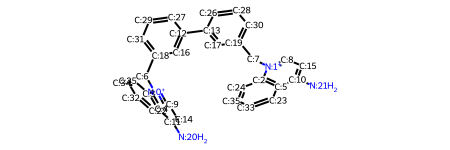

In [92]:
chembl_df3['ROMol'].values[0]

In [91]:
chembl_df3.groupby('acid_base_string').count()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type,ROMol
acid_base_string,,,,,,,,,,,,
A,285930,285930,285930,285930,285930,285930,285930,285930,285930,285930,285930,285930
B,312565,312565,312565,312565,312565,312565,312565,312565,312565,312565,312565,312565


In [94]:
from rdkit.Chem.Descriptors import ExactMolWt, HeavyAtomCount, NumHAcceptors, NumHDonors, MolLogP, NumRotatableBonds

In [93]:
mw = []
for mol in tqdm(chembl_df3['ROMol']):
    mw.append(ExactMolWt(mol))

100%|██████████| 598495/598495 [00:03<00:00, 170257.25it/s]


In [95]:
hac, nhd, nha, logp, nrb = [], [], [], [], []
for mol in tqdm(chembl_df3['ROMol']):
    hac.append(HeavyAtomCount(mol))
    nhd.append(NumHDonors(mol))
    nha.append(NumHAcceptors(mol))
    logp.append(MolLogP(mol))
    nrb.append(NumRotatableBonds(mol))

100%|██████████| 598495/598495 [06:24<00:00, 1555.61it/s]


In [96]:
for i,j in zip(['MolWt', 'HeavyAtomCount', 'NumHDonors', 'NumHAcceptors', 'MolLogP', 'NumRotatableBonds'], [mw, hac, nhd, nha, logp, nrb]):
    chembl_df3[i] = j

/state/partition1/job-37045453/ipykernel_1170763/648308185.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chembl_df3[i] = j
/state/partition1/job-37045453/ipykernel_1170763/648308185.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chembl_df3[i] = j
/state/partition1/job-37045453/ipykernel_1170763/648308185.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: ht

In [97]:
chembl_df3.head()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type,ROMol,acid_base_string,MolWt,HeavyAtomCount,NumHDonors,NumHAcceptors,MolLogP,NumRotatableBonds
0,CHEMBL6354,12.205,20.0,Nc1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5ccccc5...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,468.230300,36,2,2,5.4960,5
1,CHEMBL6354,12.807,21.0,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc(N)c5cc...,[NH-]c1cc[n+](Cc2cccc(-c3cccc(C[n+]4ccc([NH-])...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,467.223023,36,1,1,6.5975,5
2,CHEMBL429017,12.205,16.0,Nc1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccccc54...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,496.261600,38,2,2,5.6142,7
3,CHEMBL429017,12.807,17.0,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc(N)c5ccc...,[NH-]c1cc[n+](Cc2ccc(CCc3ccc(C[n+]4ccc([NH-])c...,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,495.254323,38,1,1,6.7157,7
4,CHEMBL6361,12.205,20.0,Nc1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5cccc...,[NH-]c1cc[n+](Cc2ccc(/C=C\c3ccc(C[n+]4ccc(N)c5...,2.0,1.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,43.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,494.245950,38,2,2,5.9994,6


Filter out drug-like cmpds.

In [125]:
chembl_filter = chembl_df3[(chembl_df3['MolWt'] <= 500) & (chembl_df3['NumHAcceptors'] <= 10) & (chembl_df3['NumHDonors'] <= 5) & (chembl_df3['MolLogP'] <= 5) & (chembl_df3['NumRotatableBonds'] <= 10)]

In [117]:
chembl_filter.shape

(121838, 19)

In [118]:
chembl_filter.head()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type,ROMol,acid_base_string,MolWt,HeavyAtomCount,NumHDonors,NumHAcceptors,MolLogP,NumRotatableBonds
37,CHEMBL6353,9.919,14.0,[O-]c1cc2c(cc1O)C(NO)c1cc(O)c(O)cc1-2,[O-]c1cc2c(cc1O)-c1cc([O-])c(O)cc1C2NO,-1.0,-2.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_2,23.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,260.056446,19,5,6,0.92560,1
40,CHEMBL6353,12.347,17.0,[O-]NC1c2cc([O-])c([O-])cc2-c2cc(O)c([O-])cc21,[O-]NC1c2cc([O-])c([O-])cc2-c2cc([O-])c([O-])cc21,-4.0,-5.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_5,23.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,257.034617,19,2,6,-0.22980,1
75,CHEMBL6534,2.725,8.0,NC(=O)c1cc2c(Sc3ccc(-c4ccccc4)cc3)c[nH+]cc2s1,NC(=O)c1cc2c(Sc3ccc(-c4ccccc4)cc3)cncc2s1,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,9.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,363.062032,25,1,3,4.63250,4
79,CHEMBL266429,2.610,8.0,Cc1ccc(Sc2c[nH+]cc3sc(C(=[NH2+])[S-])cc23)cc1,Cc1ccc(Sc2cncc3sc(C(=[NH2+])[S-])cc23)cc1,1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,11.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,317.023538,20,1,3,2.22762,3
80,CHEMBL6398,6.162,5.0,CNC(=[NH2+])NCCC[C@@H]([NH3+])P(=O)([O-])O,CNC(=[NH2+])NCCC[C@@H]([NH3+])P(=O)([O-])[O-],1.0,0.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,<rdkit.Chem.PropertyMol.PropertyMol object at ...,acid_1,11.0,<rdkit.Chem.PropertyMol.PropertyMol object at ...,A,225.111103,14,5,2,-4.19560,5


In [119]:
chembl_filter.describe()

,pka,center,prot_charge,deprot_charge,acid_base_type,MolWt,HeavyAtomCount,NumHDonors,NumHAcceptors,MolLogP,NumRotatableBonds
count,121838.000000,121838.000000,121838.000000,121838.000000,121838.000000,121838.000000,121838.00000,121838.000000,121838.000000,121838.00000,121838.000000
mean,5.494202,12.564569,1.013370,0.013370,40.730659,426.645654,30.35768,1.816281,4.053834,3.41306,5.703664
std,3.946604,8.946245,1.392631,1.392631,25.846910,50.751119,3.96809,1.284838,2.373384,2.01772,2.126069
min,-1.145000,0.000000,-7.000000,-8.000000,1.000000,147.075625,10.00000,0.000000,0.000000,-8.93960,0.000000
25%,2.144000,5.000000,0.000000,-1.000000,23.000000,395.138054,28.00000,1.000000,2.000000,3.31660,4.000000
50%,4.596000,11.000000,1.000000,0.000000,28.000000,434.211051,31.00000,2.000000,4.000000,4.09110,6.000000
75%,8.714000,19.000000,2.000000,1.000000,65.000000,467.132552,33.00000,3.000000,5.000000,4.58742,7.000000
max,14.000000,37.000000,7.000000,6.000000,140.000000,499.999458,38.00000,5.000000,10.000000,4.99992,10.000000


In [175]:
chembl_filter['SMILES'] = chembl_filter['ROMol'].apply(lambda x: x.GetProp('mol-smiles'))

/state/partition1/job-37045453/ipykernel_1170763/85954719.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  chembl_filter['SMILES'] = chembl_filter['ROMol'].apply(lambda x: x.GetProp('mol-smiles'))


In [176]:
torch.save(chembl_filter, '../data/chembl/chembl_use_filter.pt')

In [110]:
import seaborn as sns

<Axes: xlabel='pka', ylabel='Count'>

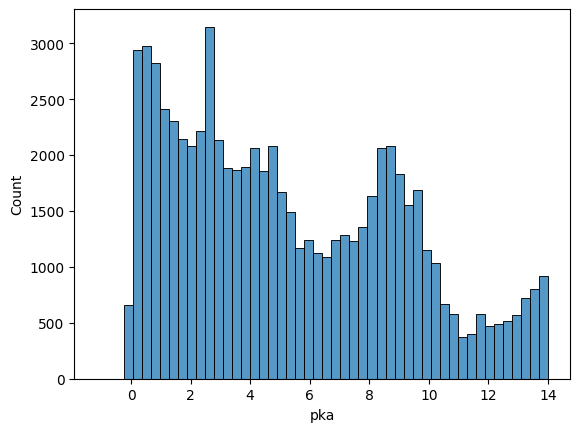

In [121]:
sns.histplot(chembl_filter[chembl_filter['acid_base_string'] == 'A']['pka'])

<Axes: xlabel='pka', ylabel='Count'>

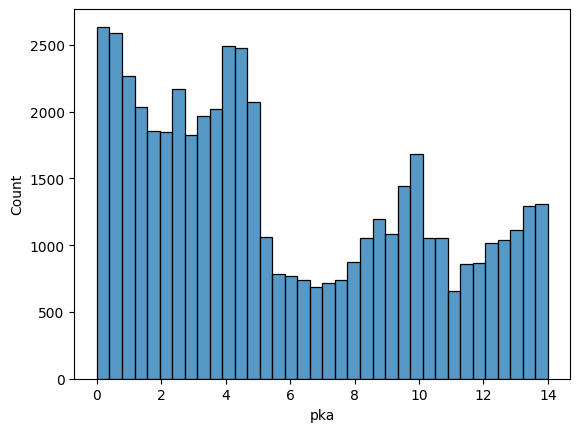

In [122]:
sns.histplot(chembl_filter[chembl_filter['acid_base_string'] == 'B']['pka'])

In [10]:
chembl_filter.groupby('acid_base_string').count()

,chembl_id,pka,center,prot_smiles,deprot_smiles,prot_charge,deprot_charge,prot_mol,deprot_mol,acid_basic,acid_base_type,ROMol,MolWt,HeavyAtomCount,NumHDonors,NumHAcceptors,MolLogP,NumRotatableBonds,SMILES
acid_base_string,,,,,,,,,,,,,,,,,,,
A,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505,70505
B,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333,51333


# End